## Load data

In [1]:
from scripts.halo_analysis_scripts import *
from scripts.analytic_modeling import Simulation, Potential_FIRE, velocity_COM, spherical_velocities, excise_satellites
from astropy import units as un, constants as cons
from joblib import Parallel, delayed
import matplotlib.colors as colors
from pprint import pprint
%matplotlib inline
plt.style.reload_library()
# plt.style.use(['science', 'high-vis'])
import smplotlib
from scipy.interpolate import interp1d

import WiersmaCooling as Cool
import cooling_flow as CF


import matplotlib as mpl
plt.rcParams.update({'font.size': 18})
mpl.rcParams['mathtext.default'] = 'regular'

from datetime import datetime
from scipy.spatial import cKDTree

In [2]:
d = '../data/simcachev2_Khist_outflow/'
sims = np.unique(['_'.join(f.split('_')[1:-1]) for f in os.listdir(d)])
PaperSimNames = {k:v for k,v in PaperSimNames.items() if v in sims and 'NoBH' in k}

In [3]:
PaperSimNames

{'m13h002_NoBH': 'm13h002_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h007_NoBH': 'm13h007_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h029_NoBH': 'm13h029_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h113_NoBH': 'm13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h206_NoBH': 'm13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h223_NoBH': 'm13h223_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h236_NoBH': 'm13h236_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12a_NoBH': 'm12a_r57000',
 'm12d_NoBH': 'm12d_r57000',
 'm12e_NoBH': 'm12e_r57000',
 'm12g_NoBH': 'm12g_r7100',
 'm12j_NoBH': 'm12j_r7100',
 'm12k_NoBH': 'm12k_r57000',
 'm12n_NoBH': 'm12n_r7100',
 'm12u_NoBH': 'm12u_r28000',
 'm12x_NoBH': 'm12x_r3500',
 'm12f_NoBH': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12q_NoB

In [4]:
# Load snapshots from z=0.5 to 0
res = {}
for k,v in sorted(PaperSimNames.items()):
    snaps = sorted([int(f.split('_')[-1].split('.')[0]) for f in os.listdir(d) if v in f])
    print(k, v)
    print(snaps)
    print()
#     Sim = Simulation(v, snaps[-1])
#     print(k, Sim.Redshift)
#     print(f"{Sim.pro['Mvir']/1e12:.2f} {Sim.pro['Rvir']:.0f}\n")
    res[k] = Parallel(n_jobs=-1, verbose=0)(delayed(Simulation)(v, s) for s in snaps)

m12a_NoBH m12a_r57000
[500]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:140: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))


m12d_NoBH m12d_r57000
[500]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:140: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))


m12e_NoBH m12e_r57000
[500]

m12f_NoBH m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[259, 279, 303, 330, 364, 382, 386, 391, 395, 399, 500]



IndexError: index 0 is out of bounds for axis 0 with size 0

In [4]:
res_cf = {}
for k,v in sorted(PaperSimNames.items()):
    if 'm12' not in k or k[3]=='g': continue
    Sim_cut = Simulation(v, 500, datadir='simcachev2_Khist_outflow_rhfmask_Rmaxgas02_merger03')
    print(k,Sim_cut.Rcool)
    res_cf[k] = Simulation(v, 500, datadir='simcachev2_Khist_outflow', Rcool=Sim_cut.Rcool)

m12a_NoBH 163.72767974094708
m12d_NoBH 161.424940567127
m12e_NoBH 47.73206521371558
m12f_NoBH 181.82575531842696
m12j_NoBH 284.3450428558664
m12k_NoBH 190.68755712537293
m12n_NoBH 212.37386523974587
m12q_NoBH 185.90885368462048
m12r_NoBH 180.7777959706512
m12u_NoBH 63.421329796761995
m12w_NoBH 90.35241745557882
m12x_NoBH 75.85889086684553
m12z_NoBH 144.9791841443178


## Define CF plotting code

In [6]:
# Units of Rvir
def colormap(k, ax, sim, Rvir=1):
    d = getattr(sim, f'cmap_{k}')
    im = ax.pcolormesh(d['X']/Rvir, d['Y']/Rvir, d['H'], cmap='Reds', norm=colors.SymLogNorm(linthresh=0.03, vmin=0, vmax=1))
    return im
def makecoolingflow(Sims, fname=None, tsstr='transonic_solution'):
    
    ylabels = [r'$\log \left< n_H / \mathrm{cm}^{-3} \right>$', 
            profilelabels['T lin'],
            r'$ < \mathcal{M} >$',
            r'$\log \left< t_{\mathrm{cool}} / \mathrm{Gyr} \right>$',
            r'$\log < K >$'
            ]

    prolabels = ['nH', 'T', 'MachNumber', 'tcool', 'K']
    
    fig, axes = plt.subplots(len(ylabels), len(Sims), sharex='col', sharey='row', gridspec_kw={'wspace': .05, 'hspace':.25}, figsize=[4.8*len(Sims),4.8*len(ylabels)], dpi=150, facecolor='w', squeeze=False)
    
    for mi,Sim in enumerate(Sims):
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']

        axes[3,mi].axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
        #TODO axes[3,mi].axhline(np.log10(Sim.tHubble * (1+Sim.Redshift)**(-3/2)), c='r')
        axes[3,mi].axvline(np.log10(Sim.Rcool/pro['Rvir']), label=r'$R_{\mathrm{cool}}$', c='k', ls='-.')
        if mi==2: axes[3,mi].legend()

        axes[-1,mi].set_xlabel(r'$\log (r/R_{vir})$')

        # Add FIRE-3 curves
        for ax, ylabel, prolabel in zip(axes[:,mi], ylabels, prolabels):
            ax.set_xlim(np.log10(0.05),np.log10(1.2))
            # ax.axvline(np.log10(0.05*pro['Rvir']))
            ax.axvline(np.log10(Sim.Rcool/pro['Rvir']), c='w', ls='-.')
            ax.plot(np.log10(rmid/pro['Rvir']), pro[prolabel], 'k--', label='FIRE')
            ax.xaxis.set_tick_params(labelbottom=True)
            ax.set_xlabel(r'$\log (r/R_{vir})$')
            if mi==0: ax.set_ylabel(ylabel)
            if prolabel=='nH': ax.set_title(['_'.join(v.split('_')[:2]) for k,v in PaperSimNames.items() if v==Sim.simname][0] + f' z={np.abs(Sim.Redshift[()]):.2f}')#ax.set_title(Sim.simname.split('_')[0])
        for ax in axes[(0,2,3),0].flatten():
            ax.set_xlim(ax.get_xlim())
            ax.set_ylim(ax.get_ylim())
        axes[1,0].set_ylim(5,7.5)#axes[1,0].set_ylim(5,7.5)
        axes[2,mi].set_ylim(-1,1)
        axes[3,0].set_ylim(-1.25,3.25)
        axes[4,0].set_ylim(12,14.75)
        # Add FIRE-3 colormaps
        im = colormap('nH', axes[0,mi], Sim, pro['Rvir'])
        colormap('T', axes[1,mi], Sim, pro['Rvir'])
        colormap('MachNumber', axes[2,mi], Sim, pro['Rvir'])
        colormap('tcool', axes[3,mi], Sim, pro['Rvir'])
        # colormap('Z', axes[4,mi], Sim, pro['Rvir'])
        colormap('K', axes[4,mi], Sim, pro['Rvir'])

        # Add cooling flow Rcirc solution curves
        res = getattr(Sim, tsstr)
        res_x = np.log10(res.Rs().to(un.kpc).value/pro['Rvir'])

        axes[0,mi].plot(res_x, np.log10(res.nHs().to(un.cm**-3).value), label=f'CF $\dot{{M}}={res.Mdot.value:.2f}\ M_\odot/\mathrm{{yr}}$')
        axes[1,mi].plot(res_x, np.log10(res.Ts().to(un.K).value))
        axes[2,mi].plot(res_x, res.Ms())
        axes[3,mi].plot(res_x, np.log10(res.t_cools().to(un.Gyr).value))
        
        axes[4,mi].plot(res_x, np.log10((res.P2ks().to(un.K/un.cm**3) / (res.rhos().to(un.Msun/un.kpc**3)/1e10)**(5/3)).value))

        axes[0,mi].legend(loc=3)

    # Add the colorbar to the figure
    cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.3]) # [left, bottom, width, height]
    cbar = fig.colorbar(im, cax=cbar_ax, orientation='vertical')
    cbar.set_label('radial bin fraction')
    fig.tight_layout()
    if fname: plt.savefig(fname, bbox_inches='tight')
    return fig, axes

In [7]:
def colormap(k, ax, sim):
    d = getattr(sim, f'cmap_{k}')
    im = ax.pcolormesh(d['X'], d['Y'], d['H'], cmap='Reds', norm=colors.SymLogNorm(linthresh=0.03, vmin=0, vmax=1))
    return im
def makecoolingflow(Sims, fname=None, tsstr='transonic_solution'):
    
    ylabels = [r'$\log \left< n_H / \mathrm{cm}^{-3} \right>$', 
            profilelabels['T lin'],
            r'$ < \mathcal{M} >$',
            r'$\log \left< t_{\mathrm{cool}} / \mathrm{Gyr} \right>$',
            r'$\log < K >$'
            ]

    prolabels = ['nH', 'T', 'MachNumber', 'tcool', 'K']#tcoolshell
#     prolabels = ['nH', 'T_Mweighted', 'MachNumber', 'tcool', 'K_Mweighted']
    
    fig, axes = plt.subplots(len(ylabels), len(Sims), sharex='col', sharey='row', gridspec_kw={'wspace': .05, 'hspace':.25}, figsize=[4.8*len(Sims),4.8*len(ylabels)], dpi=150, facecolor='w', squeeze=False)
    
    for mi,Sim in enumerate(Sims):
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']

        axes[3,mi].axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
        #TODO axes[3,mi].axhline(np.log10(Sim.tHubble * (1+Sim.Redshift)**(-3/2)), c='r')
        axes[3,mi].axvline(np.log10(Sim.Rcool), label=r'$R_{\mathrm{cool}}$', c='k', ls='-.')
        if mi==2: axes[3,mi].legend()

        axes[-1,mi].set_xlabel('$\log (r/\mathrm{pkpc})$')

        # Add FIRE-3 curves
        for ax, ylabel, prolabel in zip(axes[:,mi], ylabels, prolabels):
            ax.set_xlim(.4,3); print(np.log10(1.2*pro['Rvir'])) #2.65
            # ax.axvline(np.log10(0.05*pro['Rvir']))
            ax.axvline(np.log10(Sim.Rcool), c='k', ls='-.')
            ax.set_xlim(np.log10(0.05*pro['Rvir']))
            ax.plot(np.log10(rmid), pro[prolabel], 'k--', label='FIRE')
            ax.xaxis.set_tick_params(labelbottom=True)
            ax.set_xlabel('$\log (r/\mathrm{pkpc})$')
            if mi==0: ax.set_ylabel(ylabel)
            if prolabel=='nH': ax.set_title(['_'.join(v.split('_')[:2]) for k,v in PaperSimNames.items() if v==Sim.simname][0] + f' z={np.abs(Sim.Redshift[()]):.2f}')#ax.set_title(Sim.simname.split('_')[0])
        for ax in axes[(0,2,3),0].flatten():
            ax.set_xlim(ax.get_xlim())
            ax.set_ylim(ax.get_ylim())
        axes[1,0].set_ylim(5,7.5)#axes[1,0].set_ylim(5,7.5)
        axes[2,mi].set_ylim(-1,1)
        axes[3,0].set_ylim(-1.25,3.25)
        axes[4,0].set_ylim(12,14.75)
        # Add FIRE-3 colormaps
        im = colormap('nH', axes[0,mi], Sim)
        colormap('T', axes[1,mi], Sim)
        colormap('MachNumber', axes[2,mi], Sim)
        colormap('tcool', axes[3,mi], Sim)
        # colormap('Z', axes[4,mi], Sim)
        colormap('K', axes[4,mi], Sim)

        # Add cooling flow Rcirc solution curves
        res = getattr(Sim, tsstr)
        res_x = np.log10(res.Rs().to(un.kpc).value)

        axes[0,mi].plot(res_x, np.log10(res.nHs().to(un.cm**-3).value), label=f'$\dot{{M}}={res.Mdot.value:.2f}\ M_\odot/\mathrm{{yr}}$')
        axes[1,mi].plot(res_x, np.log10(res.Ts().to(un.K).value))
        axes[2,mi].plot(res_x, res.Ms())
        axes[3,mi].plot(res_x, np.log10(res.t_cools().to(un.Gyr).value))
        
        axes[4,mi].plot(res_x, np.log10((res.P2ks().to(un.K/un.cm**3) / (res.rhos().to(un.Msun/un.kpc**3)/1e10)**(5/3)).value))

        # axes[0,mi].set_xlim(0.4,3)
        axes[0,mi].legend(loc=3)

    # Add the colorbar to the figure
    cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.3]) # [left, bottom, width, height]
    cbar = fig.colorbar(im, cax=cbar_ax, orientation='vertical')
    cbar.set_label('radial bin fraction')
    fig.tight_layout()
    if fname: plt.savefig(fname, bbox_inches='tight')
    return fig, axes

In [8]:
def makecoolingflowratios(Sims, fname=None, labels=None, lss=None, cs=None, lws=None, tsstr='transonic_solution', axes=None, fig=None):
    
    ylabels = [r'$\log \left< n_H / \mathrm{cm}^{-3} \right>$', 
            profilelabels['T lin'],
            r'$\log < K >$'
            ]

    prolabels = ['nH', 'T', 'K']
    
    if axes is None: fig, axes = plt.subplots(len(ylabels), 1, sharex='col', sharey='col', gridspec_kw={'wspace': .05, 'hspace':.1}, figsize=[4.8*1,4.8*len(ylabels)], dpi=150, facecolor='w')
    
    for mi,Sim in enumerate(Sims):
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']

        axes[-1].set_xlabel('$\log (r/\mathrm{pkpc})$')

        # Add FIRE-3 curves
        for ax, ylabel, prolabel in zip(axes, ylabels, prolabels):
            break
            if mi==0: ax.set_ylabel(ylabel)

        # Add cooling flow solution curves
        res = getattr(Sim, tsstr)
        res_x = np.log10(res.Rs().to(un.kpc).value)

        CF_nH = res.nHs().to(un.cm**-3).value
        CF_T = res.Ts().to(un.K).value
        CF_K = (res.P2ks().to(un.K/un.cm**3) / (res.rhos().to(un.Msun/un.kpc**3)/1e10)**(5/3)).value
        
        rmid2 = rmid[rmid<10**res_x.max()]
        c = cs[mi] if cs is not None else None
        ls = lss[mi] if lss is not None else '-'
        lw = lws[mi] if lws is not None else None
        label = labels[mi] if labels is not None else Sim.simname.split('_')[0]
        axes[0].plot(np.log10(rmid2), np.log10(10**pro['nH'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_nH)(rmid2)), c=c, ls=ls, lw=lw, label=label)
        axes[1].plot(np.log10(rmid2), np.log10(10**pro['T'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_T)(rmid2)), c=c, ls=ls, lw=lw)
        axes[2].plot(np.log10(rmid2), np.log10(10**pro['K'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_K)(rmid2)), c=c, ls=ls, lw=lw)

        # axes[0,mi].set_xlim(0.4,3)
        axes[0].legend(bbox_to_anchor=(1.15, 1))
        axes[0].set_xlim(1.5,3)
    axes[0].set_ylabel('$\log( n_{H, sim} / n_{H, CF} )$')
    axes[1].set_ylabel('$\log( T_{sim} / T_{CF} )$')
    axes[2].set_ylabel('$\log( K_{sim} / K_{CF} )$')
    for ax in axes: ax.axhline(0)
#     axes[0].set_yscale('log')
    axes[0].set_ylim(-0.55, 0.55)
#     axes[0].set_ylim(0,2.5)
    fig.tight_layout()
    if fname: plt.savefig(fname, bbox_inches='tight')

In [9]:
def CF_fitting(resdict, res_cf, bins=np.logspace(-2,1,100), tsstr='transonic_solution'):
    for simname, reslist in resdict.items():
        Sim = res_cf[simname]
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']
        plt.figure()
        chi2 = []
        for Rsonic, res in zip(bins, reslist):
            try:
                res_x = np.log10(res.Rs().to(un.kpc).value)
                rmid2 = rmid[rmid<10**res_x.max()]


                CF_nH = res.nHs().to(un.cm**-3).value
                CF_T = res.Ts().to(un.K).value
                CF_K = (res.P2ks().to(un.K/un.cm**3) / (res.rhos().to(un.Msun/un.kpc**3)/1e10)**(5/3)).value
    #             plt.plot(np.log10(rmid2), 10**pro['K'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_K)(rmid2), '-.')
                plt.plot(np.log10(rmid2), 10**pro['T'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_T)(rmid2), '-', label='$T$')
                plt.plot(np.log10(rmid2), 10**pro['nH'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_nH)(rmid2), '--', label='$n_H$')
                if Rsonic==bins[0]: plt.legend()

                idx = (0.1*pro['Rvir']<=rmid)&(rmid<=Sim.Rcool)
                ob = 10**pro['K'][idx]
                ex = interp1d(10**res_x, CF_K)(rmid[idx])

                ob_nH = 10**pro['nH'][idx]
                ob_T = 10**pro['T'][idx]
                ex_nH = interp1d(10**res_x, CF_nH)(rmid[idx])
                ex_T = interp1d(10**res_x, CF_T)(rmid[idx])

                #chi2.append(np.sum((ob - ex)**2 / ex) / (len(ex)-1))
                chi2.append(np.sum(np.abs((ob_T - ex_T)) / ex_T) + np.sum(np.abs((ob_nH - ex_nH)) / ex_nH))
    #             chi2.append(np.sum((ob_T - ex_T)**2 / ex_T) / (len(ex_T)-1))
            except:
                chi2.append(np.nan)

        try:
            setattr(Sim, tsstr, reslist[np.nanargmin(chi2)])
            setattr(Sim, tsstr+'_Rsonic', bins[np.nanargmin(chi2)])
        except:
            pass

        plt.axhline(1)
        plt.axvspan(np.log10(0.1*Sim.pro['Rvir']), np.log10(Sim.Rcool), alpha=0.25, color='gray')
        plt.ylim(0,2)
        plt.xlim(1.3,2.5)
        plt.title(f'{simname} z={Sim.Redshift[()]:.3f}')
        plt.xlabel('$\log (r/\mathrm{pkpc})$')
        plt.ylabel('sim/CF')

        plt.figure()
        plt.plot(bins, chi2, '.')
        plt.yscale('log')

In [10]:
def CF_explore(res_cf, simnames, R_min=1, R_max=1.5, bins=np.logspace(-2,1,100), usealpha=False, resdict=None):
    if resdict is None: resdict = {}
    for simname in simnames:
        Sim = res_cf[simname]
        print(simname, Sim.alpha_avg)
        print("Current Time =", datetime.now().strftime("%H:%M:%S"))
        cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)
        alpha = Sim.alpha_avg if usealpha else 0.

        def solution(R_sonic, R_min=R_min, R_max=R_max):
            with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
                try:
                    return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc, alpha=alpha)
                except:
                    return -1

        reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
#         reslist = []
#         for Rsonic in tqdm(bins):
#             sol = CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=Rsonic*un.kpc, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc, alpha=alpha)
#             reslist.append(sol)
        resdict[simname] = reslist
    return resdict

In [20]:
def makevc(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], fname=None, onlyNoBH=False):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey=True, gridspec_kw={'wspace': .0, 'hspace':.04}, figsize=[4.8*len(sims),4.8*1], dpi=150, facecolor='w')
    axes = np.atleast_1d(axes).ravel()
    R_min = 10**-1*un.kpc
    R_max = 10**3*un.kpc
    xarr = np.logspace(np.log10(R_min.to(un.kpc).value), np.log10(R_max.to(un.kpc).value), 100) * un.kpc
    for i,sim in enumerate(sims):
            zs = []
            for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
                Sim = res_cf[model]
                zs.append(Sim.Redshift[()])
                axes[i].plot(np.log10(xarr.value/Sim.pro['Rvir']), np.log10(Sim.potential.vc(xarr).value), ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
                # axes[i].axvline(np.log10(Sim.potential.get_Rcirc().value), label='$R_{circ}$', c='k')
                if onlyNoBH: break
            axes[i].set_title(f'{sim}, $z={[abs(round(z,2)) for z in zs]}$')
    axes[-1].legend(loc=4)
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')#ax.set_xlabel(r'$\log (r/\mathrm{pkpc})$')
    axes[0].set_ylabel(r'$\log \left[ v_c/(\mathrm{km/s}) \right]$')
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))
    if fname: plt.savefig(fname)

def makeZprofile(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], 
                 fname=None,
                 prolabels = ['Z_Mweighted'],
                 ylabels = [profilelabels['Z lin']],
                 onlyNoBH=False):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
    axes = np.atleast_1d(axes).ravel()
    for i,sim in enumerate(sims):
        axes[i].set_title(sim)
        for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
            Sim = res_cf[model]
            for j, (ylabel, prolabel) in enumerate(zip(ylabels, prolabels)):
                axes[i].plot(np.log10(Sim.pro['rmid']), Sim.pro[prolabel], ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
                axes[0].set_ylabel(ylabel)
#             axes[i].axhline(np.log10(Sim.Z2Zsun), c=COLOR_SCHEME[mi-1], ls=ls, lw=1)
            axes[i].plot((np.log10(0.1), np.log10(Sim.Rcool/Sim.pro['Rvir'])), (np.log10(Sim.Z2Zsun), np.log10(Sim.Z2Zsun)), '-', c=COLOR_SCHEME[mi-1], lw=5, alpha=0.6)
            if onlyNoBH: break
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
    axes[-1].legend()
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))

    if fname: plt.savefig(fname)

def makeMdotprofile(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], 
                 fname=None, onlyNoBH=False):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
    axes = np.atleast_1d(axes).ravel()
    for i,sim in enumerate(sims):
        axes[i].set_title(sim)
        for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
            Sim = res_cf[model]
            axes[i].plot(np.log10(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir']), Sim.Mdot_profile['Mdot'], ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
            axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
            axes[i].plot((np.log10(0.1), np.log10(Sim.Rcool/Sim.pro['Rvir'])), (Sim.Mdot_avg.value, Sim.Mdot_avg.value), '-', c=COLOR_SCHEME[mi-1], lw=5, alpha=0.6)#, ls=ls, lw=2)
            print(Sim.Mdot_avg.value, np.log10(0.1), np.log10(Sim.Rcool))
            if onlyNoBH: break
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
    axes[-1].legend(loc=4)
    axes[0].set_yscale('symlog')
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))

    if fname: plt.savefig(fname)

## CF Mdot search

In [11]:
res_cf = {k : v[-1] for k,v in res.items()}# if 'fire2' not in k}

8.496126077222295 -1.0 2.214122107283354
7.347261634146101 -1.0 2.2079706351808754
0.14532880181408375 -1.0 1.6788102253052155
7.313277294271434 -1.0 2.259655400340508
5.396923161169058 -1.0 2.4538456613586836
14.884087258850078 -1.0 2.2803223550906084
6.178663879220119 -1.0 2.3271010713524016
3.765582141112609 -1.0 2.26930007301458
3.603289730320069 -1.0 2.2571450872034817
0.03412074946886124 -1.0 1.8022353439247674
0.3549283623911841 -1.0 1.9559397769696976
0.29422890440170446 -1.0 1.8800064885917906
1.5134942167189696 -1.0 2.1613056514748603
127.74039779667643 -1.0 2.3446038246451026
648.8011023800059 -1.0 2.233492425422195
45.13105238535329 -1.0 2.08542907544
42.45510867915561 -1.0 2.0926130213654197
17.05585830971946 -1.0 2.0918971938261675
326.2310662398955 -1.0 2.3550227109218476
17.72210027151395 -1.0 2.2936734995329404


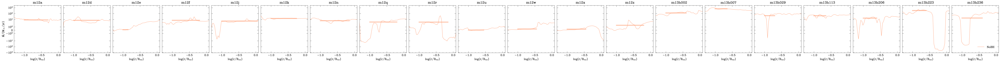

In [8]:
makeMdotprofile(res_cf, [k.split('_')[0] for k in res_cf.keys()], onlyNoBH=True)

In [36]:
Sim = res_cf['m12e_NoBH']
Rlow, Rhigh = 0.0175,.02
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc, tol=1e-2)
print('done', Sim.R_sonic_mid)

0.14532880181408375 solMass / yr
0.0175 kpc
0.01898358649819216 solMass / yr
0.018750000000000003 kpc
5.3092617319353 solMass / yr
0.02 kpc
7.866192336229925 solMass / yr
0.018125000000000002 kpc 0.1236944695644725 0.021634332249611258 solMass / yr
0.018437500000000002 kpc 0.12231527880798593 0.023013523006097828 solMass / yr
0.018593750000000003 kpc 0.12159727690933082 0.023731524904752926 solMass / yr
0.018671875000000004 kpc 5.012439038281851 5.157767840095935 solMass / yr


AttributeError: 'NoneType' object has no attribute 'Mdot'

In [13]:
# new bounds FINAL CUT (tol=1e-2 rhfmask_Rmaxgas02_merger03)
bounds = {
    'm12f_NoBH': 0.9593749999999999,
    'm12q_NoBH': 0.29656250000000006,
    'm12r_NoBH': 1.659375,
    'm12w_NoBH': 0.525,
    'm12z_NoBH': 2.0,
    'm12a_NoBH': ,
    'm12d_NoBH': ,
    'm12k_NoBH': ,
    'm12g_NoBH': ,
    'm12j_NoBH': 0.875,
    'm12n_NoBH': 0.452032470703125,
    'm12x_NoBH': 0.62109375,
    'm12e_NoBH': ,
    'm12u_NoBH': ,
    'm13h002_NoBH': ,
    'm13h007_NoBH': ,
    'm13h223_NoBH': ,
    'm13h113_NoBH': ,
    'm13h206_NoBH':,
    'm13h029_NoBH':
}

SyntaxError: invalid syntax (2762947222.py, line 4)

In [11]:
for k, Sim in res_cf.items():
    if not Sim.Rcool_found:
        print(f'{k}, {Sim.Redshift[()]:.02f}')
        print(Sim.Mdot_avg)
        print(Sim.Rcool_found)
        print()

m12e_NoBH, 0.00
1.367153362437745 solMass / yr
False

m12u_NoBH, 0.00
0.143575717339051 solMass / yr
False

Rcool not defined, set to 0.5*Rvir m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
Rcool not defined, set to 0.5*Rvir m12u_r28000
Rcool not defined, set to 0.5*Rvir m12b_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
Rcool not defined, set to 0.5*Rvir m12e_r57000
Rcool not defined, set to 0.5*Rvir m12i_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5


In [4]:
bounds = {'m12f_NoBH': 0.66875,
'm12q_NoBH': 0.29500000000000004,
'm12r_NoBH': 1.5625,
'm12w_NoBH': 0.4,
'm12z_NoBH': 2.09375,
'm12a_NoBH': 0.49375,
'm12d_NoBH': 1.71875,
'm12k_NoBH': 0.21640625000000002,
# 'm12g_NoBH': 0.14296875000000003, RHF timeout
'm12j_NoBH': 0.875,
'm12n_NoBH': 0.45625000000000004,
'm12x_NoBH': 0.32499999999999996,
'm13h002_NoBH': 0.03486328125,
'm13h007_NoBH': 0.174365234375,
'm13h223_NoBH': 0.034648437500000004,
'm13h113_NoBH': 0.0303125,
'm13h206_NoBH':0.05484375,#}
'm13h029_NoBH': 0.0275,
# 'm12b_NoBH': 0.49375, BUG
# 'm12c_NoBH': 0.325, BUG
# 'm12m_NoBH': 0.6, BUG
'm12e_NoBH': 0.321875,
'm12u_NoBH': 0.38749999999999996,}
# 'm12i_NoBH': 2.6 BUG} #m12i no result reached maximum R;  Rlow, Rhigh = 2.55, 2.6

'''
'm13h217_NoBH': 0.06568359375 (z=2.5)


    
'm12e_NoBH': Mdot Nan
'm12u_NoBH': Mdot Nan

'm13h113_NoBH':(0.0303125, 0.0303125), 'm13h206_NoBH':(0.05484375, 0.05484375)
'''

"\n'm13h217_NoBH': 0.06568359375 (z=2.5)\n\n\n    \n'm12e_NoBH': Mdot Nan\n'm12u_NoBH': Mdot Nan\n\n'm13h113_NoBH':(0.0303125, 0.0303125), 'm13h206_NoBH':(0.05484375, 0.05484375)\n"

In [15]:
def procsim(k):
    Sim = res_cf[k]
    Rlow, Rhigh = bounds[k], bounds[k]
    with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
        transonic_solution, R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)
    return transonic_solution, R_sonic_mid
'''
for k in sorted(bounds.keys()):
#     if 'm12' not in k: continue
    print(k)
    try:
        Sim = res_cf[k]
        Rlow, Rhigh = bounds[k], bounds[k]
        Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)
    except:
        pass
    print()
'''
ts = Parallel(n_jobs=-1)(delayed(procsim)(k) for k in sorted(bounds.keys()))
for k, (transonic_solution, R_sonic_mid) in zip(sorted(bounds.keys()), ts):
    Sim = res_cf[k]
    Sim.transonic_solution, Sim.R_sonic_mid = transonic_solution, R_sonic_mid

## CF fitting

In [13]:
simnames = sorted(bounds.keys())#sorted(['m13h007_NoBH', 'm13h002_NoBH', 'm13h223_NoBH', 'm13h113_NoBH', 'm13h206_NoBH'] + [f'm12{s}_NoBH' for s in 'fqrwzadkgjnx'])

In [14]:
simnames = sorted(res_cf.keys())

In [15]:
resdict = CF_explore(res_cf, simnames)

m12a_NoBH 0.26360855599139216
Current Time = 14:28:29
m12d_NoBH 0.6459312959502368
Current Time = 14:29:48
m12e_NoBH 0.09690378970643501
Current Time = 14:30:16
m12f_NoBH 0.40821344694996964
Current Time = 14:30:49
m12j_NoBH 0.6118282467716758
Current Time = 14:31:19
m12k_NoBH 0.1566671249068046
Current Time = 14:31:52
m12n_NoBH 0.2797706980076969
Current Time = 14:32:28
m12q_NoBH 0.31156370363688574
Current Time = 14:32:59
m12r_NoBH 1.2838727058168702
Current Time = 14:33:31
m12u_NoBH 0.23668532028441408
Current Time = 14:34:02
m12w_NoBH 0.10860768415800164
Current Time = 14:34:29
m12x_NoBH 0.27709981309146786
Current Time = 14:35:03
m12z_NoBH 0.27706698160495746
Current Time = 14:35:33


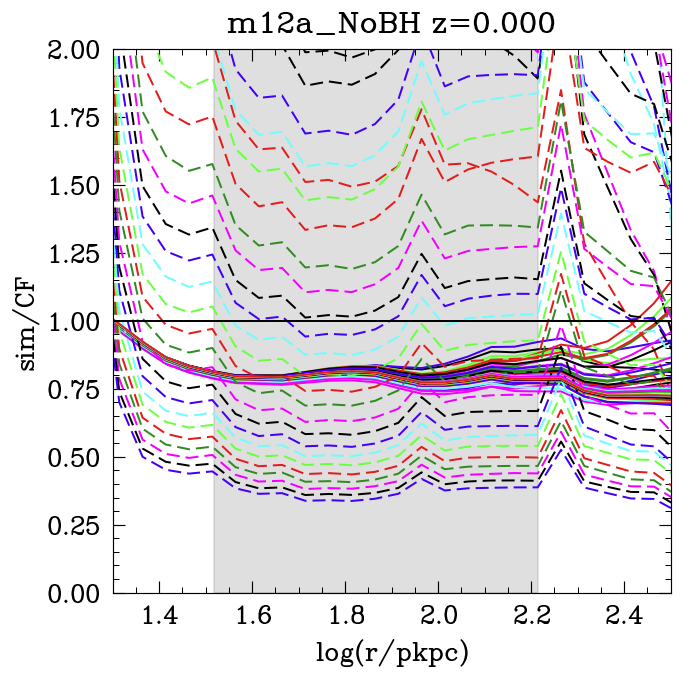

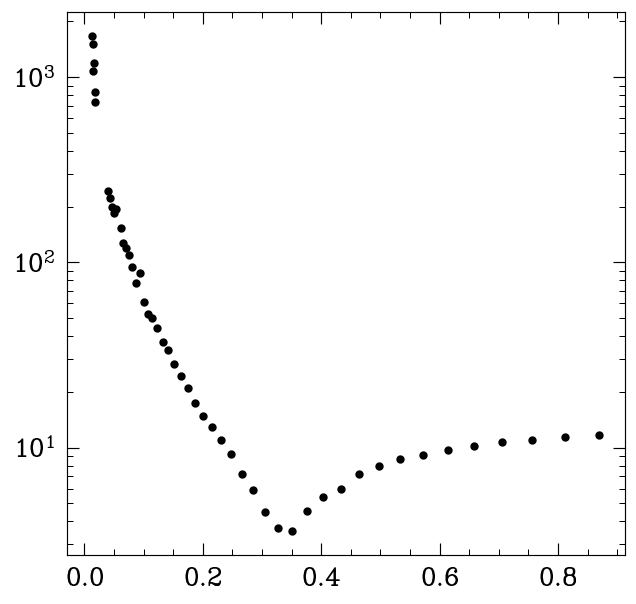

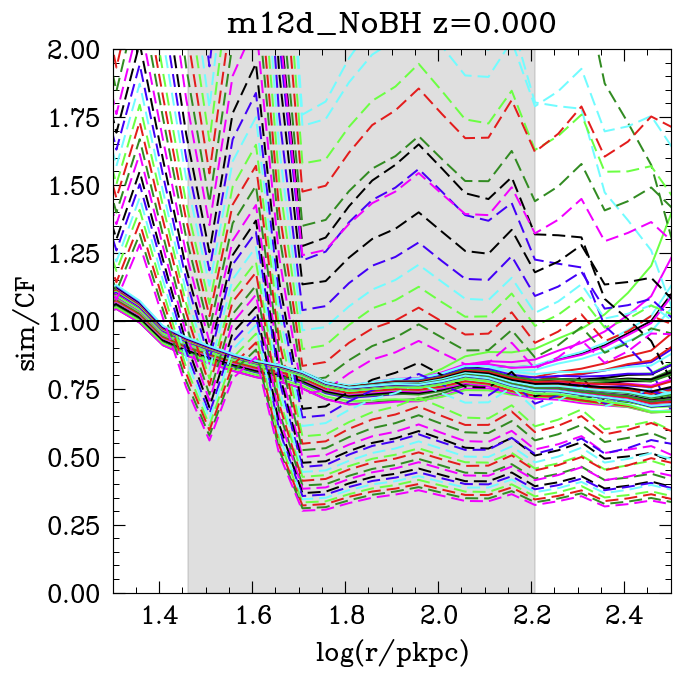

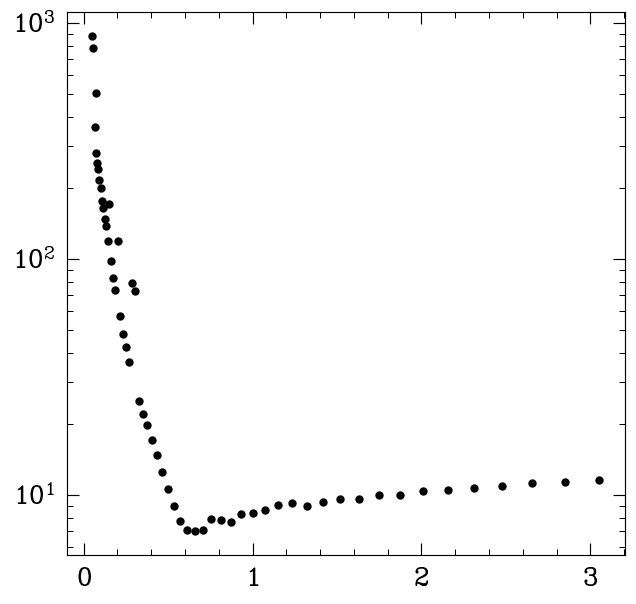

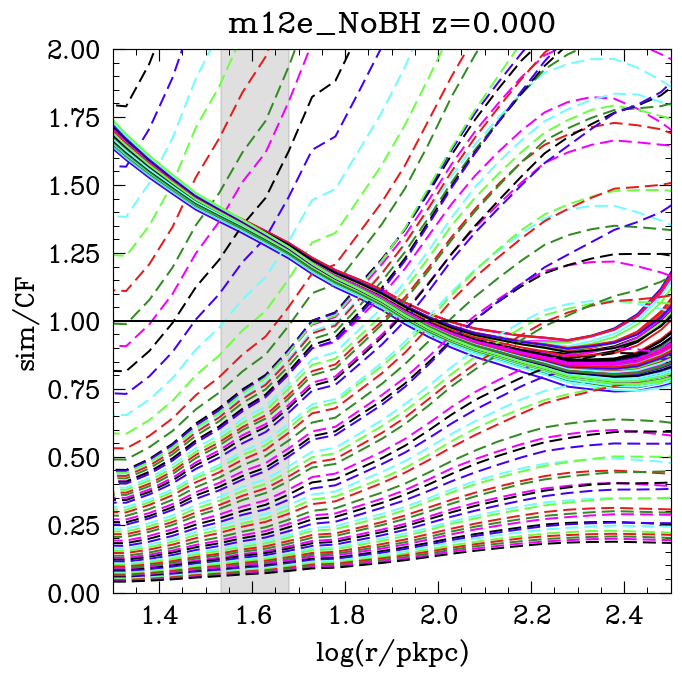

...

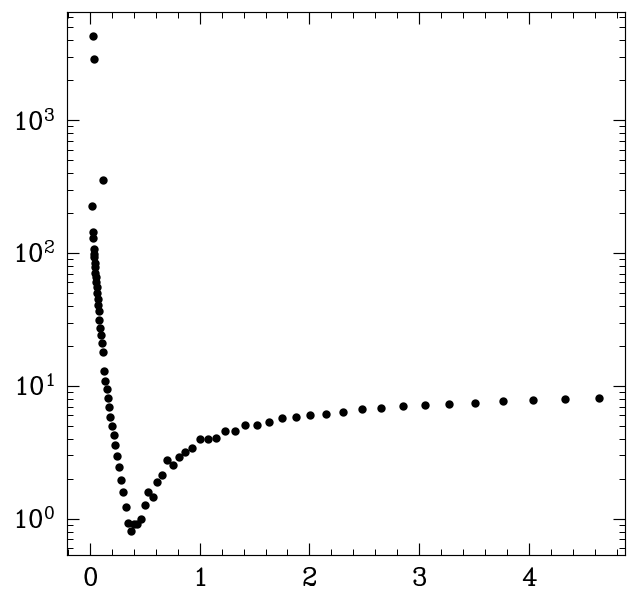

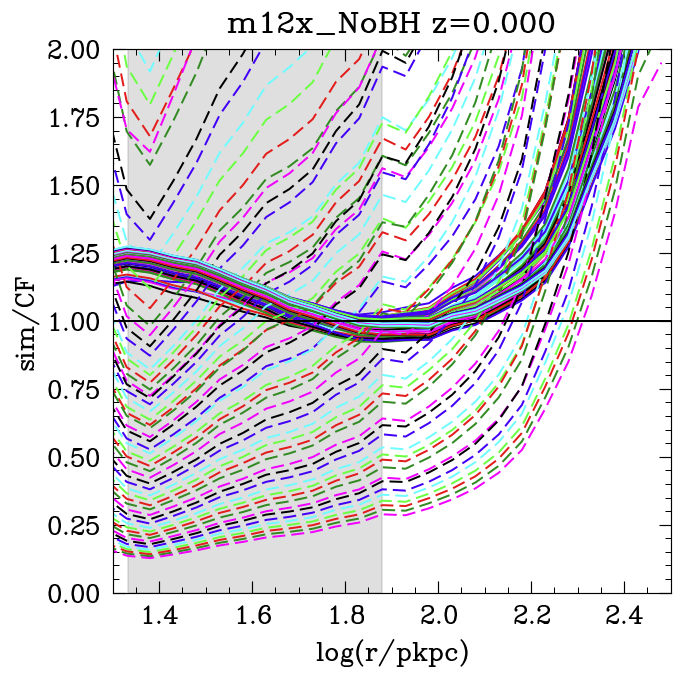

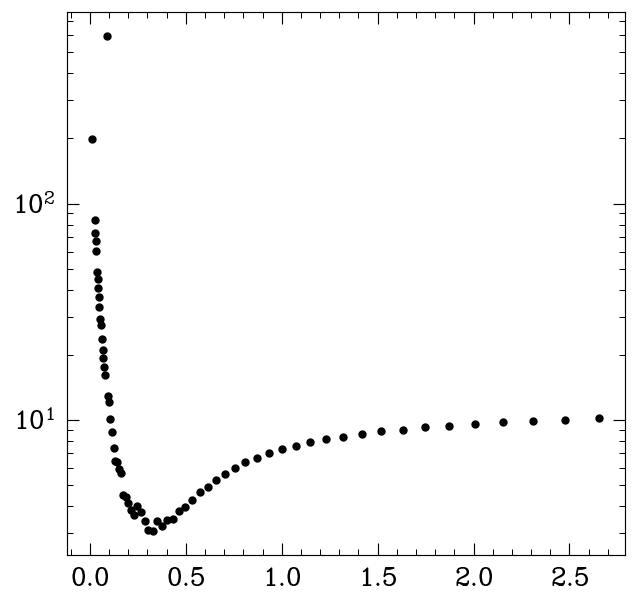

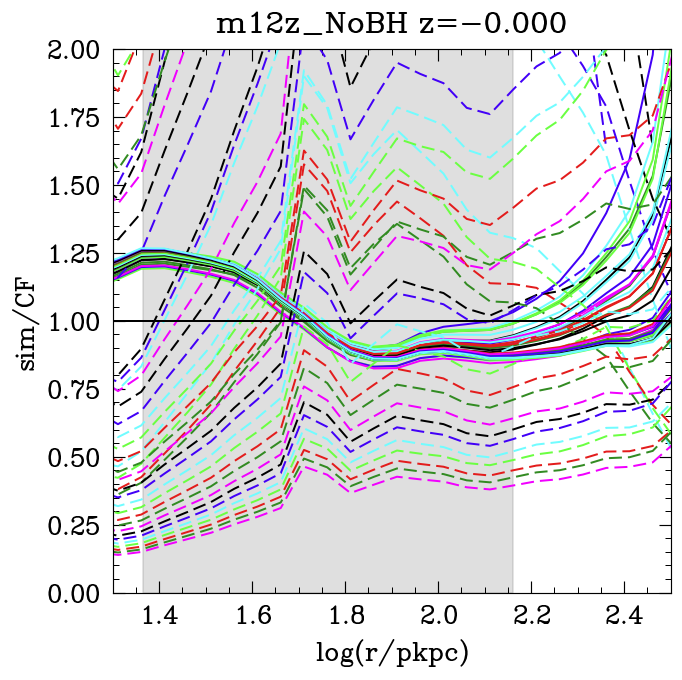

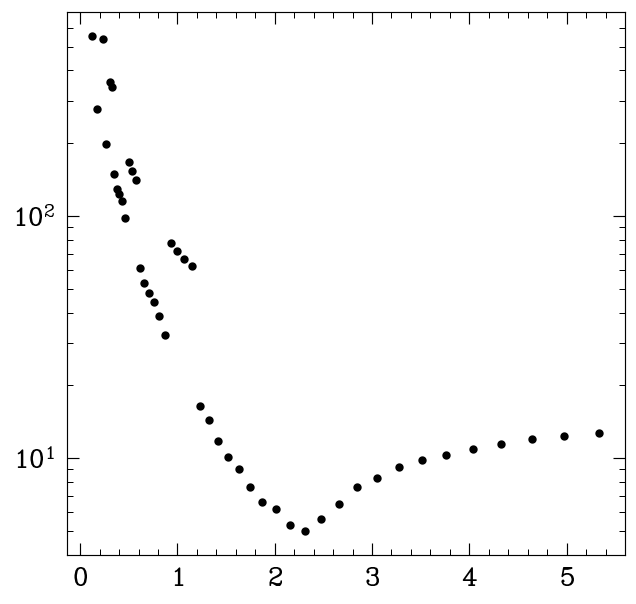

In [16]:
CF_fitting(resdict, res_cf, tsstr='transonic_solution_fitting')

In [17]:
for k,Sim in res_cf.items():
    try:
        print(k,Sim.transonic_solution_fitting.R_sonic(), Sim.transonic_solution_fitting_Rsonic)
    except:
        pass

m12a_NoBH [0.35076805] kpc 0.3511191734215131
m12d_NoBH [0.65727529] kpc 0.6579332246575682
m12e_NoBH None 0.04328761281083057
m12f_NoBH [1.14860724] kpc 1.1497569953977356
m12j_NoBH [0.70477475] kpc 0.7054802310718645
m12k_NoBH [0.16281211] kpc 0.16297508346206444
m12n_NoBH [0.43244325] kpc 0.43287612810830595
m12q_NoBH None 0.43287612810830595
m12r_NoBH [2.6534317] kpc 2.656087782946687
m12u_NoBH None 0.43287612810830595
m12w_NoBH [0.37611709] kpc 0.37649358067924676
m12x_NoBH [0.32712746] kpc 0.32745491628777285
m12z_NoBH [2.30781957] kpc 2.31012970008316


2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.486434327358767
2.486434327358767
2.486434327358767
2.486434327358767
2.486434327358767
2.559689737352484
2.559689737352484
2.559689737352484
2.559689737

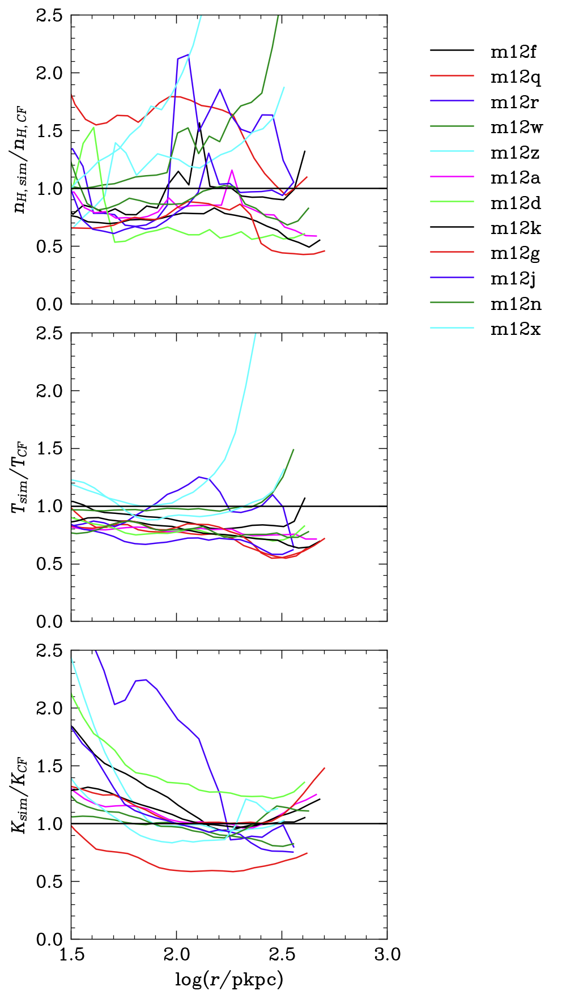

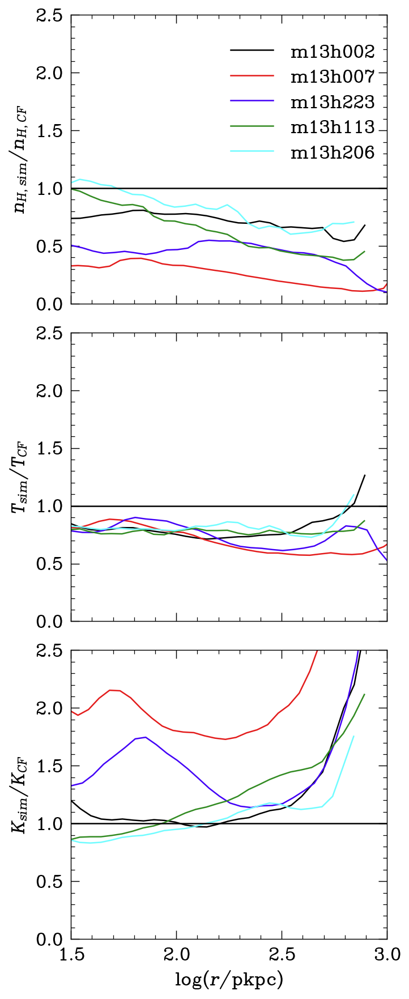

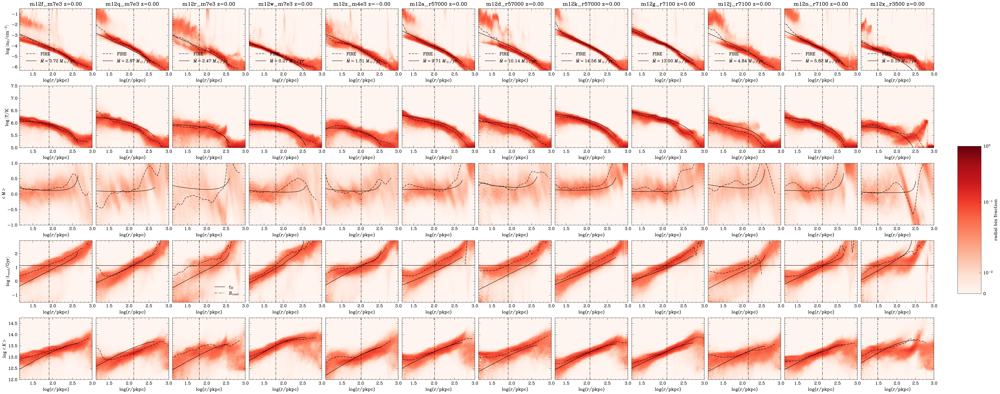

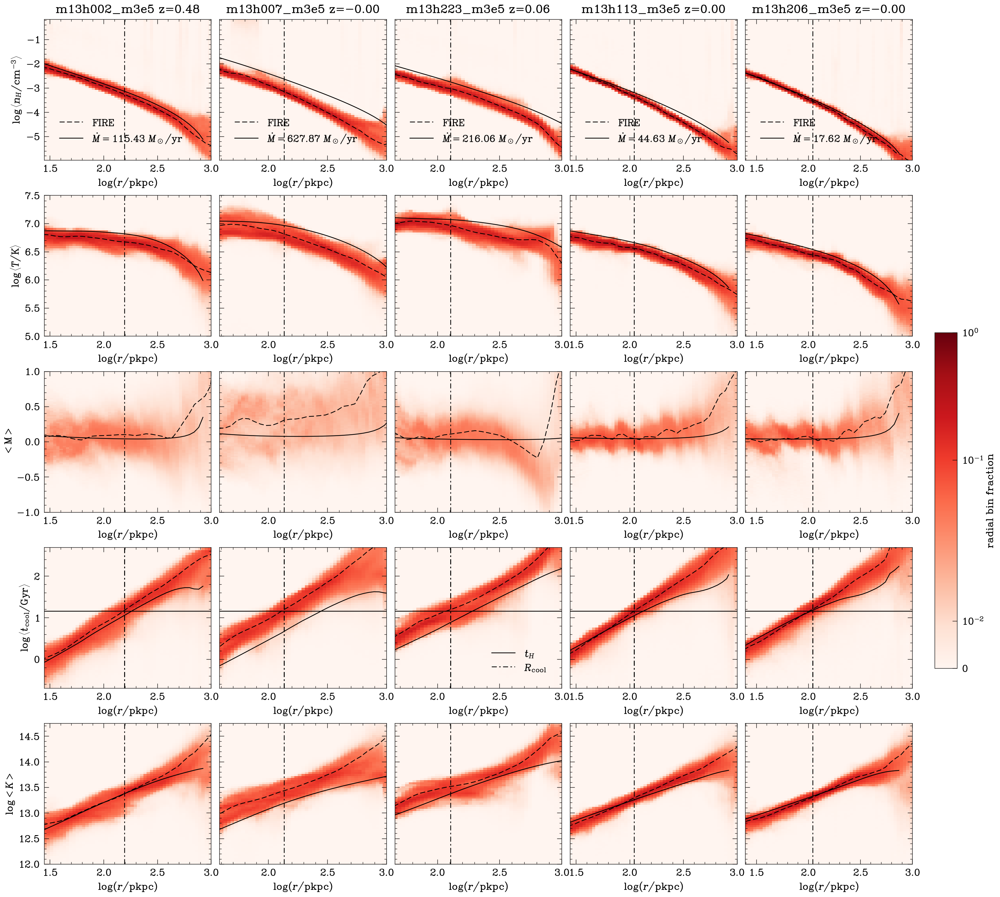

In [24]:
### Mdot from sim ###
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFratios_sim_m12.png')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFratios_sim_m13.png')

makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFprofiles_sim_m12.png')

makecoolingflow([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFprofiles_sim_m13.png')

2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.559689737352484
2.559689737352484
2.559689737352484
2.559689737352484
2.559689737352484
2.4125951545918722
2.4125951545918722
2.4125951545918722
2.412595

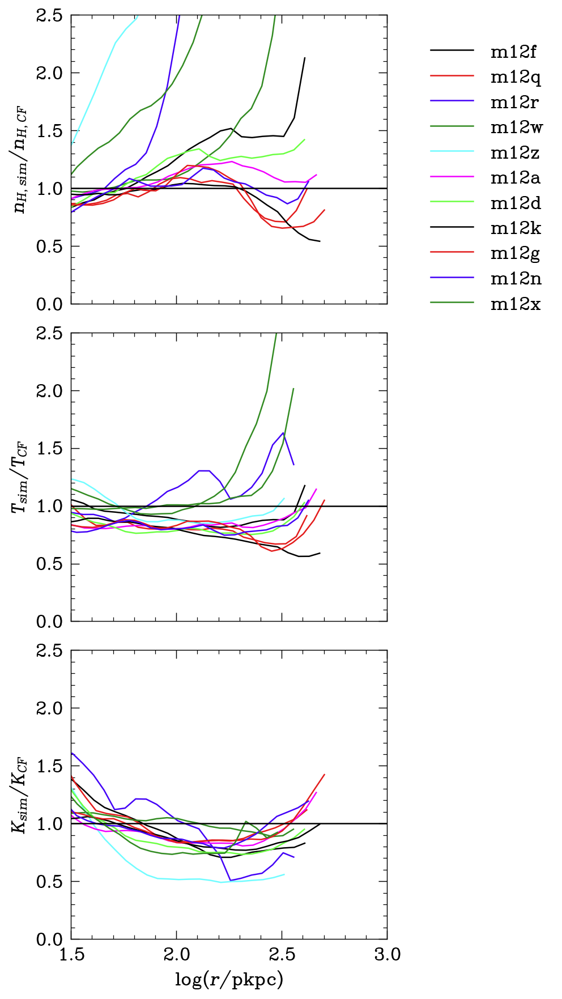

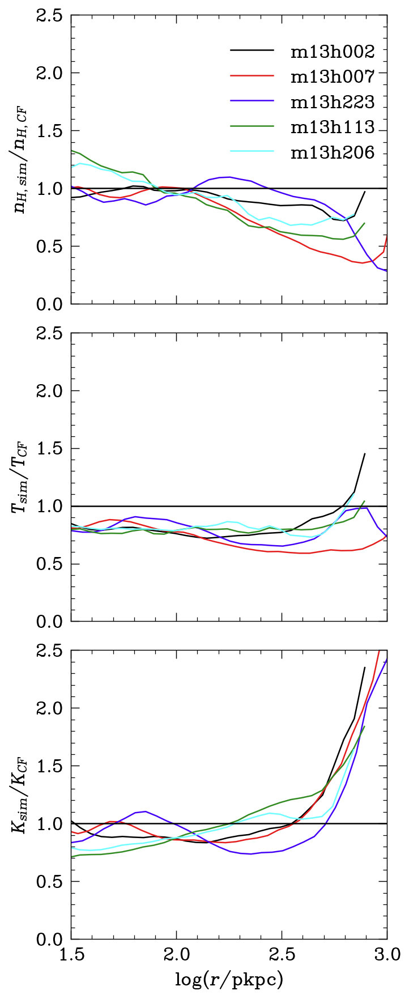

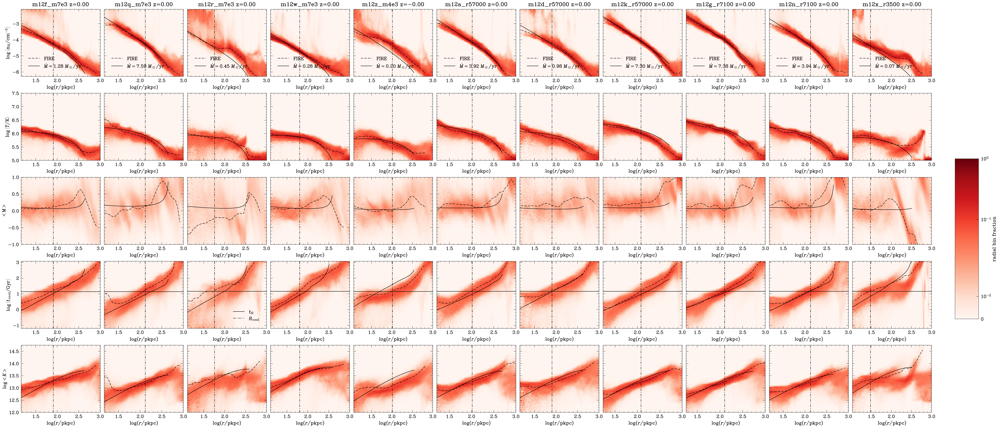

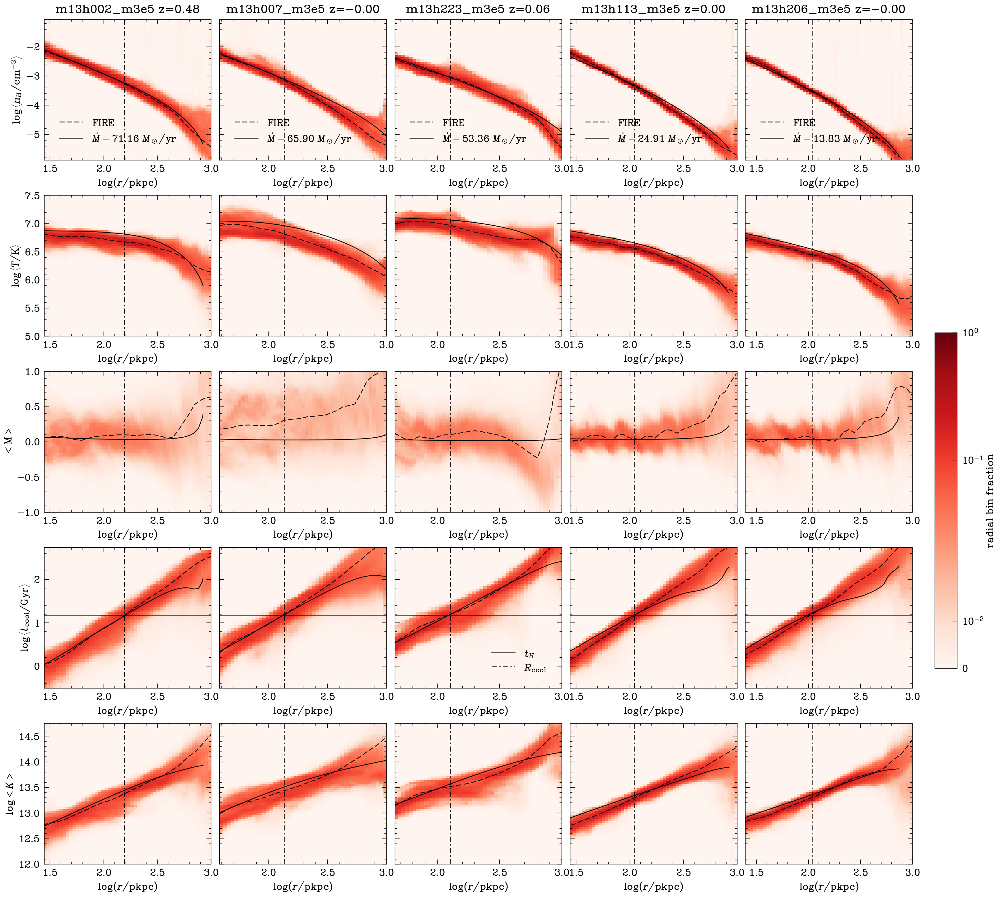

In [19]:
### Fitting ###
# makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFratios_fitTnHTcut_m12.png')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFratios_fitTnHTcut_m13.png')

# makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFprofiles_fitTnHTcut_m12.png')

makecoolingflow([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFprofiles_fitTnHTcut_m13.png')

In [17]:
m12sims = [res_cf[k] for k in sorted(bounds.keys()) if 'm12' in k]
m13sims = [res_cf[k] for k in sorted(bounds.keys()) if 'm13' in k]

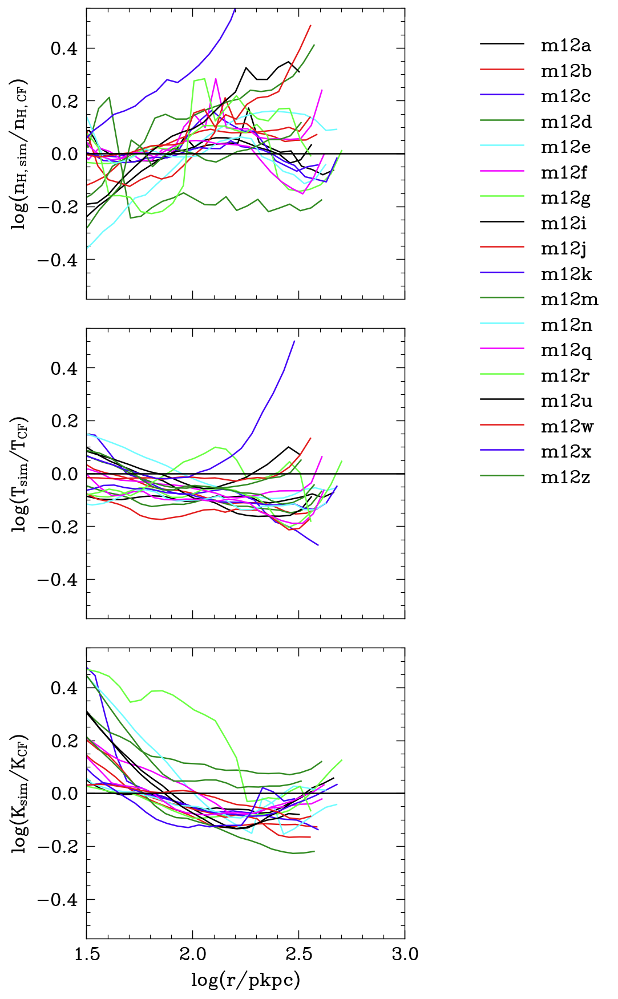

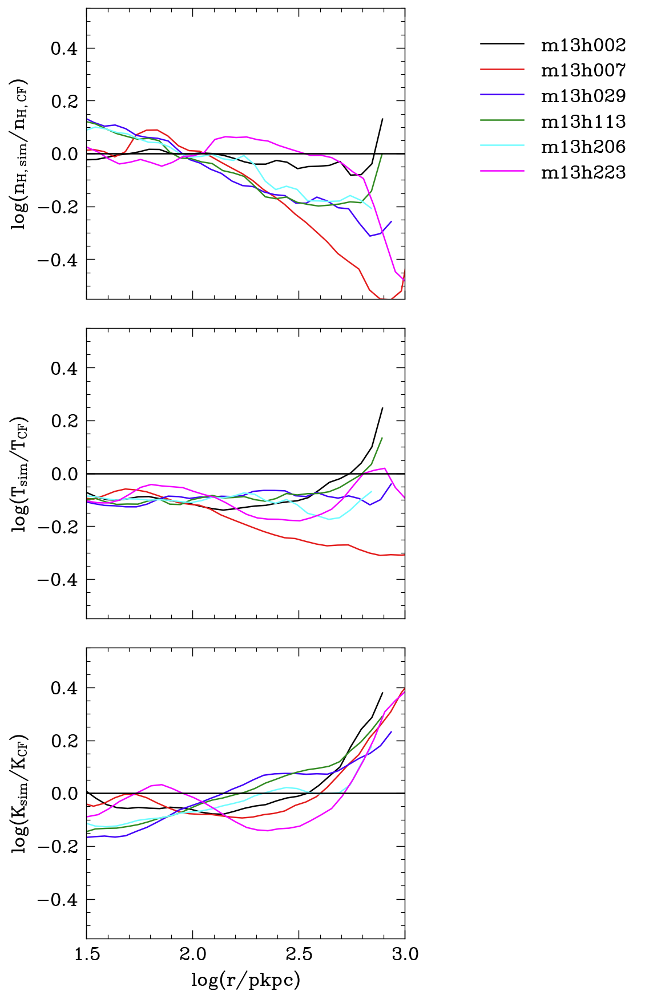

In [42]:
### Paper: Fitting ###
makecoolingflowratios(m12sims, tsstr='transonic_solution_fitting')
# makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../Paper2Figs/CFratios_fitTnH_m12_log.pdf')

makecoolingflowratios(m13sims, tsstr='transonic_solution_fitting')
# makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../Paper2Figs/CFratios_fitTnH_m13_log.pdf')

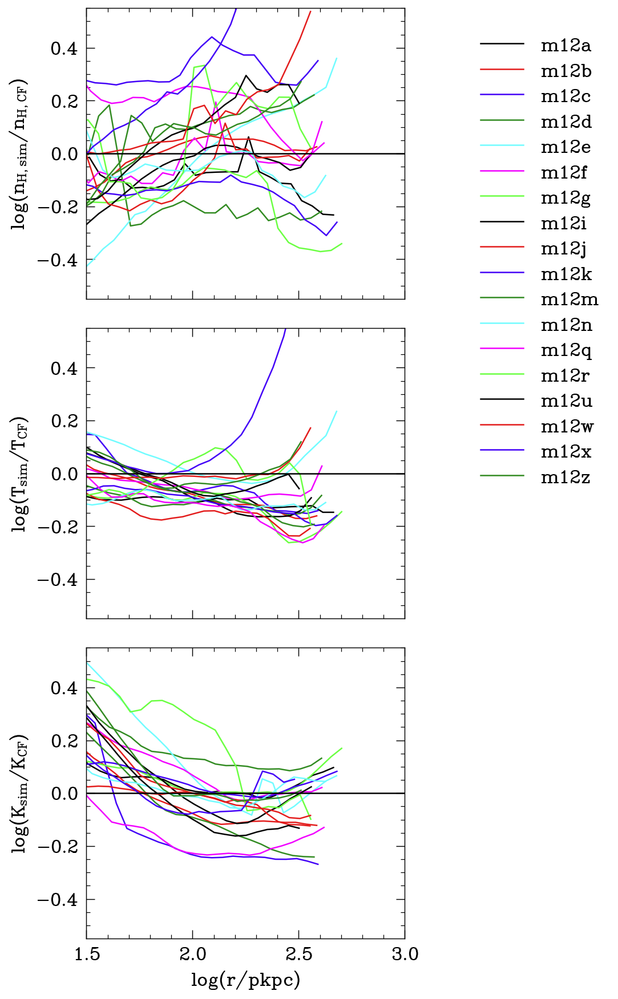

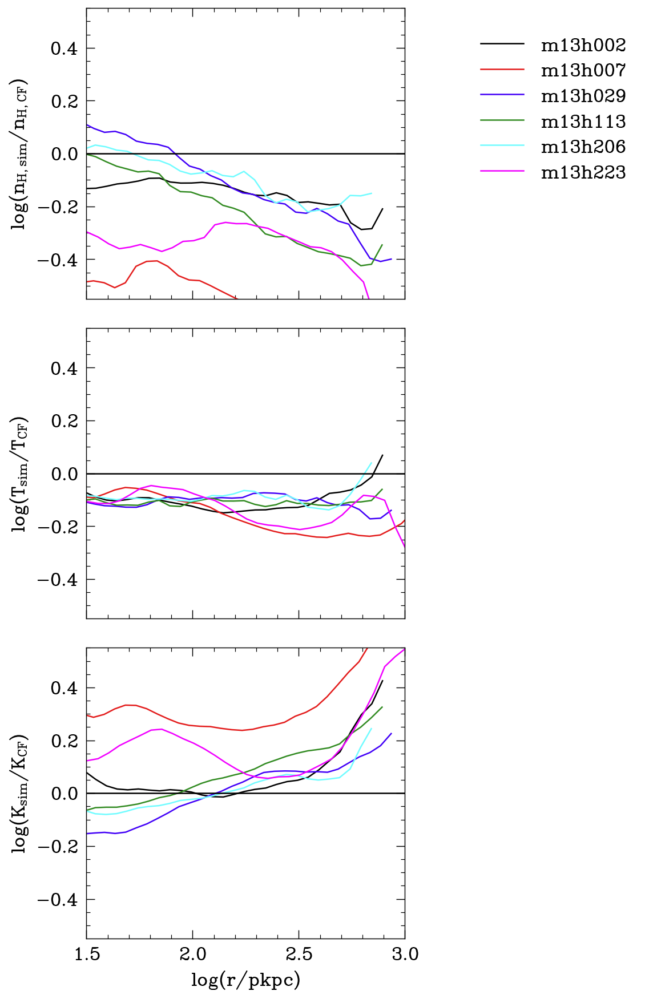

In [43]:
### Paper: Mdot from sim ###
makecoolingflowratios(m12sims)
# makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../Paper2Figs/CFratios_sim_m12_log.pdf')

makecoolingflowratios(m13sims)
# makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../Paper2Figs/CFratios_sim_m13_log.pdf')

# makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
# plt.savefig('../CFprofiles_sim_m12_m13.pdf')

### tcool discrepancy

In [76]:
plt.rcParams.update({'font.size': 18})
def colormap(k, ax, sim):
    d = getattr(sim, f'cmap_{k}')
    im = ax.pcolormesh(d['X'], d['Y'], d['H'], cmap='Reds', norm=colors.SymLogNorm(linthresh=0.03, vmin=0, vmax=1))
    return im
def makecoolingflow(Sims, fname=None):
    
    ylabels = [r'$\log \left< t_{\mathrm{cool}} / \mathrm{Gyr} \right>$',
               r'$P$',
               r'$\Lambda$'
            ]

    prolabels = ['tcoolshell', 'P_th', 'Lambda']
    
    fig, axes = plt.subplots(len(ylabels), len(Sims), sharex='col', sharey='row', gridspec_kw={'wspace': .05, 'hspace':.25}, figsize=[4.8*len(Sims),4.8*len(ylabels)], dpi=150, facecolor='w')
    
    for mi,Sim in enumerate(Sims):
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']
        
        pro['Lambda'] = ((5/3-1) * (10**pro['tcool'])*un.Gyr * ((10**pro['nH'])*un.cm**-3 )**2 / ((10**pro['Pth_Mweighted'])*cons.k_B*un.K/un.cm**3))**(-1)
        pro['Lambda'] = np.log10(pro['Lambda'].to(un.cm**3*un.erg/un.s).value)
        

        axes[0,mi].axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
        #TODO axes[3,mi].axhline(np.log10(Sim.tHubble * (1+Sim.Redshift)**(-3/2)), c='r')
        axes[0,mi].axvline(np.log10(Sim.Rcool), label=r'$R_{\mathrm{cool}}$', c='k', ls='-.')
        if mi==2: axes[0,mi].legend()

        axes[-1,mi].set_xlabel('$\log (r/\mathrm{pkpc})$')

        # Add FIRE-3 curves
        for ax, ylabel, prolabel in zip(axes[:,mi], ylabels, prolabels):
            ax.set_xlim(.4,3); print(np.log10(1.2*pro['Rvir'])) #2.65
            # ax.axvline(np.log10(0.05*pro['Rvir']))
            ax.axvline(np.log10(Sim.Rcool), c='k', ls='-.')
            ax.set_xlim(np.log10(0.05*pro['Rvir']))
            ax.plot(np.log10(rmid), pro[prolabel], 'k--', label='FIRE')
            ax.xaxis.set_tick_params(labelbottom=True)
            ax.set_xlabel('$\log (r/\mathrm{pkpc})$')
            if mi==0: ax.set_ylabel(ylabel)
            if prolabel=='nH': ax.set_title(['_'.join(v.split('_')[:2]) for k,v in PaperSimNames.items() if v==Sim.simname][0] + f' z={np.abs(Sim.Redshift[()]):.2f}')#ax.set_title(Sim.simname.split('_')[0])
        for ax in axes[[0,1]].flatten():
            ax.set_xlim(ax.get_xlim())
            ax.set_ylim(ax.get_ylim())
        axes[0,0].set_ylim(-1.25,3.25)
        axes[2,0].set_ylim(-24,-22)
        # Add FIRE-3 colormaps
        im = colormap('tcool', axes[0,mi], Sim)

        # Add cooling flow Rcirc solution curves
        res = Sim.transonic_solution#stalled_solution#
        res_x = np.log10(res.Rs().to(un.kpc).value)

#         axes[0,mi].plot(res_x, np.log10(res.nHs().to(un.cm**-3).value), label=f'$\dot{{M}}={res.Mdot.value:.2f}\ M_\odot/\mathrm{{yr}}$')
#         axes[1,mi].plot(res_x, np.log10(res.Ts().to(un.K).value))
#         axes[2,mi].plot(res_x, res.Ms())
        axes[0,mi].plot(res_x, np.log10(res.t_cools().to(un.Gyr).value))
    
        axes[1,mi].plot(res_x, np.log10((res.P2ks().to(un.K/un.cm**3)).value))
        
        tcool = (res.P2ks()*cons.k_B/((5/3-1)*(res.nHs()**2*res.Lambdas()))).to('Gyr')
        axes[0,mi].plot(res_x, np.log10(tcool.value), '--')
        
        axes[2,mi].plot(res_x, np.log10(res.Lambdas().value))

        # axes[0,mi].set_xlim(0.4,3)
        axes[0,mi].legend(loc=3)

    # Add the colorbar to the figure
    cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.3]) # [left, bottom, width, height]
    cbar = fig.colorbar(im, cax=cbar_ax, orientation='vertical')
    cbar.set_label('radial bin fraction')
    fig.tight_layout()
    if fname: plt.savefig(fname, bbox_inches='tight')
    return fig, axes

2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.486434327358767
2.486434327358767
2.486434327358767
2.559689737352484
2.559689737352484
2.559689737352484
2.4125951545918722
2.4125951545918722
2.4125951545918722


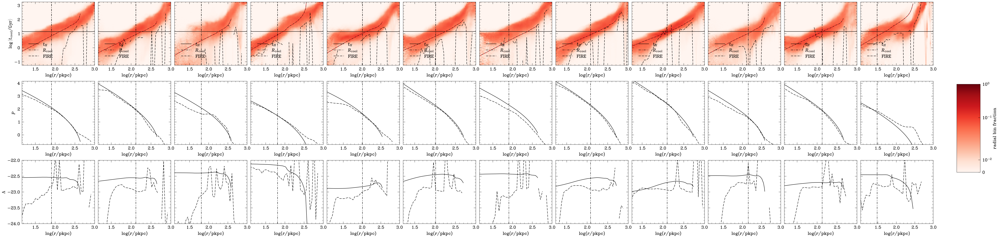

In [77]:
makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']]);

2.8271924906451846
2.8271924906451846
2.8271924906451846
2.966081091422276
2.966081091422276
2.966081091422276
3.037611376921929
3.037611376921929
3.037611376921929
2.825201687365501
2.825201687365501
2.825201687365501
2.7744858598262483
2.7744858598262483
2.7744858598262483


(<Figure size 3600x2160 with 16 Axes>,
 array([[<AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$', ylabel='$\\log \\left< t_{\\mathrm{cool}} / \\mathrm{Gyr} \\right>$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>],
        [<AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$', ylabel='$P$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>],
        [<AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$', ylabel='$\\Lambda$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <Axes

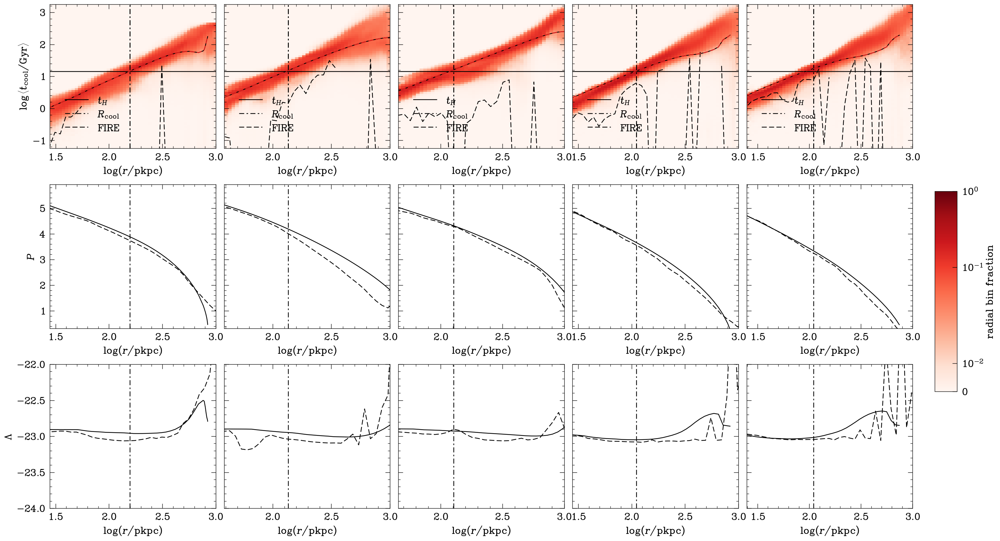

In [78]:
makecoolingflow([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])

### tcool calculations

In [5]:
def faster(sk, majormerger=0.3):
    k = f'm12{sk}_NoBH'
    Sim = Simulation(sim_path_fire3(PaperSimNames[k], quest=True), 500, datadir='simcachev2_Khist_outflow_rhfmask_Rmaxgas02_merger03central02')
    if np.isnan(Sim.Z2Zsun): 
        print(k, 'Z is NAN')
        Sim.Z2Zsun = Sim.Z2ZsunRvir[()]
    R_sonic = bounds[k]*un.kpc
    Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(R_sonic, R_sonic)
    
    rhf = h5todict(os.path.join(Sim.simdir, f'halo/rockstar_dm/catalog_hdf5/halo_{Sim.snapnum:03}.hdf5'))
    rhfmask = inrange(dist(rhf['position'], rhf['position'][rhf['mass.vir'].argmax(),:]) / Sim.pro['Rvir'], (0,1))
    Sim.num_majormergers = np.sum( (rhf['mass.vir'] / rhf['mass.vir'].max()) > majormerger ) - 1
    Sim.sep = np.linalg.norm( rhf['position'][rhf['mass'].argmax()] - Sim.pro['posC'] ) / Sim.pro['Rvir']
    return Sim

res = Parallel(n_jobs=-1, verbose=0)(delayed(faster)(sk) for sk in 'adefjknqruwxz')

/home/ias627/tools/cooling_flow/WiersmaCooling.py:41: RuntimeWarning: invalid value encountered in log10
  vals = log(self.LAMBDA(X*un.K,Y*un.cm**-3).value)
/home/ias627/tools/cooling_flow/WiersmaCooling.py:41: RuntimeWarning: invalid value encountered in log10
  vals = log(self.LAMBDA(X*un.K,Y*un.cm**-3).value)
/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:140: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))
/home/ias627/tools/cooling_flow/WiersmaCooling.py:41: RuntimeWarning: invalid value encountered in log10
  vals = log(self.LAMBDA(X*un.K,Y*un.cm**-3).value)
/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:140: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))
/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:140: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))
/home/ias627/too

In [6]:
[(Sim.sep,Sim.simname) for Sim in res]

[(0.0005836308, 'm12a_r57000'),
 (0.001234483, 'm12d_r57000'),
 (0.00016057222, 'm12e_r57000'),
 (0.0005203651,
  'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5'),
 (16.164398, 'm12j_r7100'),
 (0.00058234803, 'm12k_r57000'),
 (0.0014773691, 'm12n_r7100'),
 (0.00096741103,
  'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5'),
 (0.0008025574,
  'm12r_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5'),
 (0.00037969547, 'm12u_r28000'),
 (0.00060421426,
  'm12w_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5'),
 (0.00017761586, 'm12x_r3500'),
 (0.0014192654,
  'm12z_m4e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5')]

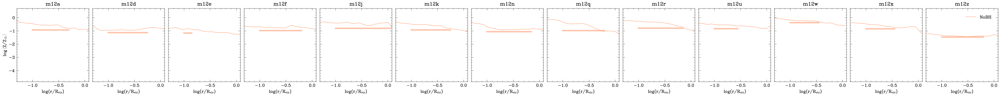

In [22]:
makeZprofile({f'm12{sk}_NoBH':res[i] for i,sk in enumerate('adefjknqruwxz')}, 
             [f'm12{sk}' for i,sk in enumerate('adefjknqruwxz')], 
             prolabels = ['Z_Lweighted'],
             ylabels = [profilelabels['Z lin']],
             onlyNoBH=True)

In [25]:
d = '../data/simcachev2_Khist_outflow_rhfmask_Rmaxgas02_merger03central02/'
sims = np.unique(['_'.join(f.split('_')[1:-1]) for f in os.listdir(d)])
for v in sims:
    print(v)

m12a_r57000
m12d_r57000
m12e_r57000
m12f_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000
m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
m12g_r57000
m12j_r57000
m12j_r7100
m12k_r57000
m12n_r57000
m12n_r7100
m12q_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000
m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
m12r_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
m12u_r28000
m12w_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
m12x_r28000
m12x_r3500
m12z_m4e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
m13h007_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
m13h113_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000
m13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_ga

In [7]:
np.sum(np.array([Sim.num_majormergers for Sim in res])>0) / len(res)*100

69.23076923076923

Text(0.5, 1.0, 'z=0.00\n   excise satellites & $T>10^{5.5}\\ K\\ &\\ n_H < 10^{-2.5}\\ cm^{-3}$')

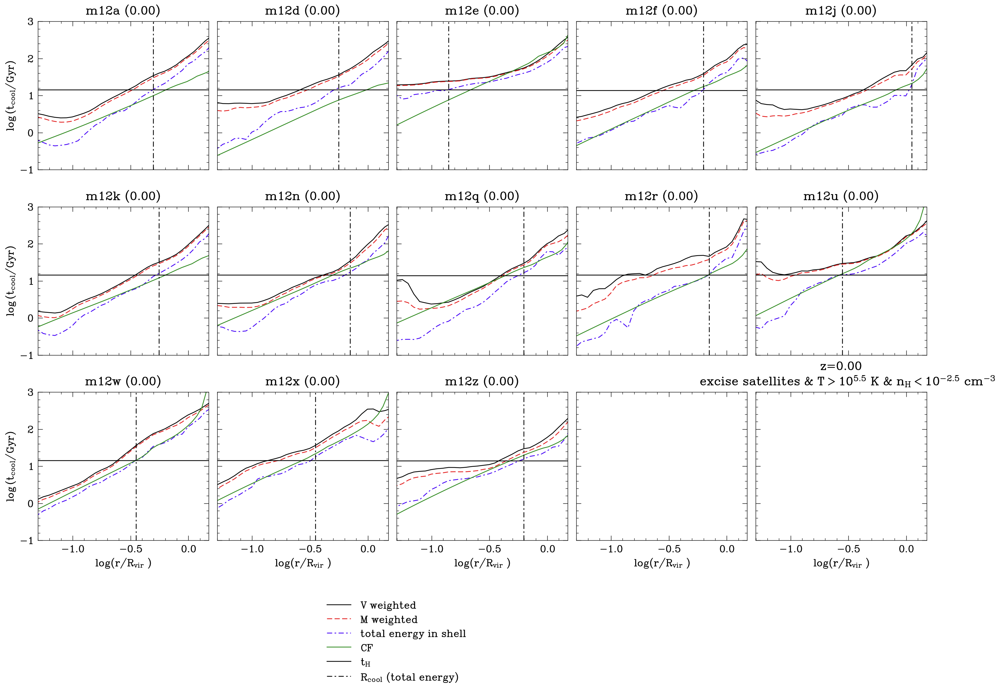

0.29422890440170446 solMass / yr
0.32499999999999996 kpc
0.12804563377854358 solMass / yr
1.5134942167189696 solMass / yr
2.09375 kpc
1.6902017463142538 solMass / yr
7.347261634146101 solMass / yr
1.71875 kpc
22.497048727085467 solMass / yr
3.603289730320069 solMass / yr
1.5625 kpc
3.3197806541283277 solMass / yr
0.3549283623911841 solMass / yr
0.4 kpc
0.2949647135772696 solMass / yr
7.313277294271434 solMass / yr
0.66875 kpc
5.066157293938988 solMass / yr
0.03412074946886124 solMass / yr
0.38749999999999996 kpc
0.17512878948984736 solMass / yr
3.765582141112609 solMass / yr
0.29500000000000004 kpc
3.73272573797206 solMass / yr
0.14532880181408375 solMass / yr
0.321875 kpc
1.1161066143425977 solMass / yr
5.396923161169058 solMass / yr
0.875 kpc
5.389750642911618 solMass / yr
6.178663879220119 solMass / yr
0.45625000000000004 kpc
6.28351645733055 solMass / yr
8.496126077222295 solMass / yr
0.49375 kpc
14.63277746714761 solMass / yr
14.884087258850078 solMass / yr
0.21640625000000002 kpc

In [8]:
fig, axes = plt.subplots(3, 5, sharex=True, sharey=True, gridspec_kw={'wspace': .05, 'hspace':.25}, figsize=[4.8*5,4.8*3], dpi=150, facecolor='w', squeeze=False)
for i,sk in enumerate('adefjknqruwxz'):
    k = f'm12{sk}_NoBH'
    Sim = res[i]
    #print(k, 'excise', Sim.excisefraction)
    logprofiles = Sim.pro
    rmid = logprofiles['rmid']
    
    ax = axes.ravel()[i]
    ax.plot(np.log10(rmid), logprofiles['tcool'], label='V weighted')
    ax.plot(np.log10(rmid), logprofiles['tcool_Mweighted'], '--', label='M weighted')
    ax.plot(np.log10(rmid), logprofiles['tcoolshell'], '-.', label='total energy in shell')

    # Add cooling flow Rcirc solution curves
#     rest = res_cf[k].transonic_solution_fitting TRF
    rest = Sim.transonic_solution
    res_x = np.log10(rest.Rs().to(un.kpc).value / Sim.pro['Rvir'])

    ax.plot(res_x, np.log10(rest.t_cools().to(un.Gyr).value), '-', label='CF')
#     ax.axvline(np.log10(Sim.Rcool/Sim.pro['Rvir']), c='k', ls='-')
    ax.axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
    ax.set_title(f"{Sim.simname.split('_')[0]} ({Sim.excisefraction:.2f})")
    
#     Rcool = res[i].pro['rmid'][res[i].pro['rmid']>0.05][np.flatnonzero(res[i].pro['tcoolshell'][res[i].pro['rmid']>0.05] > np.log10(res[i].tHubble))][0] * res[i].pro['Rvir'] #cooling radius in units pkpc 
    ax.axvline(np.log10(Sim.Rcool/Sim.pro['Rvir']), c='k', ls='-.', label='$R_{cool}$ (total energy)')

ax.set_xlim(np.log10(0.05), np.log10(1.5))
ax.set_ylim(-1, 3)
ax.legend(bbox_to_anchor=(-0.5,-.3))
for ax in axes[-1,:]: ax.set_xlabel(r'$\log ( r/R_{vir}$ )')
for ax in axes[:,0]: ax.set_ylabel(r'$\log \left( t_{\mathrm{cool}} / \mathrm{Gyr} \right)$')
plt.title(f'z={np.abs(Sim.Redshift[()]):.2f}\n' + r'   excise satellites & $T>10^{5.5}\ K\ &\ n_H < 10^{-2.5}\ cm^{-3}$')

In [2]:
kt, st = 'm13h029_NoBH', 57
Sim_m12fNoBH = Simulation(sim_path_fire3(PaperSimNames[kt]), st, datadir='simcachev2_Khist_outflow_rhfmask_Rmaxgas02_merger03')
if np.isnan(Sim_m12fNoBH.Z2Zsun): Sim_m12fNoBH.Z2Zsun = Sim_m12fNoBH.Z2ZsunRvir[()]
R_sonic = 0.66875*un.kpc#0.49375*un.kpc
Sim_m12fNoBH.transonic_solution, Sim_m12fNoBH.R_sonic_mid = Sim_m12fNoBH.binary_search_R_sonic(R_sonic, R_sonic)

45.13105238535329 solMass / yr
0.66875 kpc


AttributeError: 'NoneType' object has no attribute 'Mdot'

In [3]:
keys_to_extract = {
            0:['Coordinates', 'Masses', 'Density', 
            'Temperature', 'InternalEnergy', 'CosmicRayEnergy', 
            'Velocities', 'Metallicity', 'SoundSpeed', 'CoolingRate', 'SmoothingLength', 'MagneticField'],
            1:['Coordinates', 'Masses', 'Velocities'],
            2:['Coordinates', 'Masses', 'Velocities'],
            4:['Coordinates', 'Masses', 'Velocities'],
            5:['Coordinates', 'Masses', 'Velocities']
        }

p = load_allparticles(sim_path_fire3(PaperSimNames[kt], quest=True), snapnum=st, 
                    particle_types=sorted(keys_to_extract.keys()), 
                    keys_to_extract=keys_to_extract, 
                    Rvir='None', loud=0)

In [4]:
# Calculate number density of hydrogen atoms
XH = 1 - p[0]['Metallicity'][:,0] - p[0]['Metallicity'][:,1] #hydrogen mass fraction
nH = ( XH * (p[0]['Density'] * 1e10 * un.Msun/un.kpc**3) / cons.m_p ).to(un.cm**-3) #number density of hydrogen atoms
p[0]['nH'] = nH.to(un.cm**-3).value

In [5]:
# Shift velocity relative to COM's (r/Rvir<1) velocity
velC = velocity_COM(p)
for i in p.keys(): p[i]['Velocities'] -= velC

# Calculate spherical velocites
p[0]['vrad'], p[0]['vtheta'], p[0]['vphi'] = spherical_velocities(v=p[0]['Velocities'], r=p[0]['Coordinates'] - p[0]['posC'])

In [6]:
Zsun = 0.0142 #Asplund+09

Rmax_Z=1

# Calculate mass-weighted average metallicity/Zsun within Rmax_Z*Rvir
p[0]['Z2Zsun']  = np.sum((p[0]['Metallicity'][:,0] * p[0]['Masses'])[p[0]['r_scaled']<=Rmax_Z]) / np.sum(p[0]['Masses'][p[0]['r_scaled']<=Rmax_Z]) / Zsun

In [7]:
Zbins = 1000
Zidxsplit = np.array_split( np.argsort(p[0]['Metallicity'][:,0]/Zsun), Zbins )
p[0]['tcool'] = np.zeros_like(p[0]['nH'])
p[0]['CoolingRate'] = np.zeros_like(p[0]['nH'])
for Zidx in Zidxsplit:
    Z2Zsun = np.mean(p[0]['Metallicity'][Zidx,0]) / Zsun
    cooling = Cool.Wiersma_Cooling(Z2Zsun, p[0]['Redshift'])
    CoolingRate_pred = cooling.LAMBDA(p[0]['Temperature'][Zidx]*un.K, p[0]['nH'][Zidx]*(un.cm**-3)) * (p[0]['nH'][Zidx]*(un.cm**-3))**2
    tcool_pred = ((Pressure(p[0]['InternalEnergy'][Zidx], p[0]['Density'][Zidx], typeP='thermal') * cons.k_B * un.K / un.cm**3) / ( CoolingRate_pred * (5/3-1) ))
    p[0]['tcool'][Zidx] = tcool_pred.to(un.Gyr).value
    p[0]['CoolingRate'][Zidx] = CoolingRate_pred.to(un.erg/un.s*un.cm**-3).value

In [9]:
rhf = h5todict(os.path.join(sim_path_fire3(PaperSimNames[kt], quest=True), f'halo/rockstar_dm/catalog_hdf5/halo_{st:03}.hdf5'))
gas_tree = cKDTree(p[0]['Coordinates'])
star_tree = cKDTree(p[4]['Coordinates'])
hrdm_tree = cKDTree(p[1]['Coordinates'])

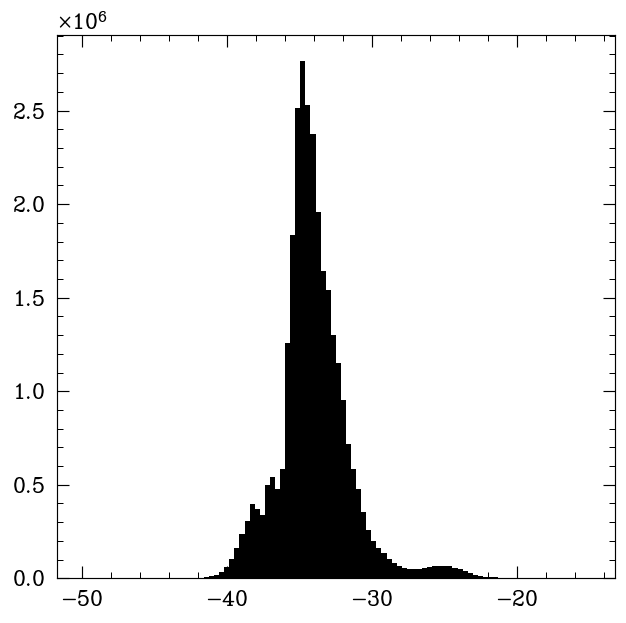

In [40]:
plt.hist(np.log10(p[0]['CoolingRate']), range=(-50,-15), bins=100);

In [109]:
for Zbins in [1, 10, 100, 1000, 10000]:
    Zidxsplit = np.array_split( np.argsort(p[0]['Metallicity'][:,0]/Zsun), Zbins )
    p[0][f'tcool_{Zbins}'] = np.zeros_like(p[0]['nH'])
    p[0][f'CoolingRate_{Zbins}'] = np.zeros_like(p[0]['nH'])
    for Zidx in Zidxsplit:
        Z2Zsun = np.mean(p[0]['Metallicity'][Zidx,0]) / Zsun
        cooling = Cool.Wiersma_Cooling(Z2Zsun, p[0]['Redshift'])
        CoolingRate_pred = cooling.LAMBDA(p[0]['Temperature'][Zidx]*un.K, p[0]['nH'][Zidx]*(un.cm**-3)) * (p[0]['nH'][Zidx]*(un.cm**-3))**2
        tcool_pred = ((Pressure(p[0]['InternalEnergy'][Zidx], p[0]['Density'][Zidx], typeP='thermal') * cons.k_B * un.K / un.cm**3) / ( CoolingRate_pred * (5/3-1) ))
        p[0][f'tcool_{Zbins}'][Zidx] = tcool_pred.to(un.Gyr).value
        p[0][f'CoolingRate_{Zbins}'][Zidx] = CoolingRate_pred.to(un.erg/un.s*un.cm**-3).value

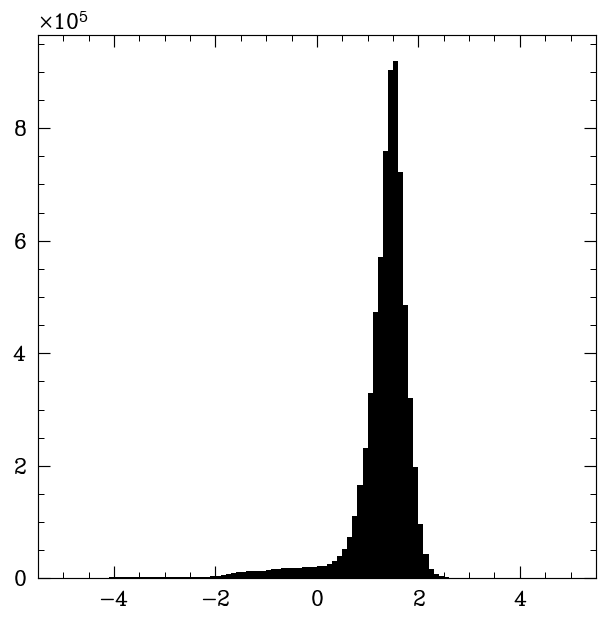

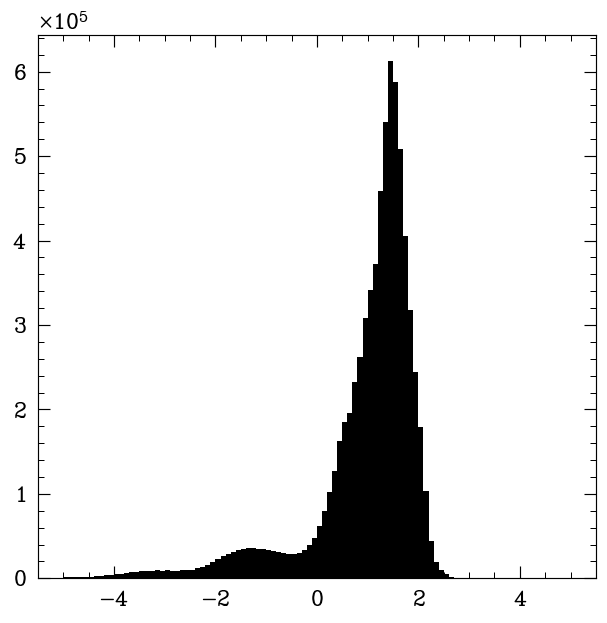

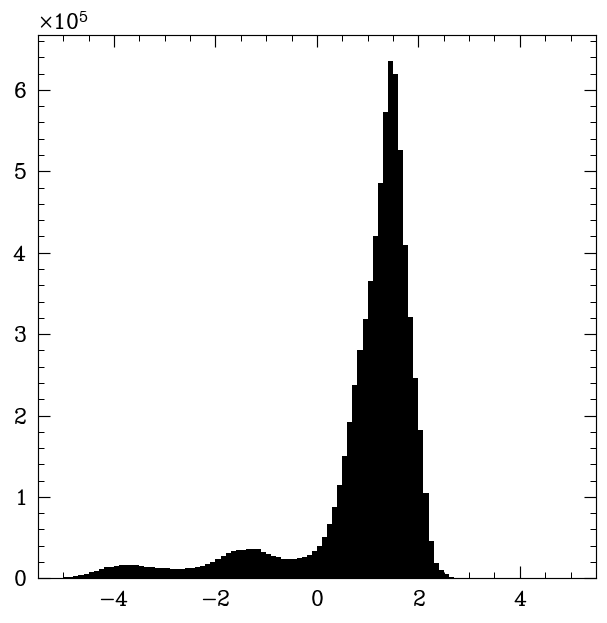

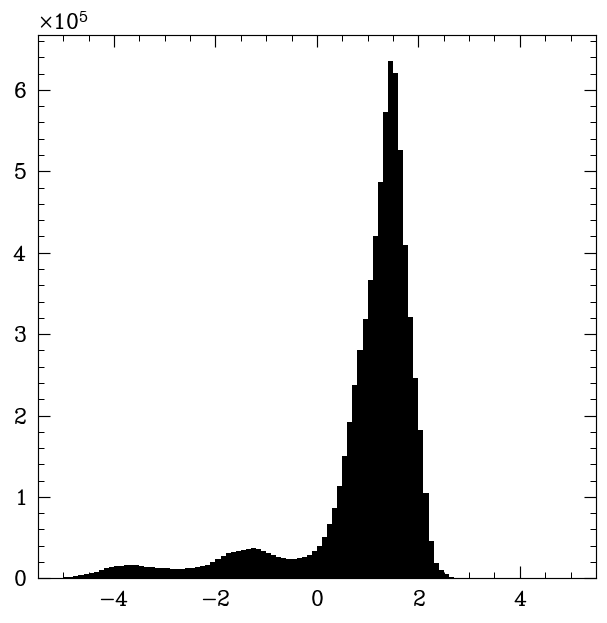

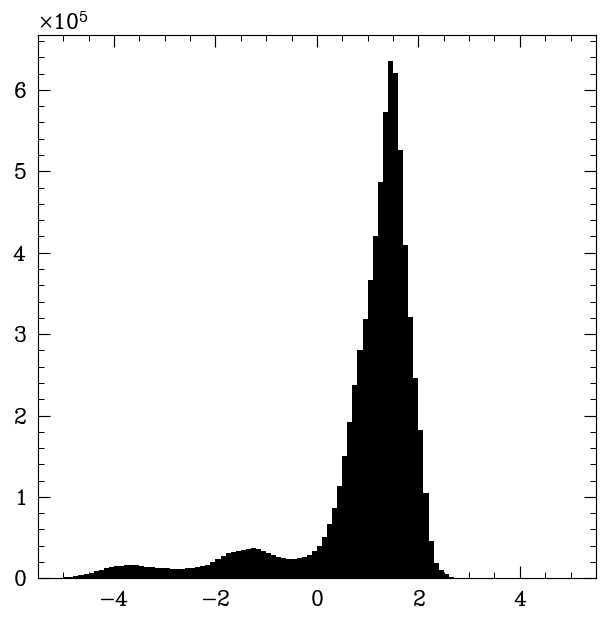

In [118]:
idx = inrange( p[0]['r_scaled'], (.1, 1) )
for Zbins in [1, 10, 100, 1000, 10000]: 
    plt.figure()
    plt.hist(np.log10(p[0][f'tcool_{Zbins}'][idx]), bins=100, range=(-5,5));

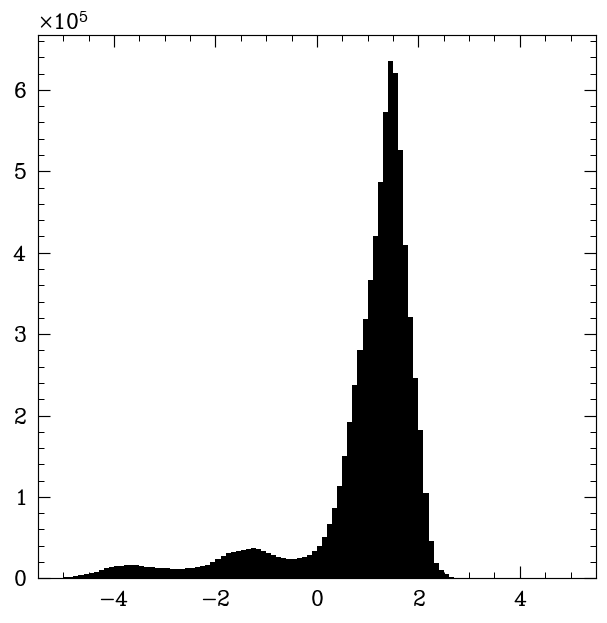

In [119]:
plt.hist(np.log10(p[0]['tcool'][idx]), bins=100, range=(-5,5));

In [62]:
p[0]['tcool_part'] = np.zeros_like(p[0]['nH'])
p[0]['CoolingRate_part'] = np.zeros_like(p[0]['nH'])

def tcool_particle(i):
    Z = p[0]['Metallicity'][i,0] / Zsun
    cooling = Cool.Wiersma_Cooling(Z, p[0]['Redshift'])
    CoolingRate_pred = cooling.LAMBDA(p[0]['Temperature'][i]*un.K, p[0]['nH'][i]*(un.cm**-3)) * (p[0]['nH'][i]*(un.cm**-3))**2
    tcool_pred = ((Pressure(p[0]['InternalEnergy'][i], p[0]['Density'][i], typeP='thermal') * cons.k_B * un.K / un.cm**3) / ( CoolingRate_pred * (5/3-1) ))
    p[0]['tcool_part'][i] = tcool_pred.to(un.Gyr).value
    p[0]['CoolingRate_part'][i] = CoolingRate_pred.to(un.erg/un.s*un.cm**-3).value

In [59]:
tcool_pred_particle = Parallel(n_jobs=-1, verbose=10)(delayed(tcool_particle)(i) for i in np.flatnonzero(idx)[::100])

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 52 concurrent workers.
/home/ias627/tools/cooling_flow/WiersmaCooling.py:41: RuntimeWarning: invalid value encountered in log10
  vals = log(self.LAMBDA(X*un.K,Y*un.cm**-3).value)
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   49.4s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:   49.6s
[Parallel(n_jobs=-1)]: Done  41 tasks      | elapsed:   49.9s
[Parallel(n_jobs=-1)]: Done  58 tasks      | elapsed:   50.1s
[Parallel(n_jobs=-1)]: Done  77 tasks      | elapsed:   50.4s
/home/ias627/tools/cooling_flow/WiersmaCooling.py:41: RuntimeWarning: invalid value encountered in log10
  vals = log(self.LAMBDA(X*un.K,Y*un.cm**-3).value)
[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   50.7s
[Parallel(n_jobs=-1)]: Done 117 tasks      | elapsed:   50.9s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:   51.0s
[Parallel(n_jobs=-1)]: Done 161 tasks      | elapsed:   51.2s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapse

KeyboardInterrupt: 

In [71]:
idx2 = np.flatnonzero(idx)[::100]
for i in tqdm(idx2):
    tcool_particle(i)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 77255/77255 [07:13<00:00, 178.38it/s]


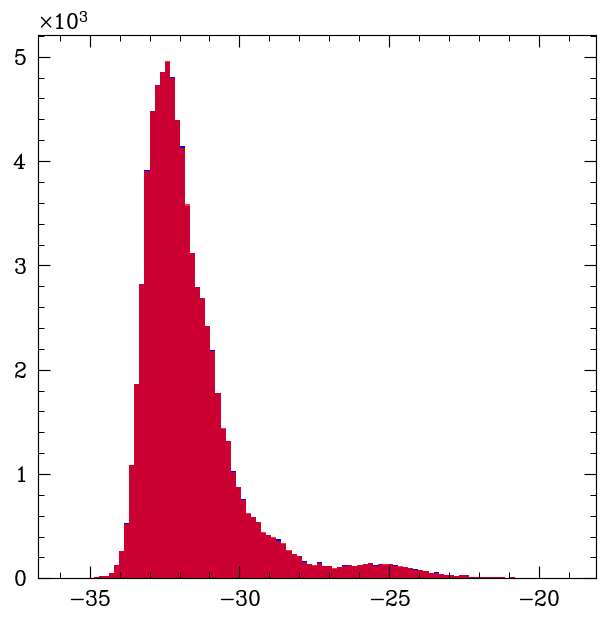

In [93]:
plt.hist(np.log10(p[0]['CoolingRate'][idx2]), bins=100, alpha=1, color='b');
plt.hist(np.log10(p[0]['CoolingRate_part'][idx2]), bins=100, color='r',alpha=.8);

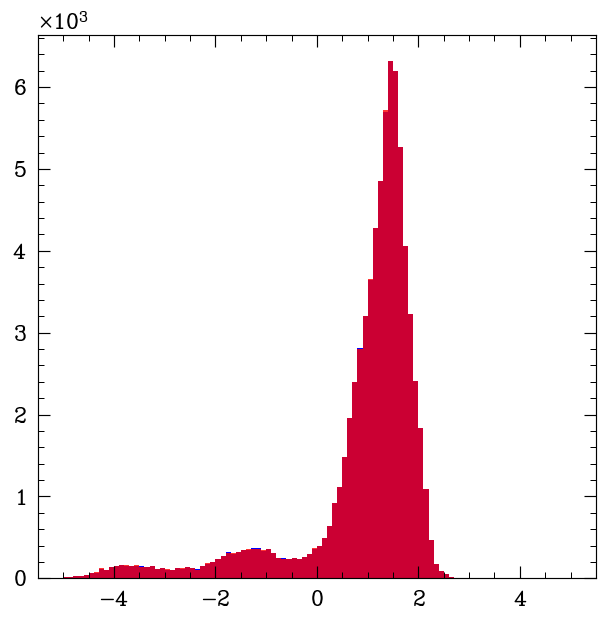

In [82]:
plt.hist(np.log10(p[0]['tcool'][idx2]), bins=100, range=(-5,5), alpha=1, color='b');
plt.hist(np.log10(p[0]['tcool_part'][idx2]), bins=100, range=(-5,5), color='r',alpha=.8);

In [18]:
p0 = p[0]
rbins=np.power(10, np.arange(np.log10(0.005258639741921723), np.log10(3), 0.05))
rmid = (rbins[:-1]+rbins[1:])/2 #in units of Rvir
logprofiles = { k:[] for k in ['tcool', 'tcool_100', 'tcool_1000', 'tcool_10000', 'tcool_Mweighted', 'tcoolshell',
                              'CoolingRate', 'P_th', 'P_turb', 'P_mag',
                              'Vfrac', 'Vfrac_mask'] }
mask = excise_satellites(rhf,gas_tree,star_tree,Rmax_gas=0.2,majormerger=0.3)&(p0['Temperature'] > 10**5.5)&(p0['nH'] < 10**(-2.5))
# mask = (p0['Temperature'] > 10**5.5)&(p0['nH'] < 10**(-2.5))
# mask = excise_satellites(rhf,gas_tree,star_tree)&(p0['nH'] < 10**(-2.5))
for r0,r1 in zip(rbins[:-1],rbins[1:]):
    idx = np.flatnonzero(mask&inrange( p0['r_scaled'], (r0, r1) ))
    V = np.sum(p0['Vi'][idx]) #volume of shell in physical kpc^3
    Mshell = np.sum(p0['Masses'][idx]) #mass of shell
    
    Vshell_geo = 4/3 * np.pi * (r1**3 - r0**3) * p0['Rvir']**3  #geometric volume of shell in physical kpc^3
    Vshell_part = np.sum(p0['Vi'][inrange( p0['r_scaled'], (r0, r1) )]) #volume of shell in physical kpc^3
    logprofiles['Vfrac'].append(Vshell_part/Vshell_geo)
    logprofiles['Vfrac_mask'].append(V/Vshell_part)
    
    # tcool profile (averaging in linear space): log <tcool/Gyr>
    # filter out particles where tcool is infinite, keeping shell volume V the same
    assert not np.any(p0['tcool']==np.inf)

    tcoolavg = np.sum(p0['tcool'][idx] * p0['Vi'][idx]) / V
    logprofiles['tcool'].append(np.log10(tcoolavg))
    
    for Zbins in [100, 1000, 10000]:
        continue
        tcoolavg = np.sum(p0[f'tcool_{Zbins}'][idx] * p0['Vi'][idx]) / V
        logprofiles[f'tcool_{Zbins}'].append(np.log10(tcoolavg))
    
    tcoolavg_Mweighted = np.sum(p0['tcool'][idx] * p0['Masses'][idx]) / Mshell
    logprofiles['tcool_Mweighted'].append(np.log10(tcoolavg_Mweighted))

    tcoolavgshell = (np.sum(p0['InternalEnergy'][idx]*p0['Density'][idx]) / np.sum(p0['CoolingRate'][idx]) * 1e10 * un.Msun/un.kpc**3 * (un.km/un.s)**2 / (un.erg/un.s*un.cm**-3)).to(un.Gyr).value
#     tcoolavgshell = np.sum(p0['InternalEnergy'][idx]*p0['Density'][idx]) / np.sum(p0['CoolingRate'][idx])
#     print(np.sum(p0['InternalEnergy'][idx]*p0['Density'][idx]) , np.sum(p0['CoolingRate'][idx]), np.log10(tcoolavgshell))
    logprofiles['tcoolshell'].append(np.log10(tcoolavgshell))
    
    CoolingRateavg = np.sum(p0['CoolingRate'][idx] * p0['Vi'][idx]) / V
    logprofiles['CoolingRate'].append(np.log10(CoolingRateavg))
    
    # Thermal pressure profile (averaging in linear space): log <P_th/(k_B K/cm^3)>
    P_thi = Pressure(p0['InternalEnergy'][idx], p0['Density'][idx], typeP='thermal')
    Pthavg = np.sum(P_thi * p0['Vi'][idx]) / V
    logprofiles['P_th'].append(np.log10(Pthavg))

    # Turbulent pressure profile: log <P_turb/(k_B K/cm^3)>
    rhoavg = (Mshell / V)*10
    var = 1/3 * ( np.var(p0['vrad'][idx]) + np.var(p0['vtheta'][idx]) + np.var(p0['vphi'][idx]) )
    Pturbavg = (rhoavg*un.Msun/un.pc**3 * var*(un.km/un.s)**2).to(cons.k_B * un.K / un.cm**3).value
    logprofiles['P_turb'].append(np.log10(Pturbavg))
    
    # Magnetic pressure profile (averaging in linear space): log <P_mag/(k_B K/cm^3)>
    P_magi = (np.linalg.norm(p[0]['MagneticField'][idx], axis=1)**2 * un.Gauss**2 / (2*cons.mu0)).to(cons.k_B * un.K / un.cm**3).value
    Pmagavg = np.sum(P_magi * p0['Vi'][idx]) / V
    logprofiles['P_mag'].append(np.log10(Pmagavg))
    
logprofiles = {k:np.array(v) for k,v in logprofiles.items()}

In [42]:
Cool.Wiersma_Cooling(Sim_m12fNoBH.Z2Zsun, Sim_m12fNoBH.Redshift).tcool(10**6.8*un.K, 10**(-3.4)/un.cm**3).to('Gyr')

<Quantity 23.01320489 Gyr>

Text(0.5, 1.0, 'm12d_r57000\nz=0.00\nexcise satellites & $T>10^{5.5}\\ K\\ &\\ n_H < 10^{-2.5}\\ cm^{-3}$')

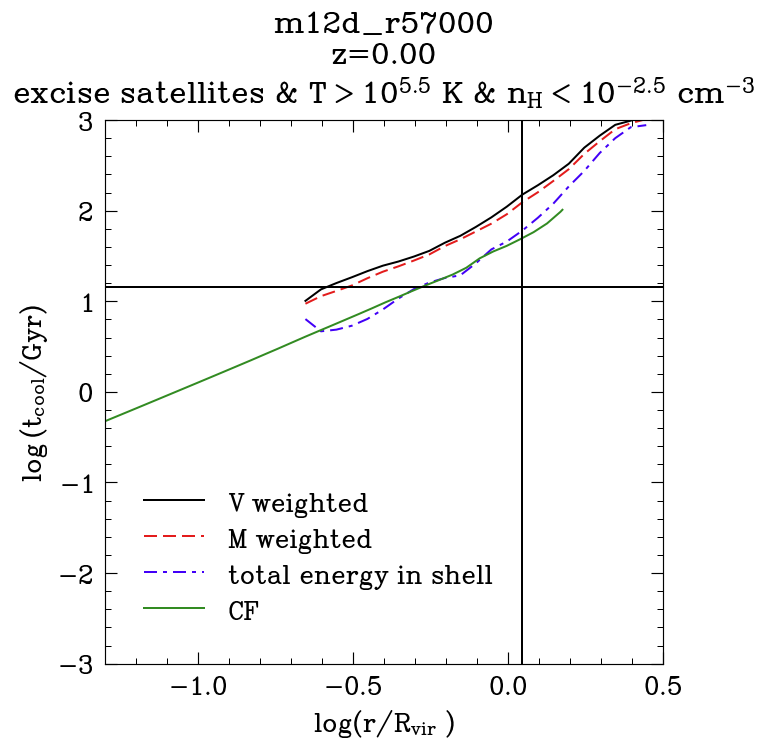

In [19]:
plt.figure(dpi=120)
plt.plot(np.log10(rmid), logprofiles['tcool'], label='V weighted')
plt.plot(np.log10(rmid), logprofiles['tcool_Mweighted'], '--', label='M weighted')
plt.plot(np.log10(rmid), logprofiles['tcoolshell'], '-.', label='total energy in shell')
plt.xlim(np.log10(0.05), 0.5)
plt.ylim(-3, 3)

# Add cooling flow Rcirc solution curves
res = Sim_m12fNoBH.transonic_solution
res_x = np.log10(res.Rs().to(un.kpc).value / Sim_m12fNoBH.pro['Rvir'])

plt.plot(res_x, np.log10(res.t_cools().to(un.Gyr).value), '-', label='CF')
plt.legend()

plt.xlabel(r'$\log ( r/R_{vir}$ )')
plt.ylabel(r'$\log \left( t_{\mathrm{cool}} / \mathrm{Gyr} \right)$')

plt.axvline(np.log10(Sim_m12fNoBH.Rcool/Sim_m12fNoBH.pro['Rvir']), c='k', ls='-')
# plt.axvline(np.log10(Sim_m12fNoBH.pro['Rvir']), c='b', ls='-.')
plt.axhline(np.log10(Sim_m12fNoBH.tHubble), label=r'$t_H$', c='k')
# plt.xlim(np.log10(0.05*pro['Rvir']), 3)
plt.title(f'{Sim_m12fNoBH.simname}\nz={Sim_m12fNoBH.Redshift[()]:.2f}\n' + r'excise satellites & $T>10^{5.5}\ K\ &\ n_H < 10^{-2.5}\ cm^{-3}$')
# plt.title(f'{Sim_m12fNoBH.simname}\nz={Sim_m12fNoBH.Redshift[()]:.2f}\n' + r'excise satellites & $n_H < 10^{-2.5}\ cm^{-3}$')
# plt.title(f'{Sim_m12fNoBH.simname}\nz={Sim_m12fNoBH.Redshift[()]:.2f}\n' + r'excise satellites')

In [22]:
1-np.sum(p[0]['Vi'][inrange(p[0]['r_scaled'], (0.,1))&excise_satellites(rhf,gas_tree,star_tree)])/np.sum(p[0]['Vi'][inrange(p[0]['r_scaled'], (0.,1))])

0.11486953496932983

(0.0, 1.0)

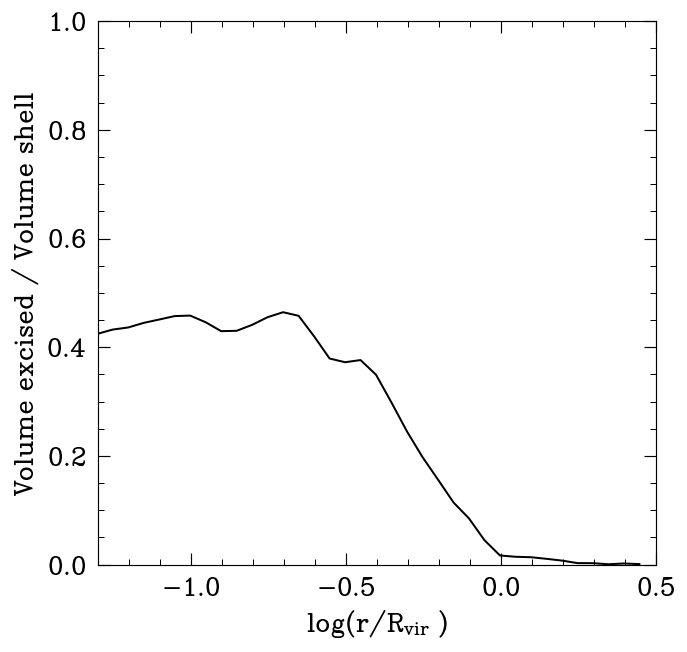

In [123]:
# plt.plot(np.log10(rmid), logprofiles['Vfrac'], label='V weighted')
plt.plot(np.log10(rmid), 1-logprofiles['Vfrac_mask'], label='V weighted')
# plt.axhline(1, c='k', ls='-')
plt.xlabel(r'$\log ( r/R_{vir}$ )')
plt.ylabel(r'Volume excised / Volume shell')
plt.xlim(np.log10(0.05), 0.5)
plt.ylim(0,1)

(-1.3010299956639813, 0.5)

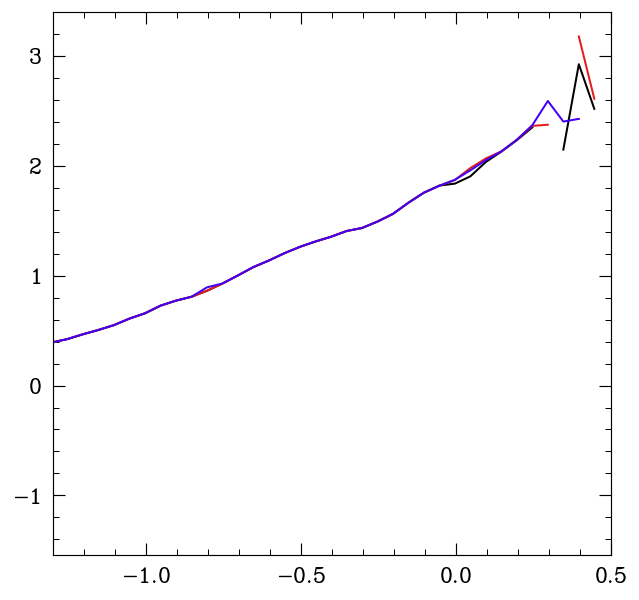

In [155]:
plt.plot(np.log10(rmid), logprofiles['tcool_100'])
plt.plot(np.log10(rmid), logprofiles['tcool_1000'])
plt.plot(np.log10(rmid), logprofiles['tcool_10000'])

plt.xlim(np.log10(0.05), 0.5)

#### Pressure fractions (turb, mag)

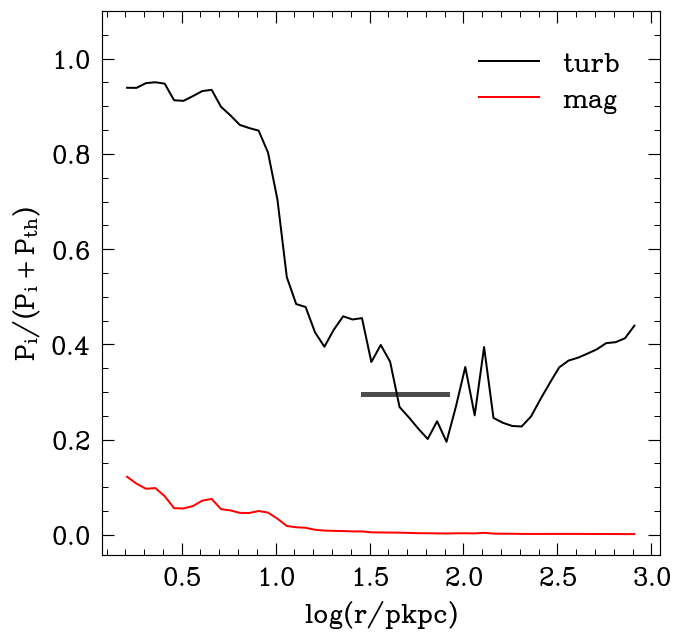

In [40]:
# Magnetic pressure and turbulent pressure fractions for m12f NoBH
Pturbratio = 10**logprofiles['P_turb'] / (10**logprofiles['P_turb'] + 10**logprofiles['P_th'])
plt.plot(np.log10(rmid*p[0]['Rvir']), Pturbratio, 'k-', label='turb', zorder=0)

Pmagratio = 10**logprofiles['P_mag'] / (10**logprofiles['P_mag'] + 10**logprofiles['P_th'])
plt.plot(np.log10(rmid*p[0]['Rvir']), Pmagratio, 'r-', label='mag', zorder=0)

Rmin, Rmax = np.log10(0.1 * p[0]['Rvir']), np.log10(Sim_m12fNoBH.Rcool)
plt.plot((Rmin, Rmax), ((1+Sim_m12fNoBH.alpha_avg**-1)**-1, (1+Sim_m12fNoBH.alpha_avg**-1)**-1), 'k-', linewidth=3, alpha=.7, zorder=10)

plt.xlabel('$\log (r/\mathrm{pkpc})$')
plt.ylabel('$P_{\mathrm{i}} / (P_{\mathrm{i}}+P_{\mathrm{th}})$')

#     plt.title(k + ' ' + f'z={np.abs(Sim.Redshift):.02f} {Sim.alpha_avg:.03f}')
plt.ylim((-0.04175976784173662, 1.1))
plt.legend()

#### Particle cuts

Text(0.5, 0, '$\\log(T/K)$')

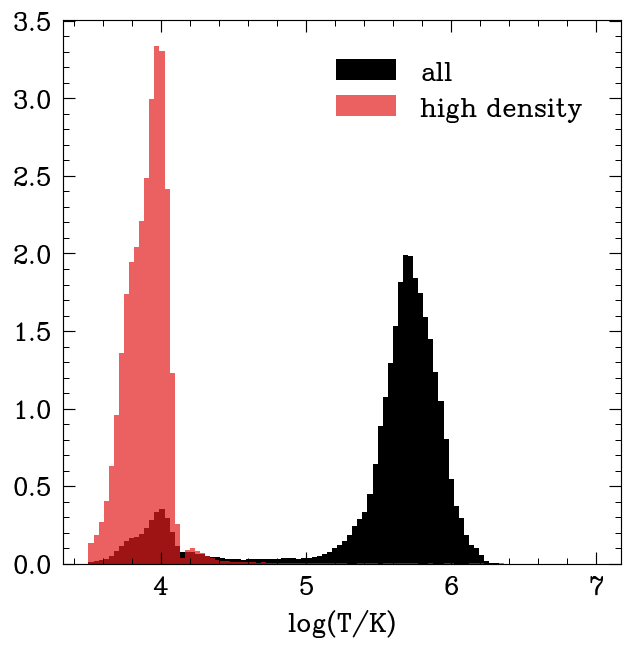

In [45]:
plt.hist(
    np.log10(
        p[0]['Temperature'][
            inrange(p[0]['r_scaled'], (0.05,1))
        ]), bins=100, density=True, range=(3.5,7), label='all');

plt.hist(
    np.log10(
        p[0]['Temperature'][
            inrange(p[0]['r_scaled'], (0.05,1))&(p[0]['nH']>10**(-2.5))
        ]), bins=100, density=True, range=(3.5,7), alpha=0.7, label='high density');
plt.legend()
plt.xlabel(r'$\log(T/K)$')

In [189]:
def colormap_gen(p, k, krange, f=1, rrange=(0, 3), log=True, bins=100):
    idx = inrange( p['r_scaled']*p['Rvir'], np.power(10, rrange) )
    Mtest = f*p[k][idx]
    if log: Mtest = np.log10(Mtest)
    
    rtest = np.log10(p['r_scaled'][idx]*p['Rvir'])
    hrange = [[rtest.min(), rtest.max()],krange]
    
    H, xedges, yedges = np.histogram2d(rtest, Mtest, bins=bins, range=hrange, density=True, weights=p['Masses'][idx])
    X, Y = np.meshgrid(xedges, yedges)
    H = H.T
    
    for i in range(H.shape[1]):
        H[:,i] = H[:,i] / np.sum(H[:,i])
    
    return {'X':X, 'Y':Y, 'H':H}
res_cf = {'m12f_NoBH':Sim_m12fNoBH}
res_cf['m12f_NoBH'].cmap_T = colormap_gen( p[0], 'Temperature', (3,9) )
res_cf['m12f_NoBH'].cmap_nH =  colormap_gen(p[0], 'nH', (-7,1) )
res_cf['m12f_NoBH'].cmap_tcool = colormap_gen(p[0], 'tcool', (-2,4) )

(3.0, 7.0)

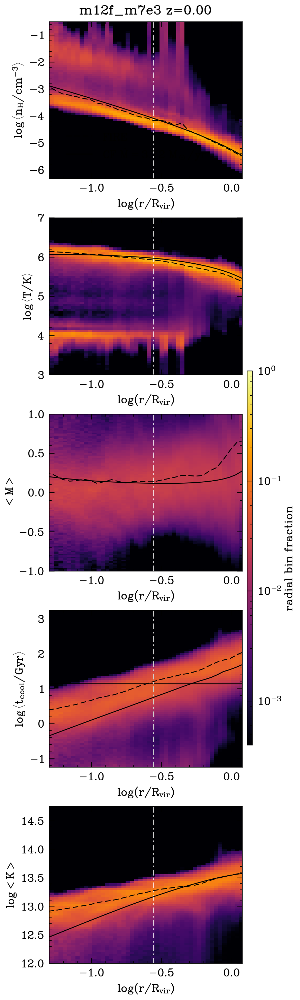

In [233]:
def colormap(k, ax, sim, Rvir=1):
    d = getattr(sim, f'cmap_{k}')
#     im = ax.pcolormesh(np.log10(10**d['X']/Rvir), d['Y'], d['H'], cmap='Reds', norm=colors.SymLogNorm(linthresh=0.03, vmin=0, vmax=1))
#     im = ax.pcolormesh(np.log10(10**d['X']/Rvir), d['Y'], d['H'], cmap='Reds', norm=colors.SymLogNorm(linthresh=0.03, vmin=0, vmax=.01))
    im = ax.pcolormesh(np.log10(10**d['X']/Rvir), d['Y'], d['H'], cmap='inferno', norm=colors.LogNorm(vmin=10**-3.4, vmax=1, clip=True))
    return im
fig, axes = makecoolingflow([res_cf['m12f_NoBH']])
axes[1,0].set_ylim(3,7)

#### Particle cuts: outlier particles

In [30]:
p[0]['EnergyDensity'] = (p[0]['InternalEnergy']*p[0]['Density']* 1e10 * un.Msun/un.kpc**3 * (un.km/un.s)**2).to(un.erg/un.cm**3).value

In [100]:
rmask = inrange(p[0]['r_scaled'], (0.1,0.2))
mask1 = rmask&inrange(p[0]['Temperature'], (10**4.5,np.inf))
mask2 = rmask&inrange(p[0]['Temperature'], (10**5.5,np.inf))
mask3 = rmask&inrange(p[0]['Temperature'], (10**4.5,10**5.5))

mask4 = rmask&(p[0]['CoolingRate'] < 1e-29)

# plt.hist(np.log10(p[0]['CoolingRate'][mask]), bins=100, range=(-35,-15));


for mask in (mask1, mask2, mask4):
    for k in ('CoolingRate', 'EnergyDensity', 'tcool', 'nH', 'Temperature', 'Metallicity'):
        print(np.median(p[0][k][mask]), np.max(p[0][k][mask]), np.min(p[0][k][mask]))
    print(np.median(p[0]['Metallicity'][mask,0])/0.0142, np.max(p[0]['Metallicity'][mask,0])/0.0142, np.min(p[0]['Metallicity'][mask,0])/0.0142)
    print()
#     print(np.sum(p[0]['CoolingRate'][mask]))

4.149148e-31 5.6202685e-26 2.4939855e-32
5.850721e-14 1.6749878e-12 4.483333e-15
4.6757965 39.313976 0.0001673506
0.00013488834 0.028755605 4.4716977e-05
983383.0 2399395.8 31624.459
177890720.0 68481143000.0 6.401319e-07
0.11551675950767289 2.598004074583591 0.015458163418347985

3.879435e-31 1.6928212e-27 2.4939855e-32
5.935234e-14 1.6749878e-12 1.6935985e-14
4.951792 39.313976 0.018487515
0.0001316154 0.006443946 4.4716977e-05
996749.94 2399395.8 316250.72
173320600.0 62825750000.0 6.401319e-07
0.11189314405578123 1.9180580553874162 0.015458163418347985

3.0881995e-31 9.9993824e-30 -3.92558e-25
5.344054e-14 9.505051e-13 3.568557e-17
3.7102575 617.8868 -9771.392
0.00014911841 1.7849828 4.4716977e-05
929780.4 2399395.8 15.475584
193782720.0 47211532000.0 6.401319e-07
0.13368186199853957 1.8349633565251255 0.015458163418347985



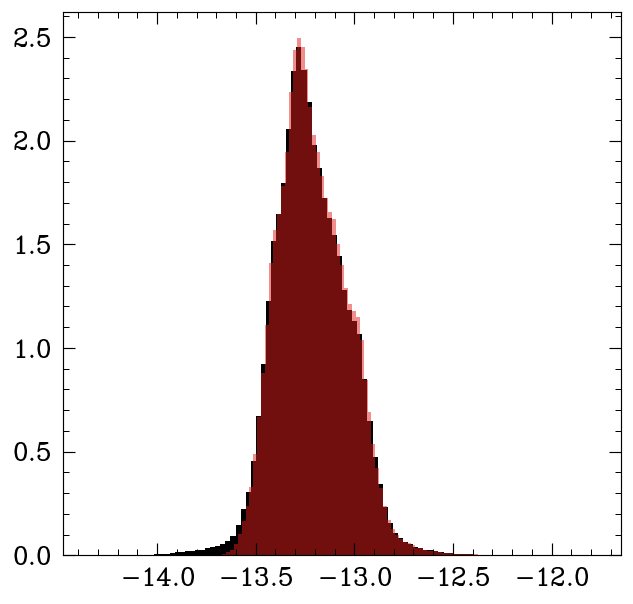

In [48]:
plt.hist(np.log10(p[0]['EnergyDensity'][mask1]), density=True, bins=100)
plt.hist(np.log10(p[0]['EnergyDensity'][mask2]), density=True, alpha=0.5, bins=100);

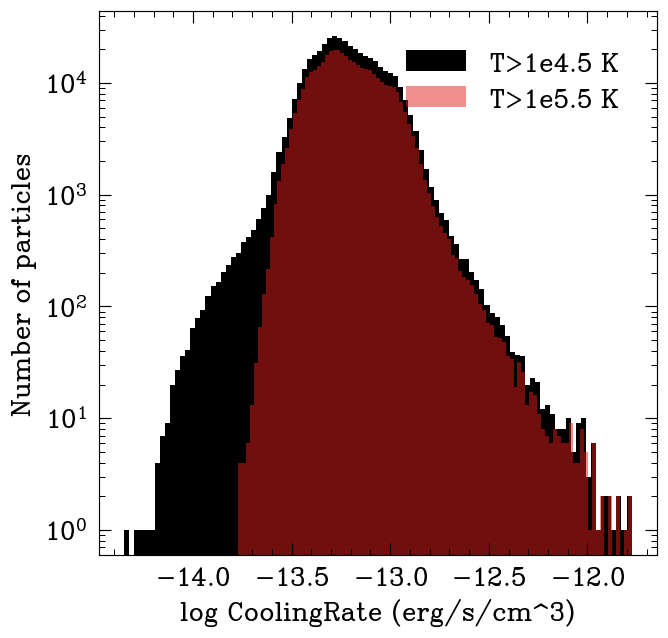

In [78]:
plt.hist(np.log10(p[0]['EnergyDensity'][mask1]), density=False, bins=100, label='T>1e4.5 K')
plt.hist(np.log10(p[0]['EnergyDensity'][mask2]), density=False, alpha=0.5, bins=100, label='T>1e5.5 K');

plt.xlabel('log CoolingRate (erg/s/cm^3)')
plt.ylabel('Number of particles')
plt.legend()
plt.yscale('log')

# plt.errorbar([np.log10(np.median(p[0]['Co olingRate'][mask1]))], [0.1], xerr=np.std(np.log10(p[0]['CoolingRate'][mask1])), marker='o')

In [93]:
(p[0]['CoolingRate'][mask2]<0).sum()/ len(p[0]['CoolingRate'][mask2])

0.0

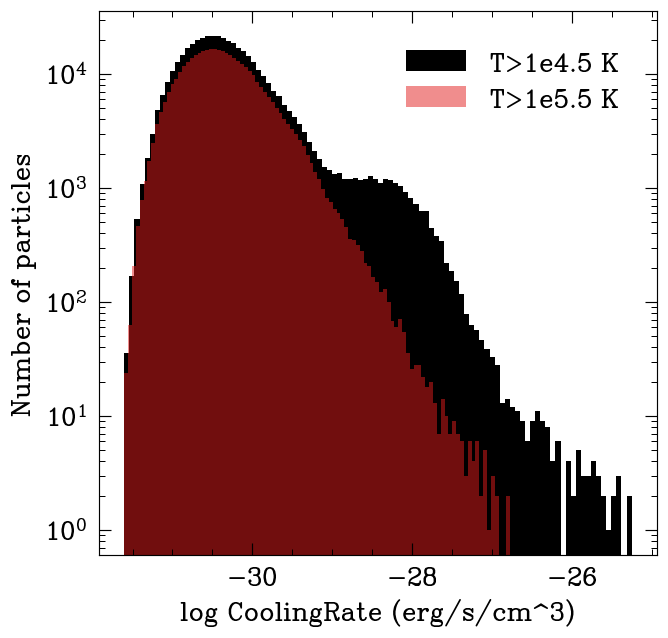

In [96]:
plt.hist(np.log10(p[0]['CoolingRate'][mask1]), density=False, bins=100, label='T>1e4.5 K')
plt.hist(np.log10(p[0]['CoolingRate'][mask2]), density=False, alpha=0.5, bins=100, label='T>1e5.5 K');

plt.xlabel('log CoolingRate (erg/s/cm^3)')
plt.ylabel('Number of particles')
plt.legend()
plt.yscale('log')

# plt.errorbar([np.log10(np.median(p[0]['Co olingRate'][mask1]))], [0.1], xerr=np.std(np.log10(p[0]['CoolingRate'][mask1])), marker='o')

In [85]:
(np.sum(p[0]['EnergyDensity'][mask4]) / np.sum(p[0]['CoolingRate'][mask4]) * un.s).to('Gyr')

<Quantity -0.00909571 Gyr>

In [35]:
for mask in (mask1, mask2):
    extreme_idx = np.argsort(p[0]['tcool'][mask])[:5]
    print(p[0]['tcool'][mask][extreme_idx]*un.Gyr)
    print(p[0]['CoolingRate'][mask][extreme_idx]*un.erg/un.s/un.cm**3)
    print(p[0]['Temperature'][mask][extreme_idx]*un.K)
    print(p[0]['Density'][mask][extreme_idx]*1e10 *un.Msun/un.kpc**3)
    print(p[0]['Metallicity'][mask,0][extreme_idx]/0.0142)
    print(p[0]['EnergyDensity'][mask][extreme_idx])
    print(p[0]['nH'][mask][extreme_idx])
    print()

[0.00016735 0.0001926  0.00019558 0.00019794 0.00021545] Gyr
[5.6157646e-26 3.3350709e-26 3.2403855e-26 3.7924599e-26 4.1625065e-26] erg / (cm3 s)
[41089.973 32029.102 32878.918 36347.61  36031.086] K
[858885.4  745102.94 709556.94 765550.1  940489.6 ] solMass / kpc3
[0.48780593 0.31478703 0.41082314 0.40541926 0.15527555]
[2.9657882e-13 2.0270986e-13 1.9999584e-13 2.3689449e-13 2.8301040e-13]
[0.02593751 0.02264589 0.02149309 0.02319456 0.02875561]

[0.01848751 0.01940766 0.02091906 0.02242544 0.02312862] Gyr
[1.0290145e-27 1.5382753e-27 1.1254773e-27 8.1076268e-28 8.7780430e-28] erg / (cm3 s)
[392144.22 352456.1  336739.06 341483.62 365744.88] K
[107839.97 187750.03 154965.44 118075.13 123110.42] solMass / kpc3
[0.43990192 0.16121809 0.15613979 0.21283823 0.24322361]
[6.0034936e-13 9.4213092e-13 7.4298965e-13 5.7377101e-13 6.4069512e-13]
[0.00326208 0.00573899 0.0047379  0.00360252 0.00375346]



In [111]:
coords = p[0]['Coordinates'][rmask]
coords -= p[0]['posC']
coords_sample = coords[np.random.randint(0,len(coords), 1000000), :]

coords_sample2 = p[0]['Coordinates'][mask4]
coords_sample2 -= p[0]['posC']

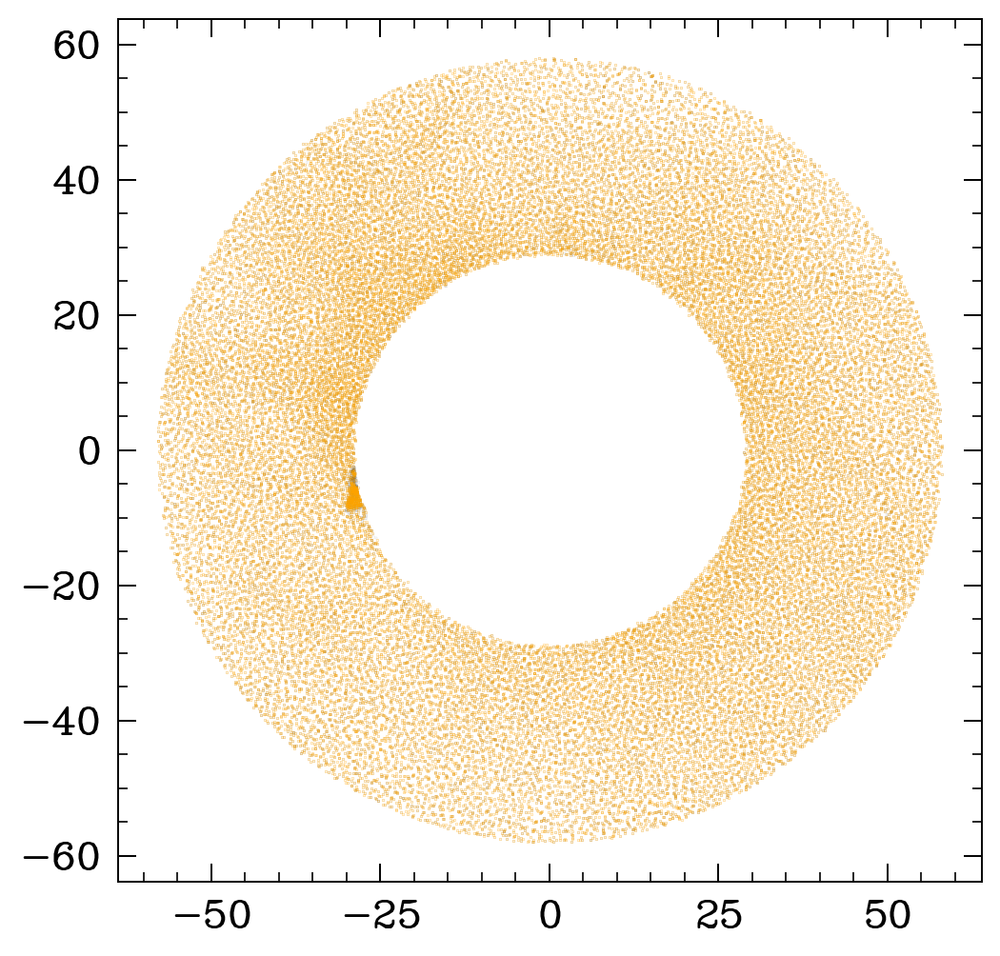

In [118]:
zmask = inrange(coords_sample[:,2], (-5,5))
zmask2 = inrange(coords_sample2[:,2], (-5,5))

plt.figure(dpi=200)
plt.gca().set_aspect('equal')
plt.scatter(coords_sample[:,0][zmask], coords_sample[:,1][zmask], s=.01, alpha=0.1)
plt.scatter(coords_sample2[:,0][zmask2], coords_sample2[:,1][zmask2], s=.01, alpha=1, color='orange')

#### Subhalo finder

In [10]:
np.sort(rhf['mass.vir'] / rhf['mass.vir'].max())[-5:]

array([0.04337301, 0.0695522 , 0.10250948, 0.12928256, 1.        ],
      dtype=float32)

In [11]:
rhf['position_center'] = rhf['position'] - p[1]['posC']
rhf['r_scaled'] = np.linalg.norm(rhf['position_center'], axis=1) / p[1]['Rvir']

In [35]:
coords = p[1]['Coordinates'].copy()#[inrange(p[1]['r_scaled'], (0,1))]
coords -= p[1]['posC']
coords_sample = coords[np.random.randint(0,len(coords), 1000000), :]

In [36]:
rmask = inrange(rhf['r_scaled'], (0,1))

(-9008.8212890625, 13500.3798828125) (-4747.258984375, 9648.501171875)


(-4560.3671875, 9639.6015625)

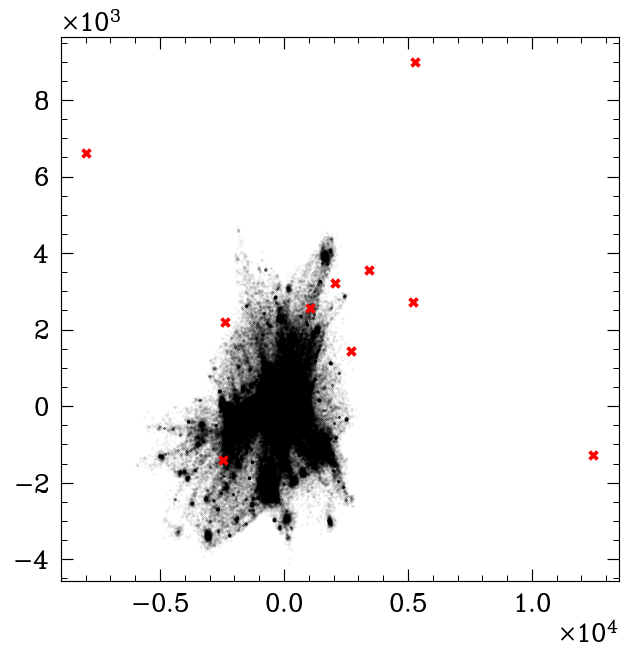

In [37]:
plt.scatter(coords_sample[:,0], coords_sample[:,1], s=.1, alpha=.1)
plt.scatter(rhf['position_center'][rhf['mass.vir'].argsort()[-10:],0], 
            rhf['position_center'][rhf['mass.vir'].argsort()[-10:],1], s=40, alpha=1, c='r', marker='X',lw=0)
print(plt.xlim(), plt.ylim())
plt.xlim((-9008.8212890625, 13500.3798828125))
plt.ylim((-4560.3671875, 9639.6015625))

0.38337627
0.91636395
0.34199512
0.38337627
0.91636395
0.34199512
0.38337627
0.91636395
0.34199512
0.38337627
0.91636395
0.34199512
0.38337627
0.91636395
0.34199512


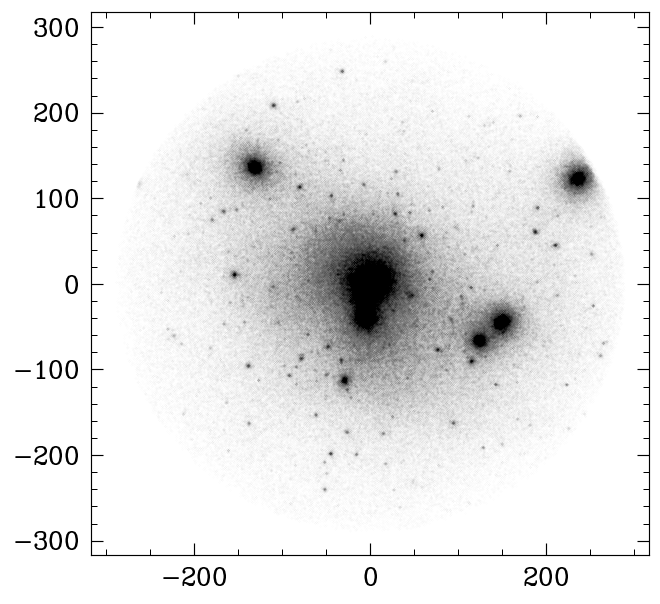

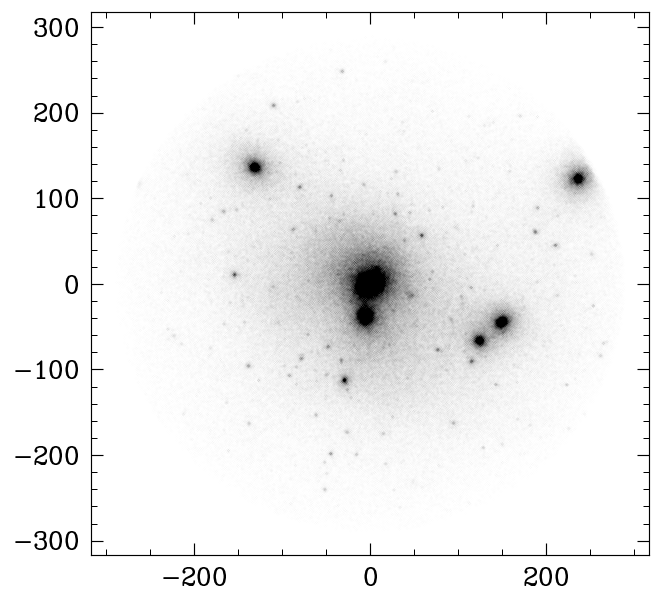

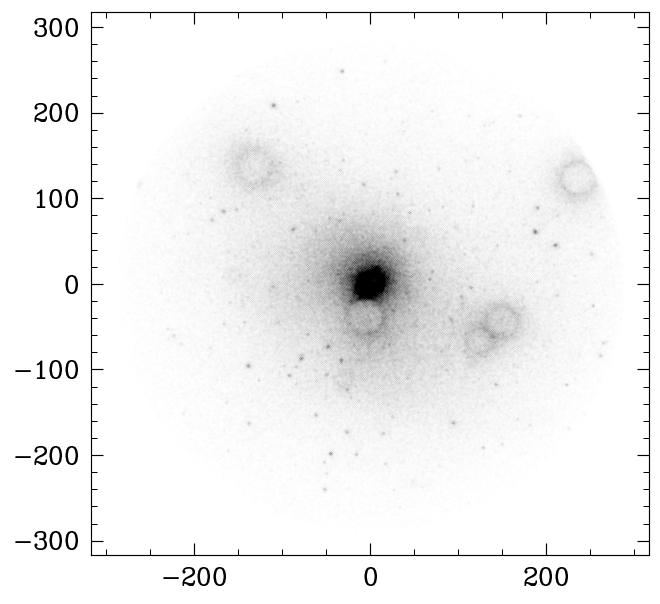

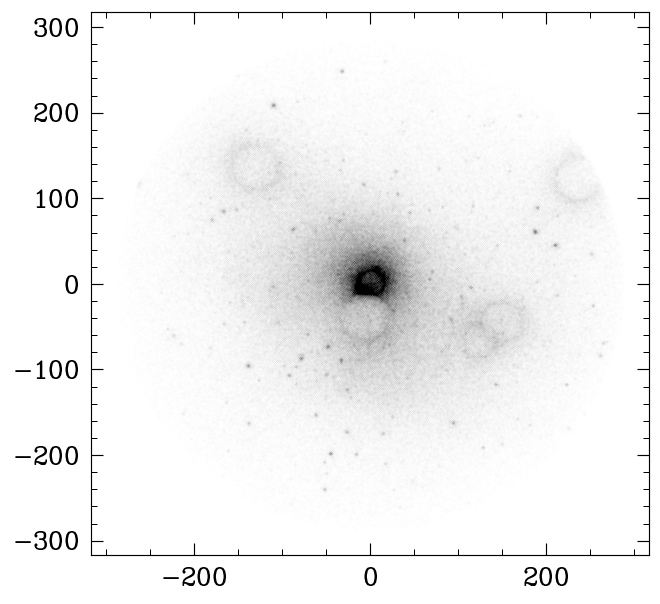

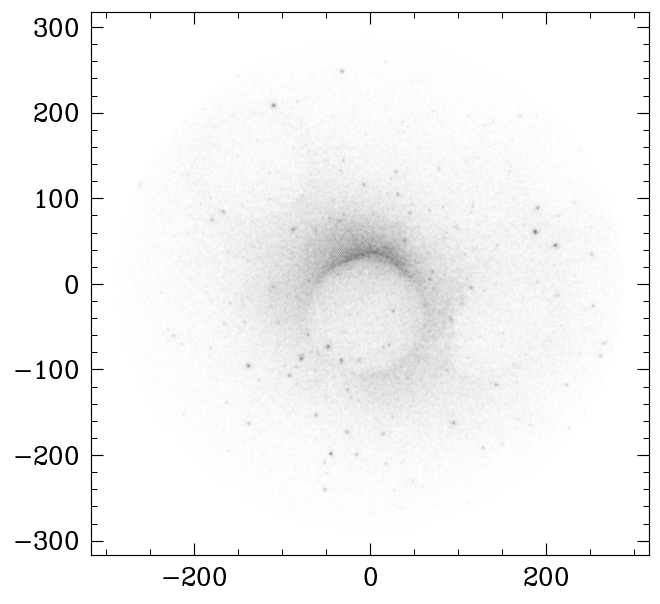

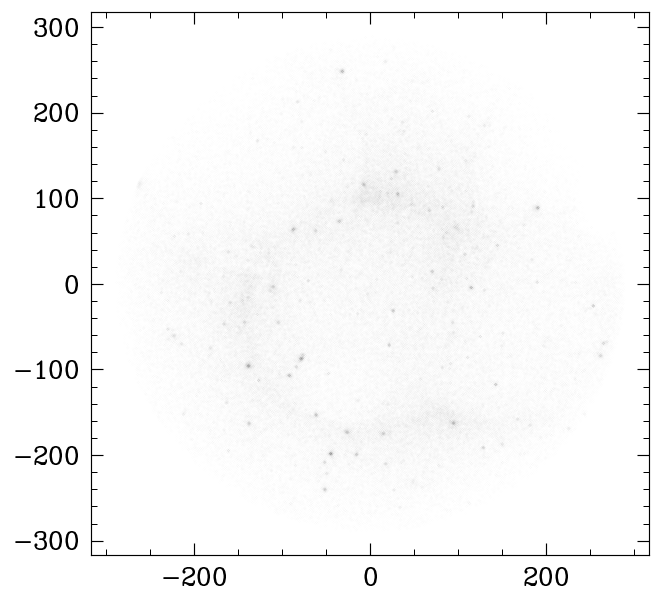

In [28]:
sample = np.random.randint(0,len(coords), 1000000)
plt.scatter(coords[sample,0], coords[sample,1], s=.1, alpha=0.01)
for f in [0, 0.15, 0.2, 0.5,1]:
    plt.figure()
    coords_excise = (coords[sample])[excise_satellites(rhf,cKDTree(coords[sample]+p[1]['posC']),star_tree,Rmax_gas=f, majormerger=0.3)]
    plt.scatter(coords_excise[:,0], coords_excise[:,1], s=.01, alpha=0.01)

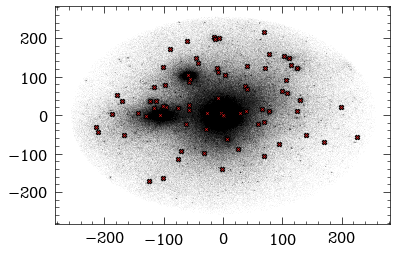

In [78]:
plt.scatter(coords_sample[:,0], coords_sample[:,1], s=.01, alpha=0.09)
plt.scatter(rhf['position_center'][rmask][rhf['mass.vir'][rmask]>1e8,0], rhf['position_center'][rmask][rhf['mass.vir'][rmask]>1e8,1], marker='X', s=20, edgecolor=None)

In [98]:
sat_mask = excise_satellites(rhf,gas_tree,star_tree)

## Mean molecular weight test

In [83]:
m13keys = {'m13h002_NoBH': 51,
'm13h007_NoBH': 60,
'm13h113_NoBH': 60,
'm13h206_NoBH': 60,
'm13h223_NoBH': 55}

In [103]:
means = []
stds = []

meansX = []
stdsX = []

for k, s in m13keys.items():
    p = load_allparticles(sim_path_fire3(PaperSimNames[k], quest=True), s, keys_to_extract={0:['Coordinates', 'Masses', 'Density', 'Temperature', 'InternalEnergy', 'CosmicRayEnergy', 'Metallicity'],1:['Coordinates', 'Masses']}, loud=0)
    mask = p[0]['r_scaled'] < 1.5
    mu_sim = p[0]['Temperature'] / (5/3-1) * 1.38e-16 / (p[0]['InternalEnergy']*1e10) / 1.67e-24
    XH = 1 - p[0]['Metallicity'][:,0] - p[0]['Metallicity'][:,1] #hydrogen mass fraction
    means.append(np.mean(mu_sim[mask]))
    stds.append(np.std(mu_sim[mask]))
    
    meansX.append(np.mean(XH[mask]))
    stdsX.append(np.std(XH[mask]))

Text(0, 0.5, '$\\mu$ ($r < 1.5 R_{\\mathrm{vir}}$)')

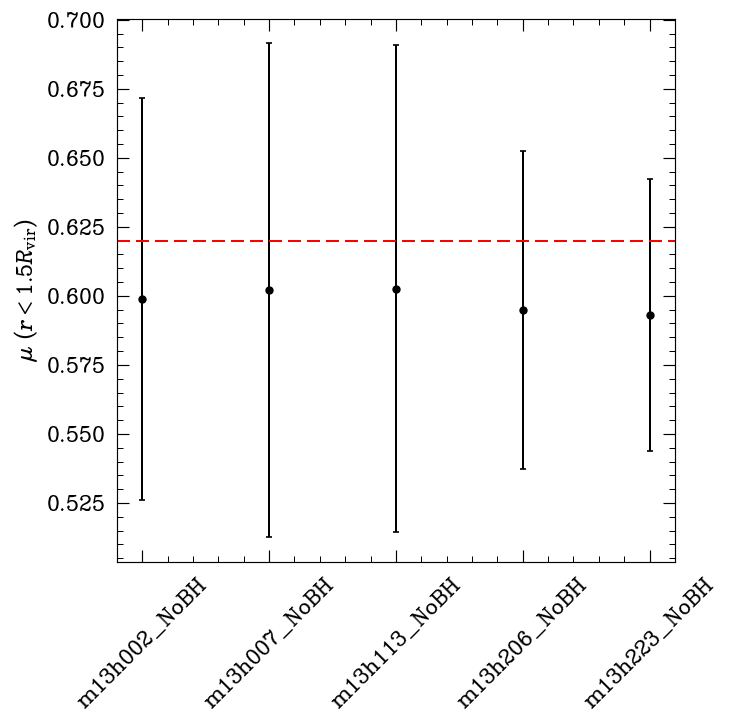

In [105]:
plt.errorbar(m13keys.keys(), means, yerr=stds, fmt='.')
plt.axhline(0.62, ls='--', c='r', label='CF constant')
plt.xticks(rotation=45)
plt.ylabel('$\mu$ ($r < 1.5 R_{\mathrm{vir}}$)')

Text(0, 0.5, '$X$ ($r < 1.5 R_{\\mathrm{vir}}$)')

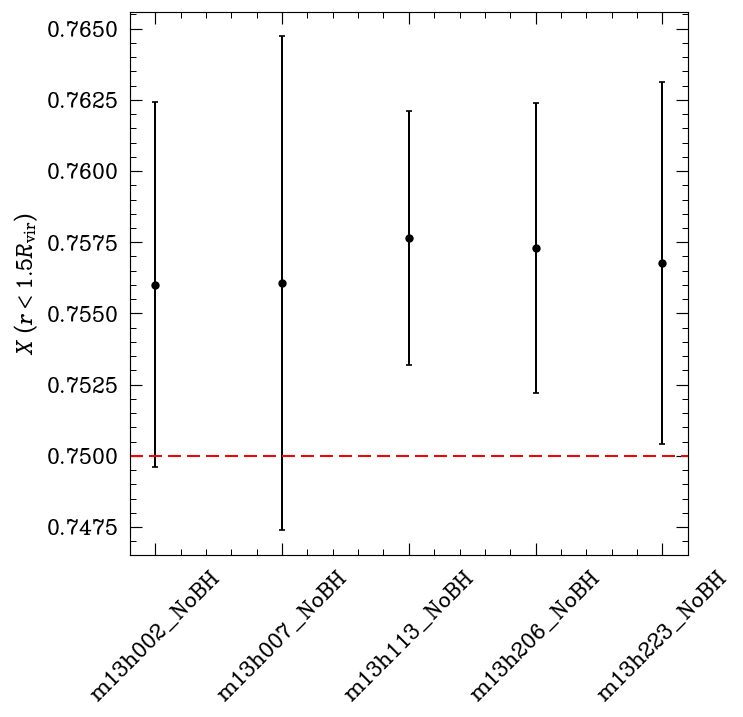

In [104]:
plt.errorbar(m13keys.keys(), meansX, yerr=stdsX, fmt='.')
plt.axhline(0.75, ls='--', c='r', label='CF constant')
plt.xticks(rotation=45)
plt.ylabel('$X$ ($r < 1.5 R_{\mathrm{vir}}$)')

Text(0, 0.5, 'number of particles ($r < 1.5 R_{\\mathrm{vir}}$)')

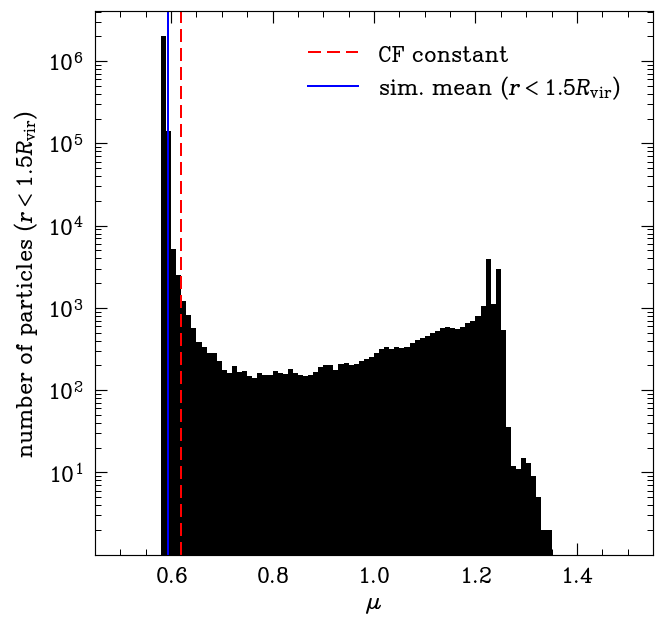

In [69]:
mask = p[0]['r_scaled'] < 1.5
mu_sim = p[0]['Temperature'] / (5/3-1) * 1.38e-16 / (p[0]['InternalEnergy']*1e10) / 1.67e-24
plt.hist(mu_sim[mask], range=(0.5,1.5), bins=100);
plt.yscale('log')
plt.axvline(0.62, ls='--', c='r', label='CF constant')


plt.axvline(np.mean(mu_sim[mask]), c='b', label='sim. mean ($r < 1.5 R_{\mathrm{vir}}$)')
plt.legend()
plt.xlabel('$\mu$')
plt.ylabel('number of particles ($r < 1.5 R_{\mathrm{vir}}$)')

Text(0, 0.5, 'number of particles ($r < 1.5 R_{\\mathrm{vir}}$)')

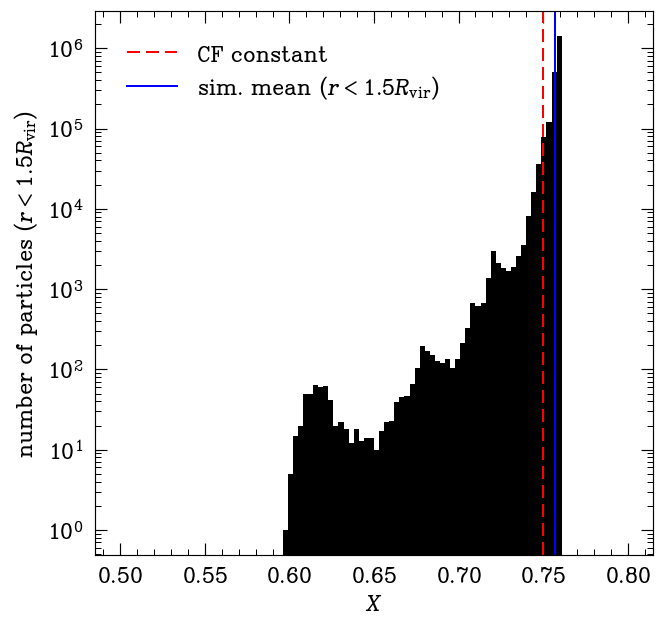

In [70]:
XH = 1 - p[0]['Metallicity'][:,0] - p[0]['Metallicity'][:,1] #hydrogen mass fraction
plt.hist(XH[mask], range=(0.5,0.8), bins=100);
plt.yscale('log')
plt.axvline(0.75, ls='--', c='r', label='CF constant')


plt.axvline(np.mean(XH[mask]), c='b', label='sim. mean ($r < 1.5 R_{\mathrm{vir}}$)')
plt.legend()
plt.xlabel('$X$')
plt.ylabel('number of particles ($r < 1.5 R_{\mathrm{vir}}$)')

## m12i FIRE-2 test

In [3]:
m12i_fire2 = Simulation(simdir='/projects/b1026/isultan/fire2_core_no_md/m12i_r57000', snapnum=600, cachesim=True)

In [2]:
m12i_fire2 = Simulation(simdir='/projects/b1026/isultan/fire2_core_no_md/m12i_r57000', snapnum=600)

In [3]:
m12i_fire2.alpha_avg

0.14354148528923077

In [7]:
Sim = m12i_fire2
Rlow, Rhigh = 0.10468750000000002, 0.10468750000000002
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc, alpha=m12i_fire2.alpha_avg)

5.506562307015115 solMass / yr
0.10468750000000002 kpc
5.441358177794046 solMass / yr


In [9]:
nH = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(0,1))
T = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(2,3))
P = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(4,5))
K = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(6,7))

Pturb = np.genfromtxt('../fig9.csv', delimiter=',')

In [15]:
nHCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(0,1))
TCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(2,3))
PCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(4,5))
KCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(6,7))

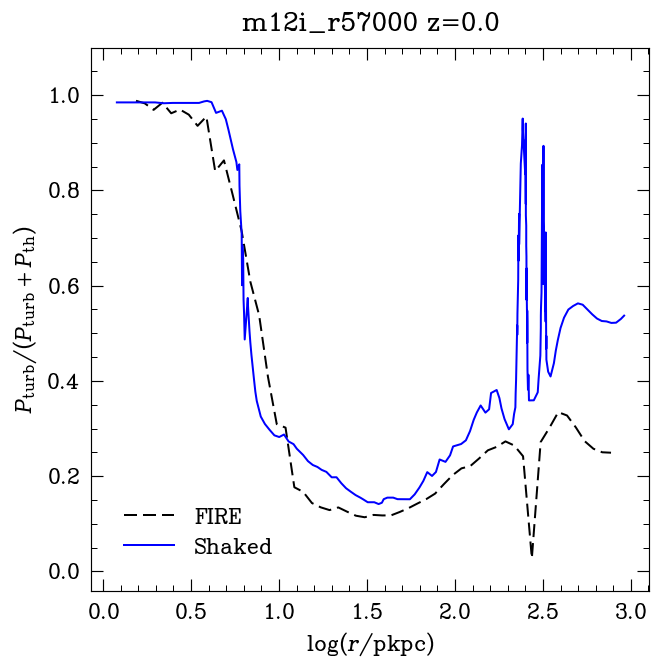

In [5]:
pro = m12i_fire2.pro
rmid = pro['rmid']*pro['Rvir']

Pturbratio = 10**pro['P_turb'] / (10**pro['P_turb'] + 10**pro['Pth_Mweighted'])
plt.plot(np.log10(rmid), Pturbratio, 'k--', label='FIRE')
plt.plot(Pturb[:,0], Pturb[:,1], 'b-', label='Shaked')

plt.xlabel('$\log (r/\mathrm{pkpc})$')
plt.ylabel('$P_{\mathrm{turb}} / (P_{\mathrm{turb}}+P_{\mathrm{th}})$')

plt.title(m12i_fire2.simname + ' ' + f'z={m12i_fire2.Redshift}')
plt.ylim((-0.04175976784173662, 1.1))
plt.legend()

In [33]:
(((un.cm**2 * un.keV)/(cons.k_B * un.K / un.cm**3 * (un.pc**3/un.Msun)**(5/3))).si)**(3/5)

<Quantity 1.17281778e-21 kg>

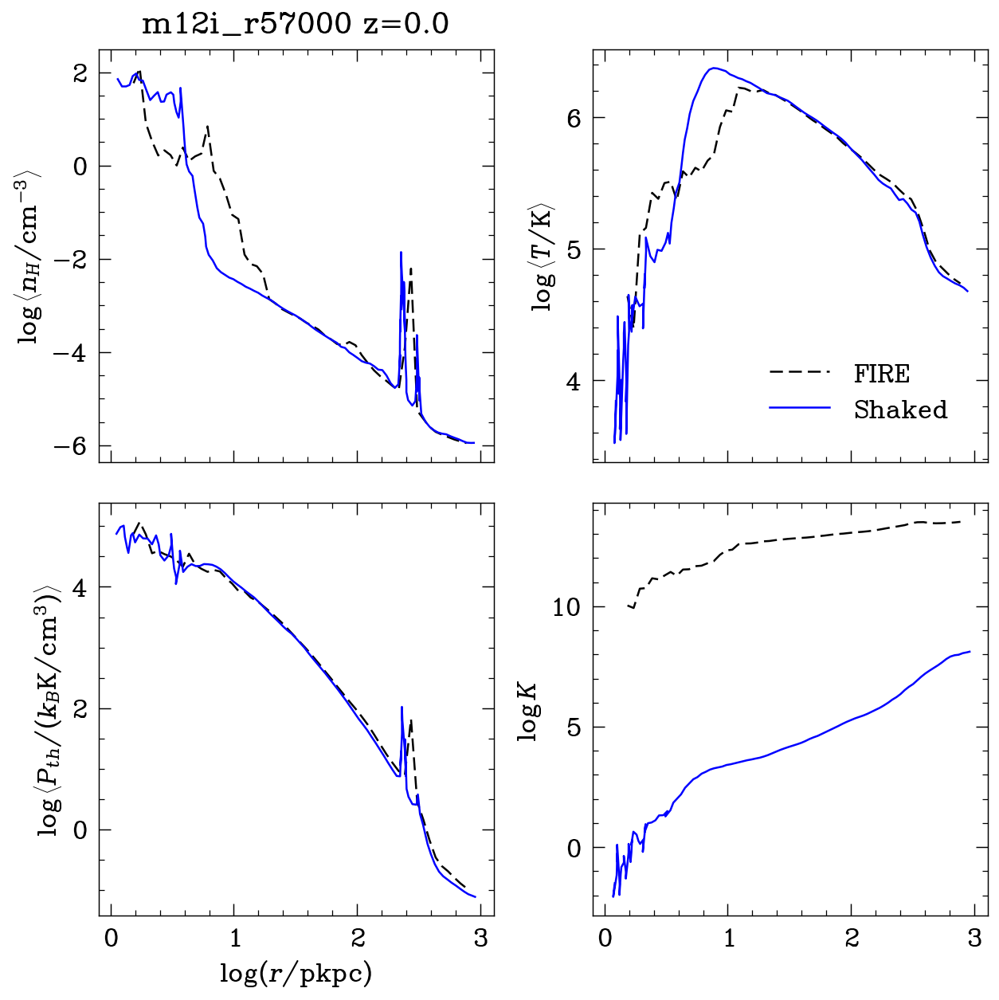

In [18]:
fig, axes = plt.subplots(2, 2, sharex=True, sharey=False, gridspec_kw={'wspace': .25, 'hspace':.1}, figsize=[4.8*2,4.8*2], dpi=150, facecolor='w')

axes[0,0].plot(np.log10(rmid), pro['nH_Mweighted'], 'k--', label='FIRE')
axes[0,0].plot(nH[:,0], nH[:,1], 'b-', label='Shaked')
axes[0,0].set_ylabel(profilelabels['nH lin'])

axes[0,1].plot(np.log10(rmid), pro['T_Mweighted'], 'k--', label='FIRE')
axes[0,1].plot(T[:,0], T[:,1], 'b-', label='Shaked')
axes[0,1].set_ylabel(profilelabels['T lin'])

axes[1,0].plot(np.log10(rmid), pro['Pth_Mweighted'], 'k--', label='FIRE')
axes[1,0].plot(P[:,0], P[:,1], 'b-', label='Shaked')
axes[1,0].set_ylabel(profilelabels['P_th lin'])

axes[1,1].plot(np.log10(rmid), pro['K_Mweighted'], 'k--', label='FIRE')
axes[1,1].plot(K[:,0], K[:,1], 'b-', label='Shaked')
axes[1,1].set_ylabel('$\log K$')

axes[1,0].set_xlabel('$\log (r/\mathrm{pkpc})$')

axes[0,0].set_title(m12i_fire2.simname + ' ' + f'z={m12i_fire2.Redshift}')
axes[0,1].legend()

In [11]:
fig, axes = makecoolingflow([res['m12i_NoBH_fire2'][-1],res['m12i_NoBH_fire2'][-1]])
axes[0,0].plot(nHCF[:,0][np.argsort(nHCF[:,0])], nHCF[:,1][np.argsort(nHCF[:,0])], 'b-', label='Shaked CF')
axes[1,0].plot(TCF[:,0][np.argsort(TCF[:,0])], TCF[:,1][np.argsort(TCF[:,0])], 'b-', label='Shaked CF')
axes[0,0].legend()

NameError: name 'res' is not defined

2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773


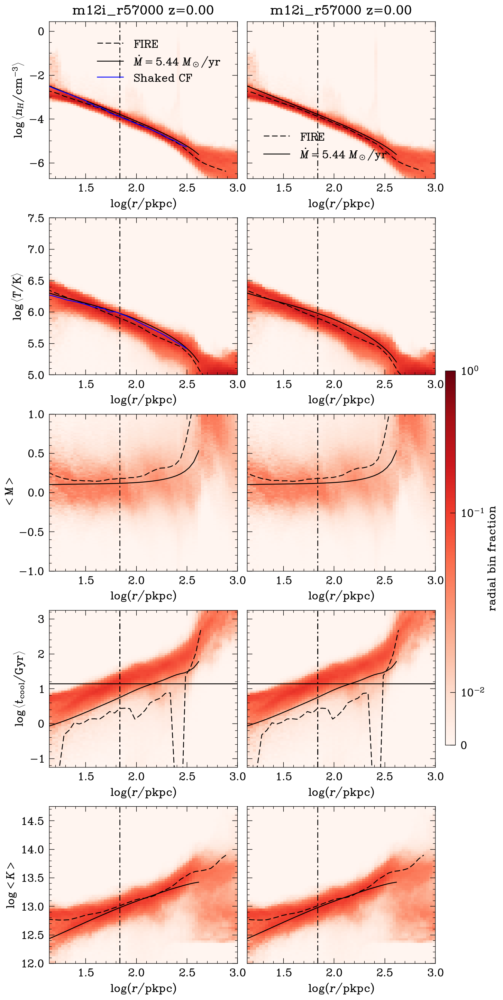

In [18]:
fig, axes = makecoolingflow([Sim,Sim])
axes[0,0].plot(nHCF[:,0][np.argsort(nHCF[:,0])], nHCF[:,1][np.argsort(nHCF[:,0])], 'b-', label='Shaked CF')
axes[1,0].plot(TCF[:,0][np.argsort(TCF[:,0])], TCF[:,1][np.argsort(TCF[:,0])], 'b-', label='Shaked CF')
axes[0,0].legend()

## CF fitting with turbulence

m12a_NoBH 0.29018540447090707
m12b_NoBH 0.12962069439673368
m12c_NoBH 0.24481934868760408
m12d_NoBH 0.8812497122871231
m12e_NoBH 0.15922379467773373
m12f_NoBH 0.41863158049815097
m12g_NoBH 0.14391533009762908
m12i_NoBH 0.13560892099374616
m12j_NoBH 0.5925660348819898
m12k_NoBH 0.14170849332726443
m12m_NoBH 0.216919894955579
m12n_NoBH 0.20929482960398263
m12q_NoBH 0.31838378251868
m12r_NoBH 1.8384553144996967
m12u_NoBH 0.22729804567697237
m12w_NoBH 0.10010001898027464
m12x_NoBH 0.21009319592022532
m12z_NoBH 0.2925866244128674
m13h002_NoBH 0.09899055483093297
m13h007_NoBH 0.24666601259506496
m13h029_NoBH 0.022105383953797672
m13h113_NoBH 0.06311094873728748
m13h206_NoBH 0.05494232637811671
m13h223_NoBH 0.08883386702746959
m13h236_NoBH 0.10937477563193561


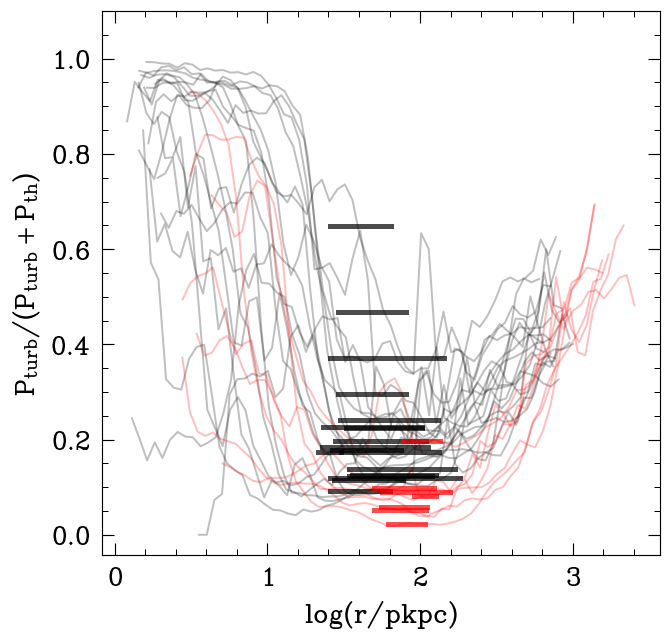

In [13]:
for k,Sim in res_cf.items(): 
#     if k not in simnames: continue
    c = 'r' if 'm13' in k else 'k'
    print( k,Sim.alpha_avg )
    
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
#     plt.figure()
    Pturbratio = 10**pro['P_turb'] / (10**pro['P_turb'] + 10**pro['P_th'])
    plt.plot(np.log10(rmid), Pturbratio, 'k-', c=c, label='FIRE', alpha=.25, zorder=0)
    
    Rmin, Rmax = np.log10(0.1 * Sim.pro['Rvir']), np.log10(Sim.Rcool)
#     plt.axhline((1+Sim.alpha_avg**-1)**-1, xmin=Rmin, xmax=Rmax)
    plt.plot((Rmin, Rmax), ((1+Sim.alpha_avg**-1)**-1, (1+Sim.alpha_avg**-1)**-1), 'k-',c=c, linewidth=3, alpha=.7, zorder=10)
#     plt.axvline(Rmin)
#     plt.axvline(Rmax)

    plt.xlabel('$\log (r/\mathrm{pkpc})$')
    plt.ylabel('$P_{\mathrm{turb}} / (P_{\mathrm{turb}}+P_{\mathrm{th}})$')

#     plt.title(k + ' ' + f'z={np.abs(Sim.Redshift):.02f} {Sim.alpha_avg:.03f}')
    plt.ylim((-0.04175976784173662, 1.1))
#     plt.legend()
# plt.savefig('../Paper2Figs/Pturbratio.pdf')

m13h002_NoBH 0.09899055483093297
m13h007_NoBH 0.24666601259506496
m13h029_NoBH 0.022105383953797672
m13h113_NoBH 0.06311094873728748
m13h206_NoBH 0.05494232637811671
m13h223_NoBH 0.08883386702746959
m13h236_NoBH 0.10937477563193561
m12a_NoBH 0.29018540447090707
m12d_NoBH 0.8812497122871231
m12e_NoBH nan
m12g_NoBH 0.14391533009762908
m12j_NoBH 0.5925660348819898
m12k_NoBH 0.14170849332726443
m12n_NoBH 0.20929482960398263
m12u_NoBH nan
m12x_NoBH 0.21009319592022532
m12b_NoBH 0.12962069439673368
m12c_NoBH 0.24481934868760408
m12f_NoBH 0.41863158049815097
m12i_NoBH 0.13560892099374616
m12m_NoBH 0.216919894955579
m12q_NoBH 0.31838378251868
m12r_NoBH 1.8384553144996967
m12w_NoBH 0.10010001898027464
m12z_NoBH 0.2925866244128674


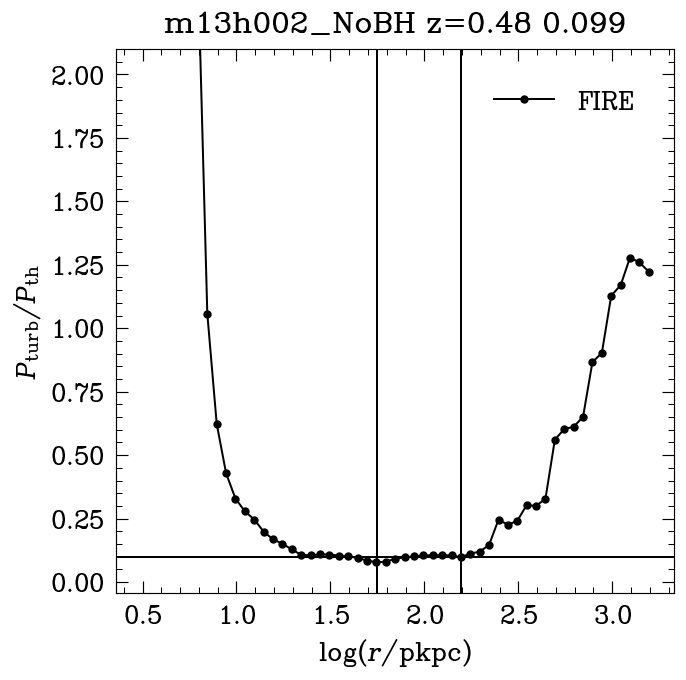

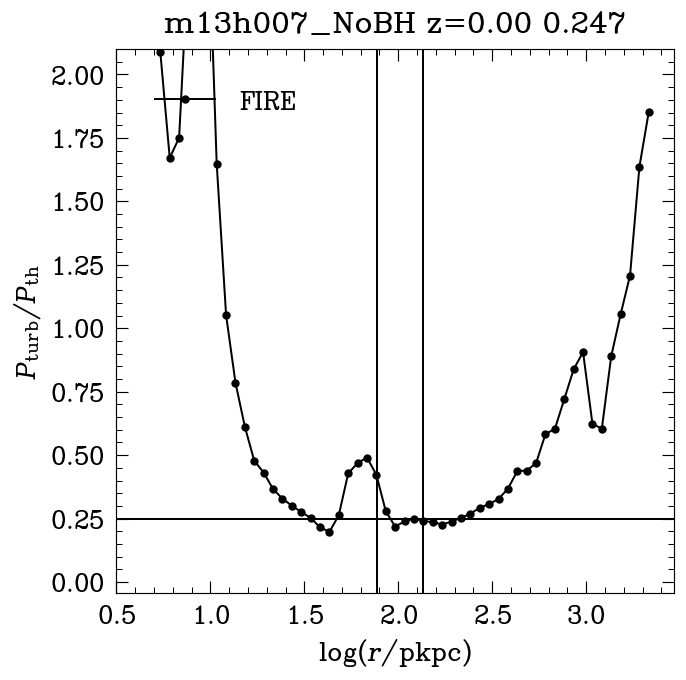

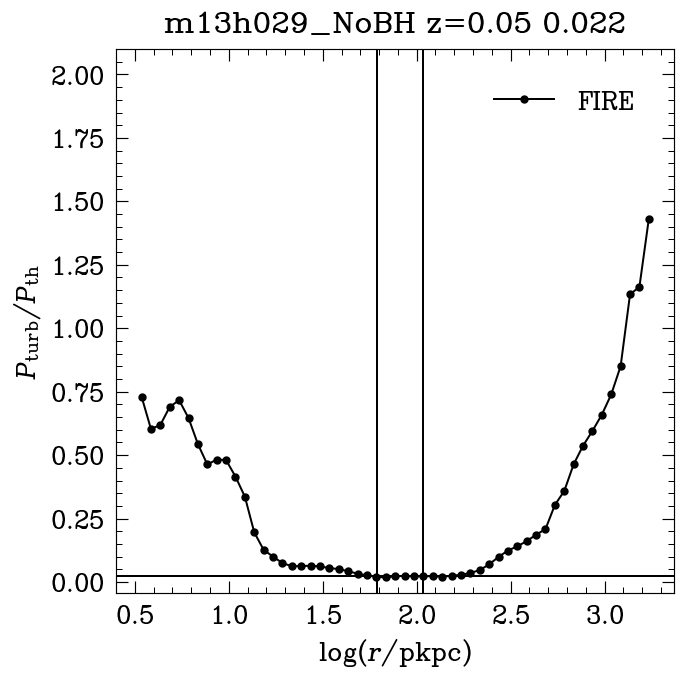

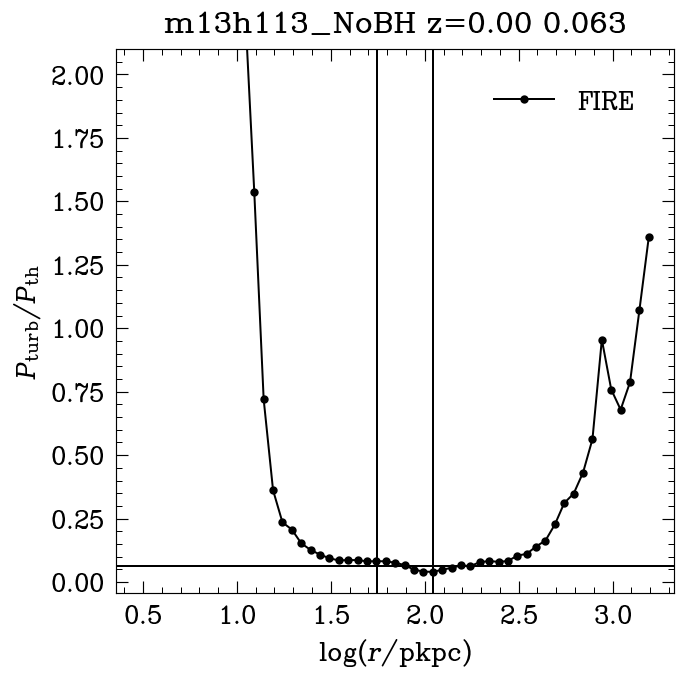

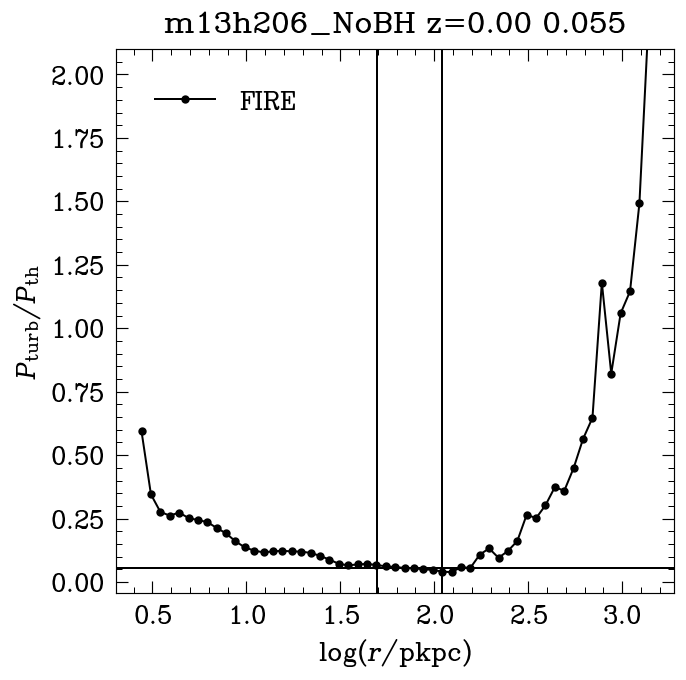

...

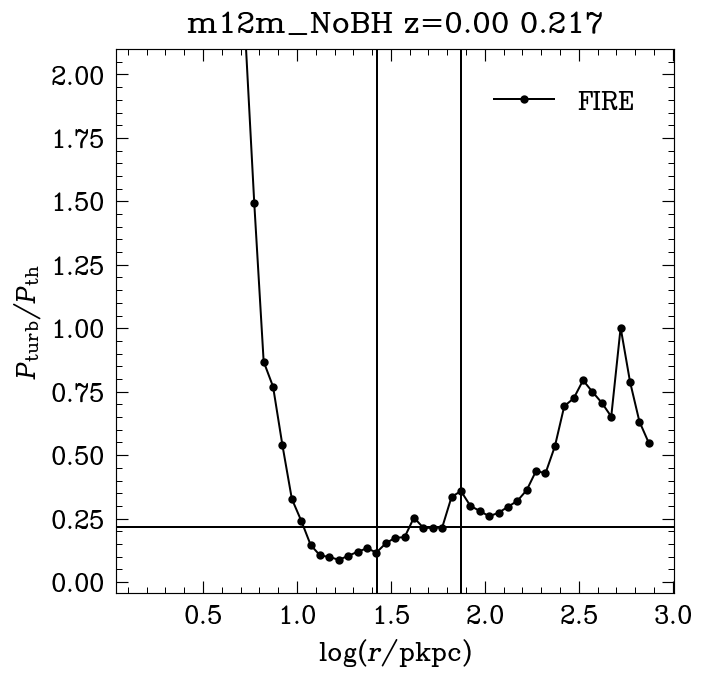

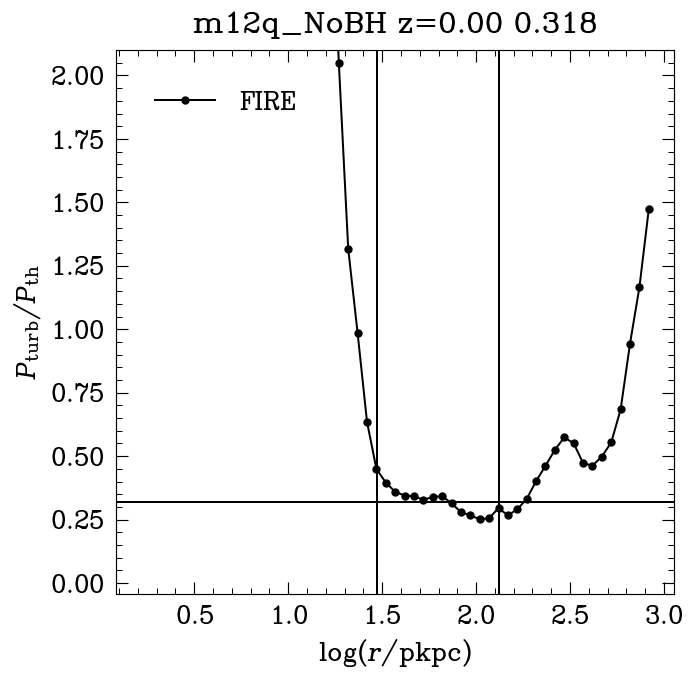

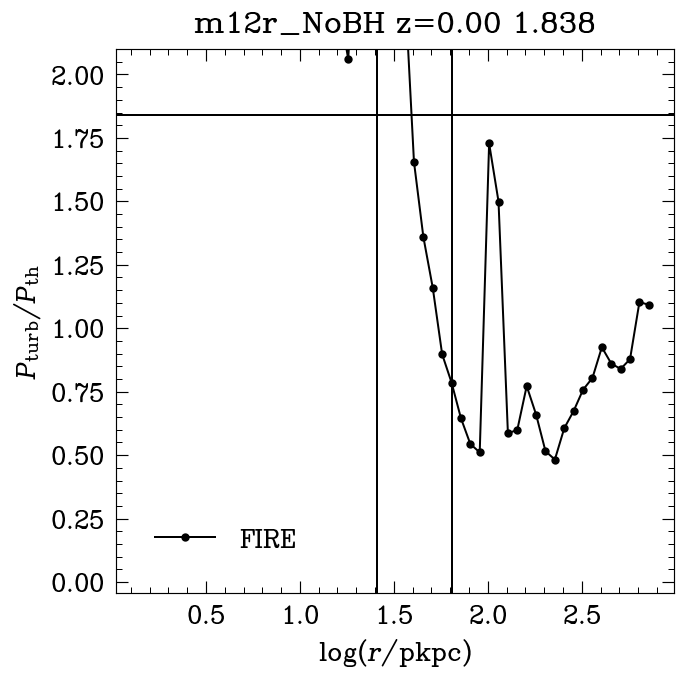

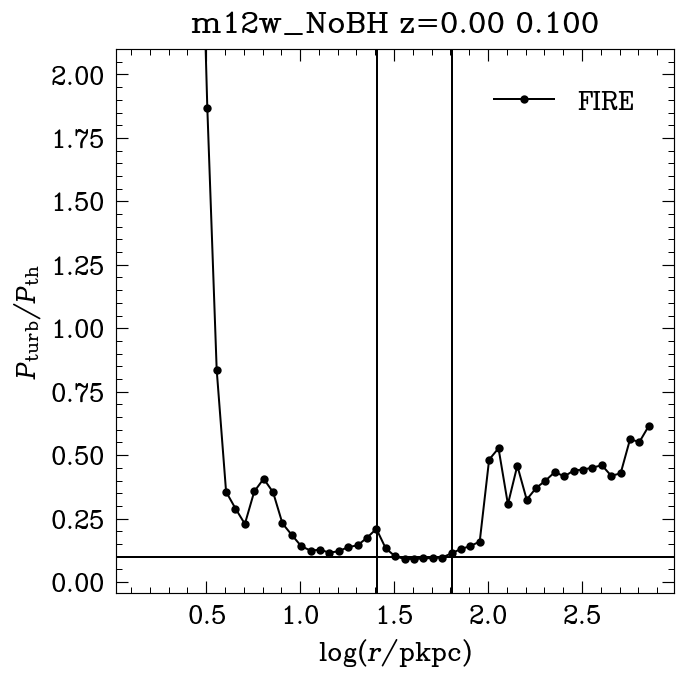

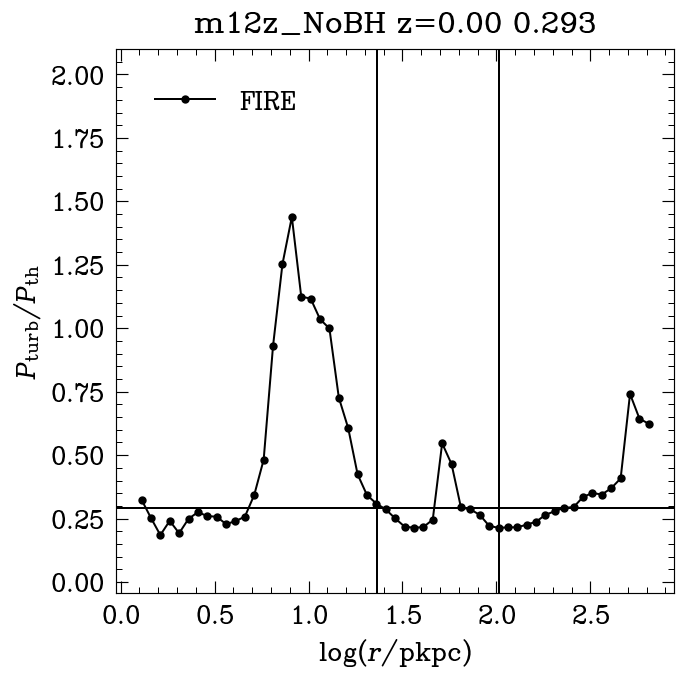

In [77]:
for k,Sim in res_cf.items(): 
    print( k,Sim.alpha_avg )
    
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
    plt.figure()
    Pturbratio = 10**pro['P_turb'] / 10**pro['P_th']
    plt.plot(np.log10(rmid), Pturbratio, 'k.-', label='FIRE')
    
    plt.axhline(Sim.alpha_avg)
    plt.axvline(np.log10(0.1 * Sim.pro['Rvir']))
    plt.axvline(np.log10(Sim.Rcool))

    plt.xlabel('$\log (r/\mathrm{pkpc})$')
    plt.ylabel('$P_{\mathrm{turb}} / P_{\mathrm{th}}$')

    plt.title(k + ' ' + f'z={np.abs(Sim.Redshift):.02f} {Sim.alpha_avg:.03f}')
    plt.ylim((-0.04175976784173662, 2.1))
    plt.legend()

In [ ]:
#log space
bins = np.logspace(-2,1,100)
simnames = sorted(['m13h007_NoBH', 'm13h002_NoBH', 'm13h223_NoBH', 'm13h113_NoBH', 'm13h206_NoBH'] + [f'm12{s}_NoBH' for s in 'fqrwzadkgjnx'])

for simname in simnames:
    Sim = res_cf[simname]
    print(simname, Sim.alpha_avg)
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)


    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc, alpha=Sim.alpha_avg)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict[simname] = reslist

In [244]:
res_cf['m12f_NoBH'].transonic_solution_fitting_turb_Rsonic

0.464158883361278

In [245]:
binstest = np.logspace(-2,3,100)
resdict_turb_m12f = CF_explore(res_cf, ['m12f_NoBH'], usealpha=True, bins = binstest)

m12f_NoBH 0.41863158049815097
Current Time = 16:42:52


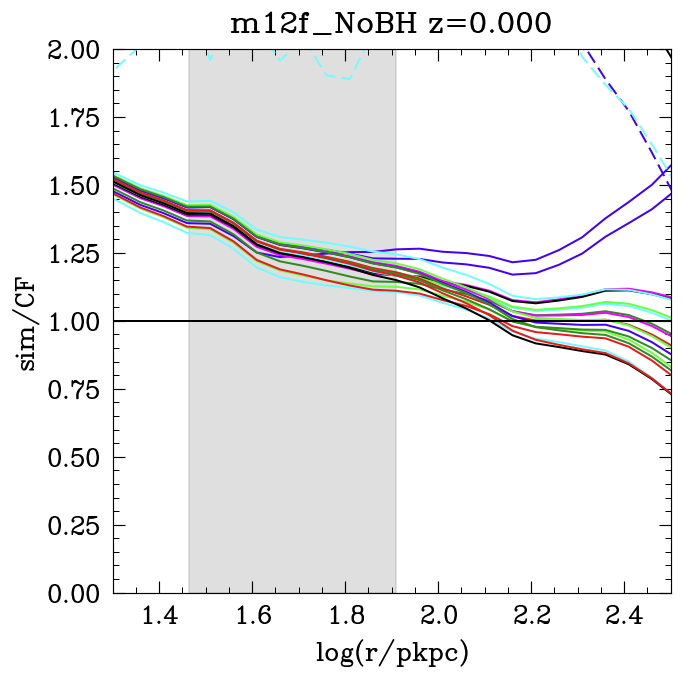

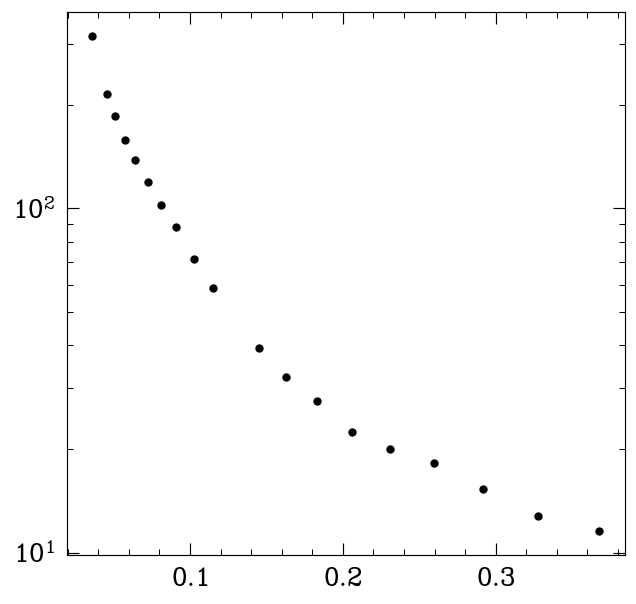

In [246]:
CF_fitting(resdict_turb_m12f, res_cf, tsstr='transonic_solution_fitting_turb', bins = binstest)

In [ ]:
resdict_turb = CF_explore(res_cf, simnames, usealpha=True)

m12a_NoBH 0.29018540447090707
Current Time = 23:40:37


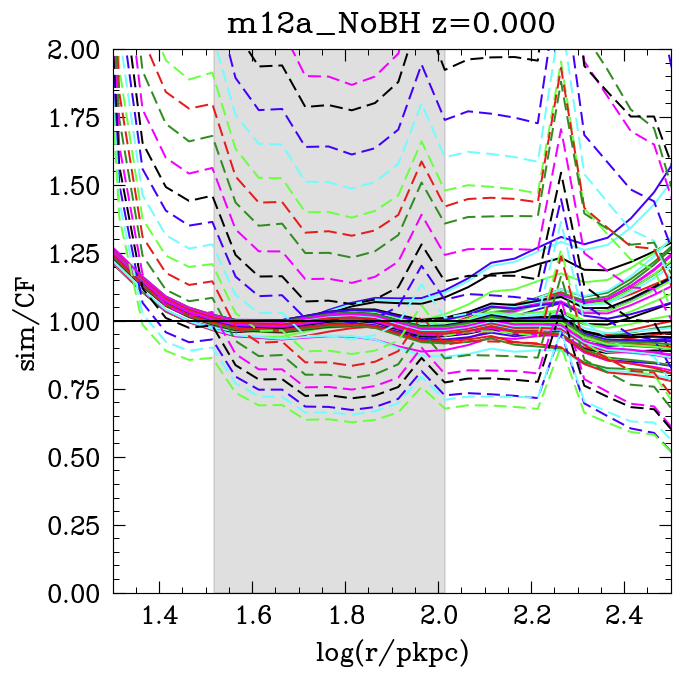

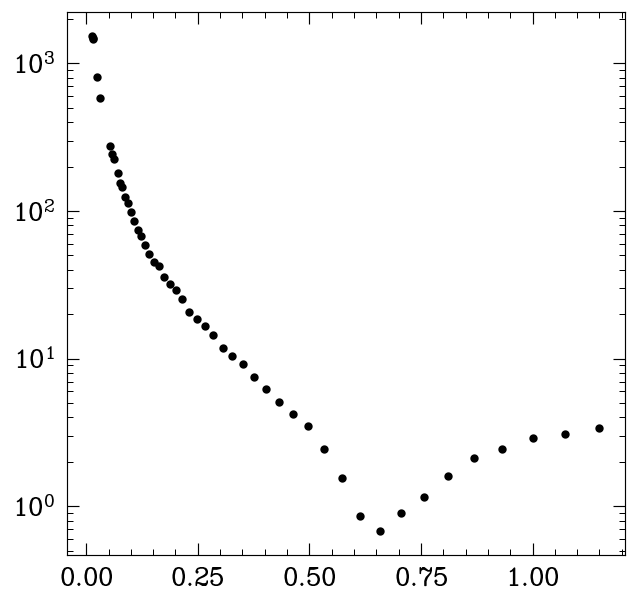

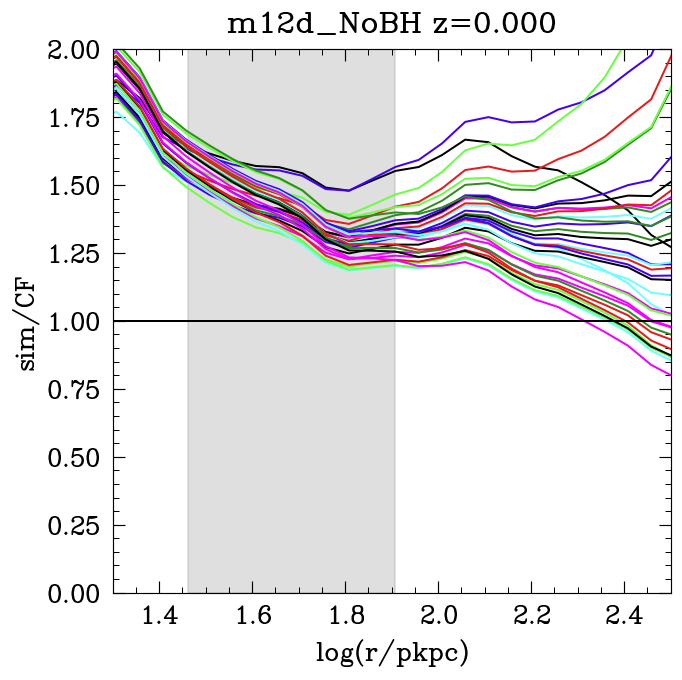

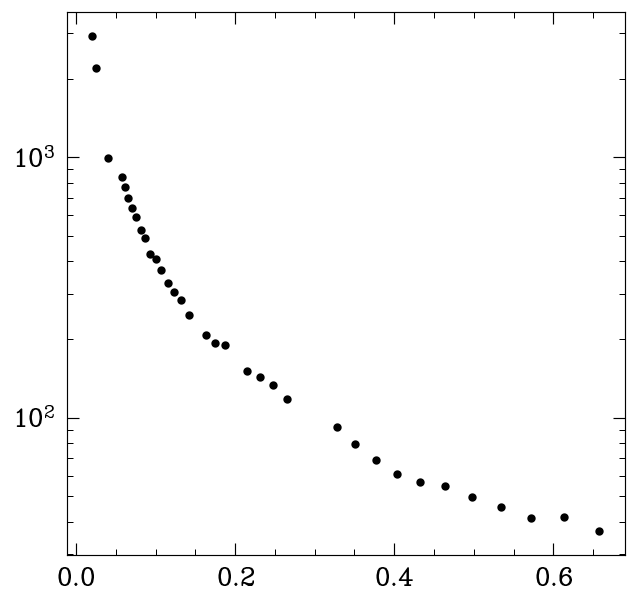

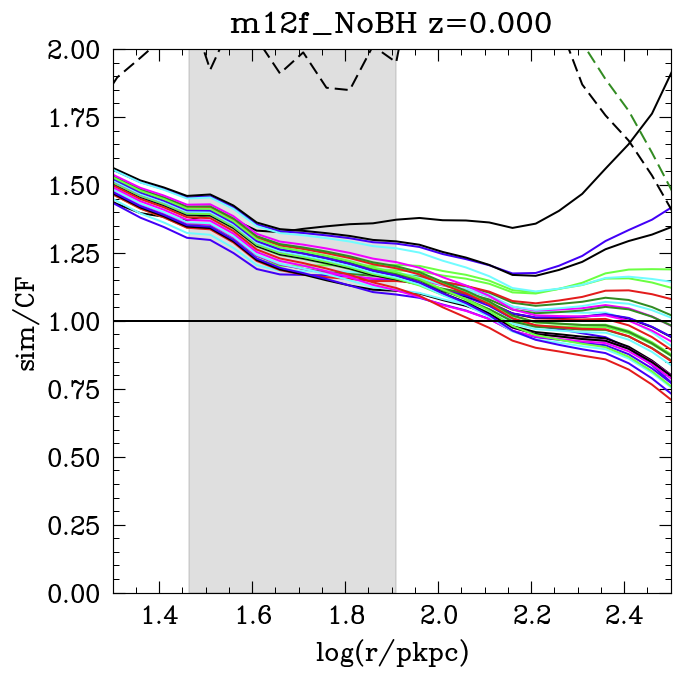

...

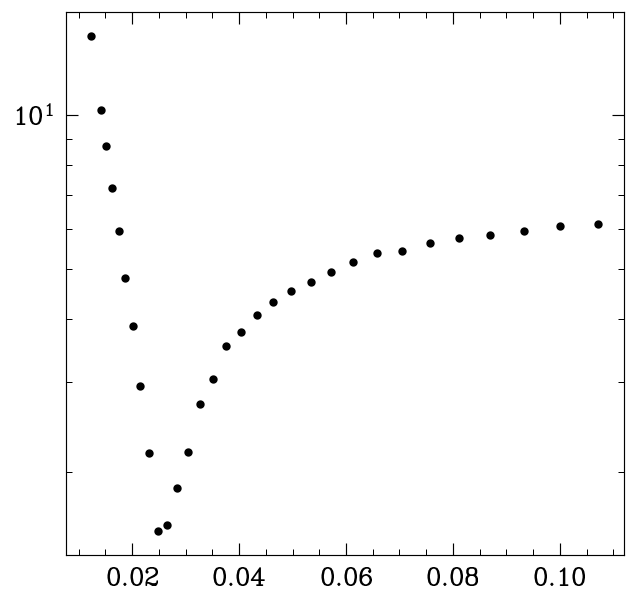

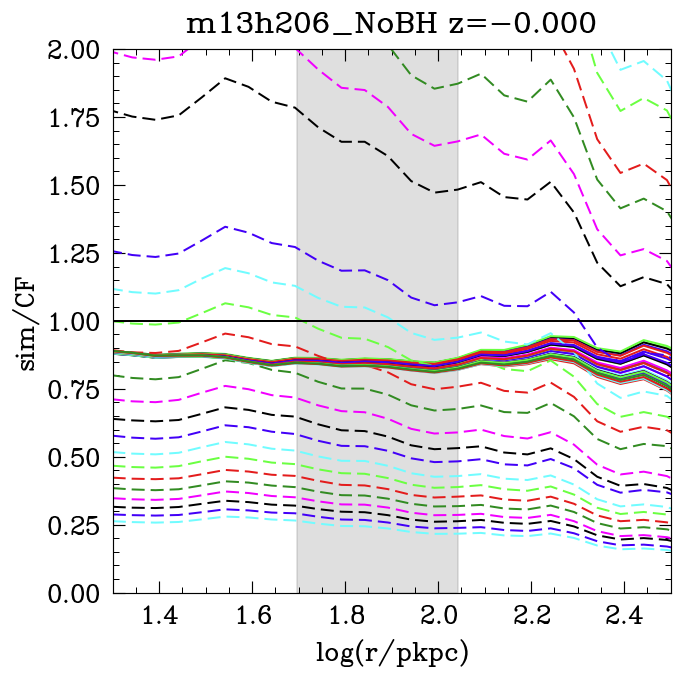

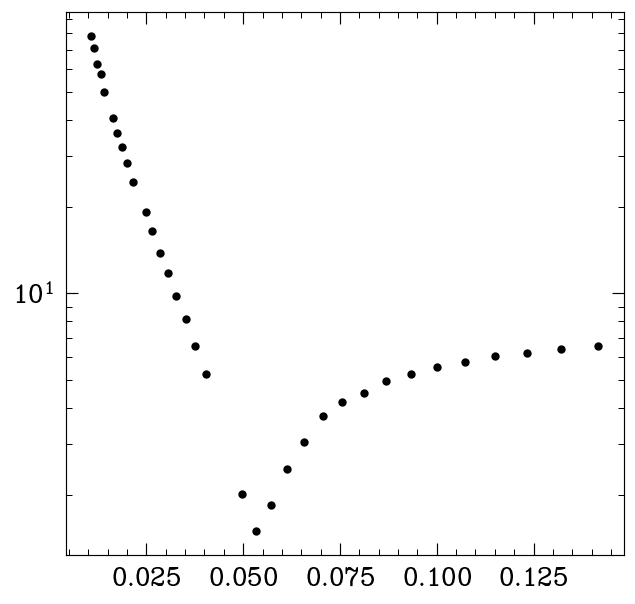

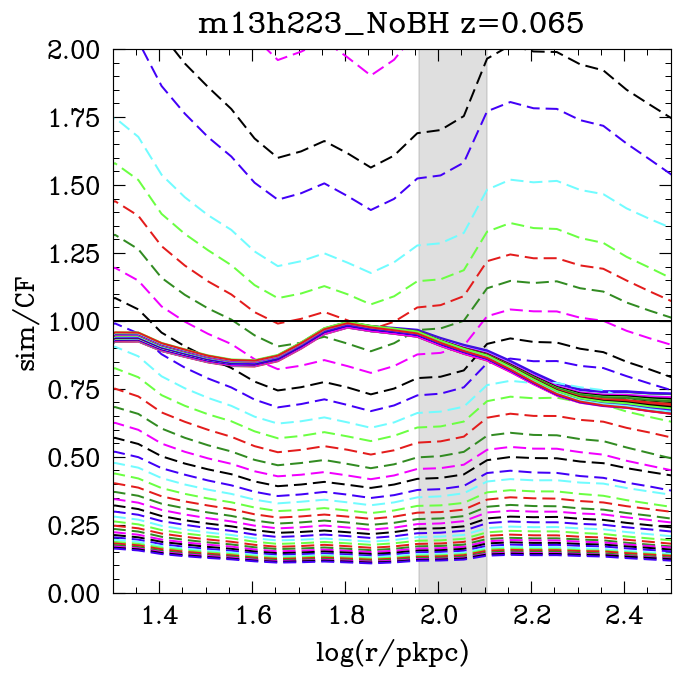

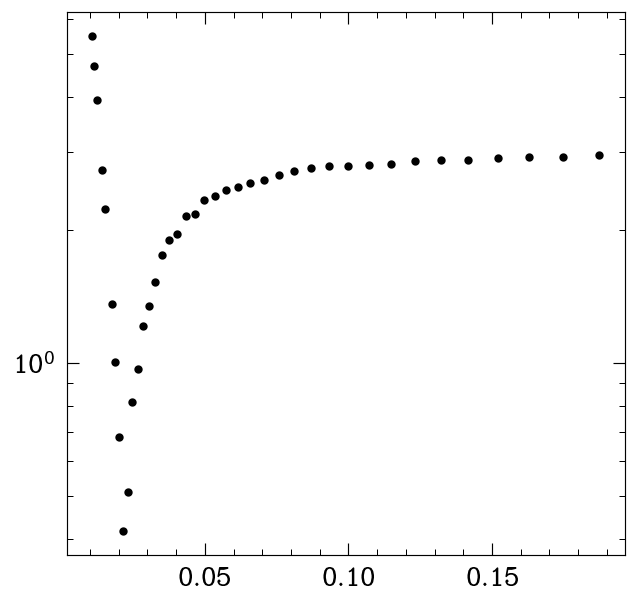

In [49]:
CF_fitting(resdict_turb, res_cf, tsstr='transonic_solution_fitting_turb')

In [18]:
for k,Sim in res_cf.items():
    try:
        print(k,Sim.transonic_solution_fitting_turb.R_sonic(), Sim.transonic_solution_fitting_turb_Rsonic)
    except:
        pass

m12a_NoBH [0.65727529] kpc 0.6579332246575682
m12d_NoBH None 0.6579332246575682
m12f_NoBH [0.37611709] kpc 0.37649358067924676
m12g_NoBH [0.14160567] kpc 0.14174741629268056
m12j_NoBH [0.24745993] kpc 0.24770763559917114
m12k_NoBH [0.21522803] kpc 0.21544346900318845
m12n_NoBH None 0.533669923120631
m12q_NoBH [0.65727529] kpc 0.6579332246575682
m12r_NoBH [0.16281211] kpc 0.16297508346206444
m12w_NoBH [0.61297714] kpc 0.6135907273413173
m12x_NoBH None 0.533669923120631
m12z_NoBH [5.33136253] kpc 5.336699231206313
m13h002_NoBH [0.03050802] kpc 0.030538555088334154
m13h007_NoBH [0.07557069] kpc 0.07564633275546291
m13h113_NoBH [0.02474599] kpc 0.024770763559917114
m13h206_NoBH [0.05331363] kpc 0.0533669923120631
m13h223_NoBH None 0.021544346900318846


m12a_NoBH 8.909324851980331 solMass / yr 9.737026493864018 solMass / yr
m12d_NoBH 0.6447643473802606 solMass / yr 10.165591580928277 solMass / yr
m12f_NoBH 0.8318935249009726 solMass / yr 3.728708428482426 solMass / yr
m12g_NoBH 9.300824879312014 solMass / yr 12.903618141877226 solMass / yr
m12j_NoBH 0.4416858661355851 solMass / yr 4.874841106103997 solMass / yr
m12k_NoBH 10.39551278712148 solMass / yr 14.560494454234206 solMass / yr
m12n_NoBH 5.286143650756095 solMass / yr 5.769726784594694 solMass / yr
m12q_NoBH 4.971247347789082 solMass / yr 2.89507912134337 solMass / yr
m12r_NoBH 0.0034831512574046205 solMass / yr 2.4457094288286307 solMass / yr
m12w_NoBH 0.2817881990057554 solMass / yr 0.2590367084647908 solMass / yr
m12x_NoBH 0.10248300277289922 solMass / yr 0.09809815201343872 solMass / yr
m12z_NoBH 5.9546789646034 solMass / yr 1.5432598060619729 solMass / yr
m13h002_NoBH 73.3130319569708 solMass / yr 115.39914814947213 solMass / yr
m13h007_NoBH 75.89486714562447 solMass / yr 62

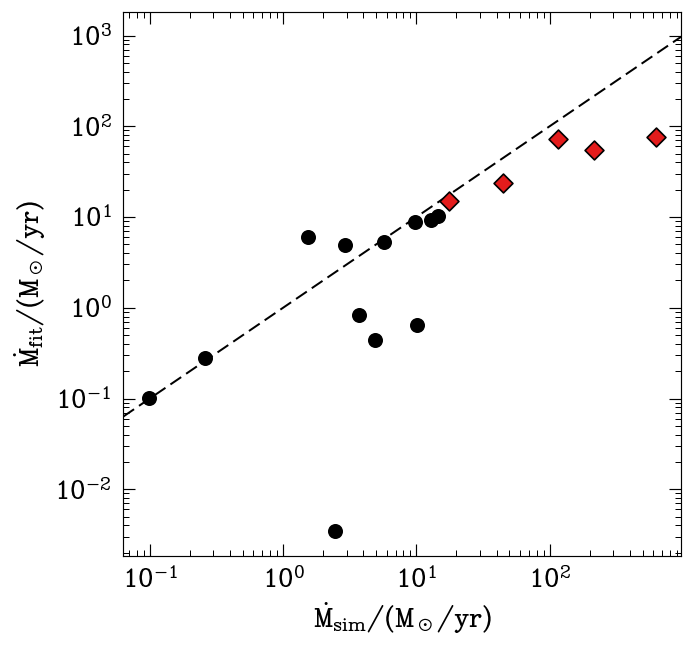

In [53]:
Mdotsp = []
for k,Sim in res_cf.items():
    if hasattr(Sim, 'transonic_solution_fitting_turb'):
        print(k,Sim.transonic_solution_fitting_turb.Mdot, Sim.Mdot_avg)
        Mdotsp.append((k,Sim.transonic_solution_fitting_turb.Mdot.value, Sim.Mdot_avg.value))
plt.scatter([r[2] for r in Mdotsp if 'm12' in r[0]], [r[1] for r in Mdotsp if 'm12' in r[0]], marker='o', alpha=1, zorder=2)
plt.scatter([r[2] for r in Mdotsp if 'm13' in r[0]], [r[1] for r in Mdotsp if 'm13' in r[0]], marker='D', alpha=1, zorder=2)

plt.xscale('log')
plt.yscale('log')
xlim = plt.xlim()
plt.plot(xlim, xlim, '--', zorder=1)
plt.xlim(xlim)
# plt.ylim(xlim)

plt.xlabel('$\dot{{M}}_{sim}/(M_\odot/\mathrm{{yr}})$')
plt.ylabel('$\dot{{M}}_{fit}/(M_\odot/\mathrm{{yr}})$')
plt.savefig('../Paper2Figs/Mdot_turb_fitTnH.pdf') #Mdot scatter for CF with turbulence

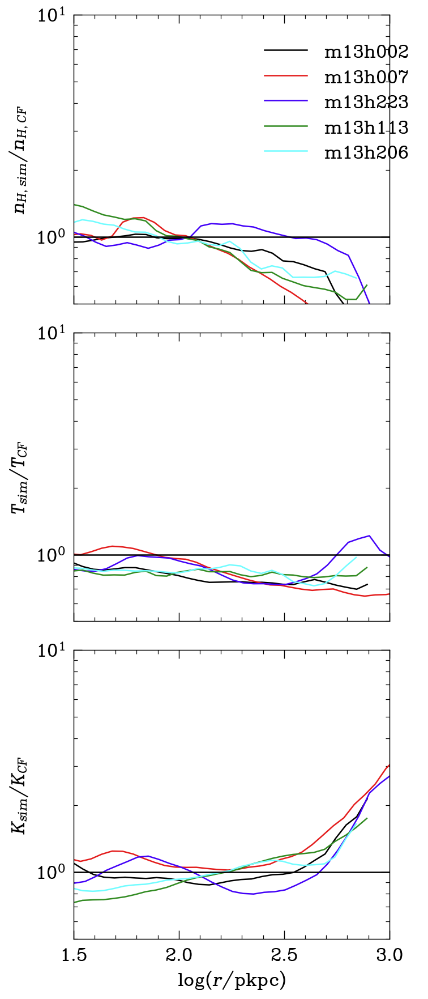

In [107]:
makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])

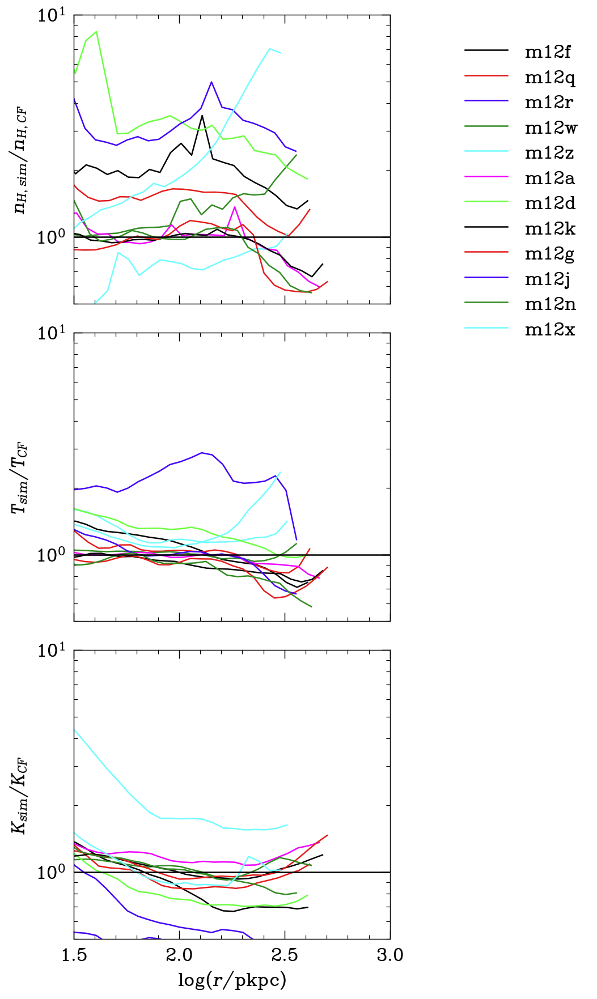

In [108]:
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])

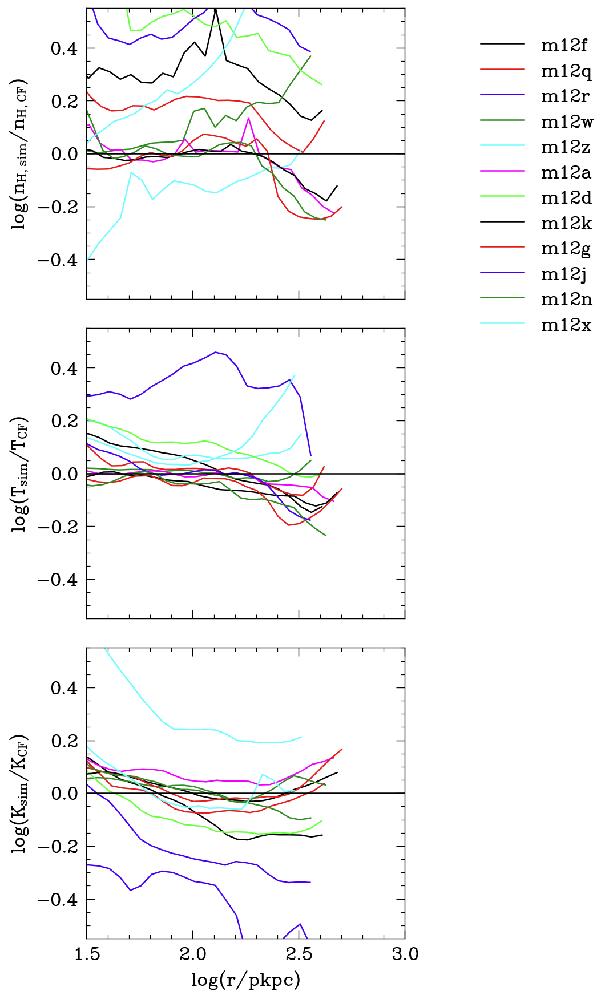

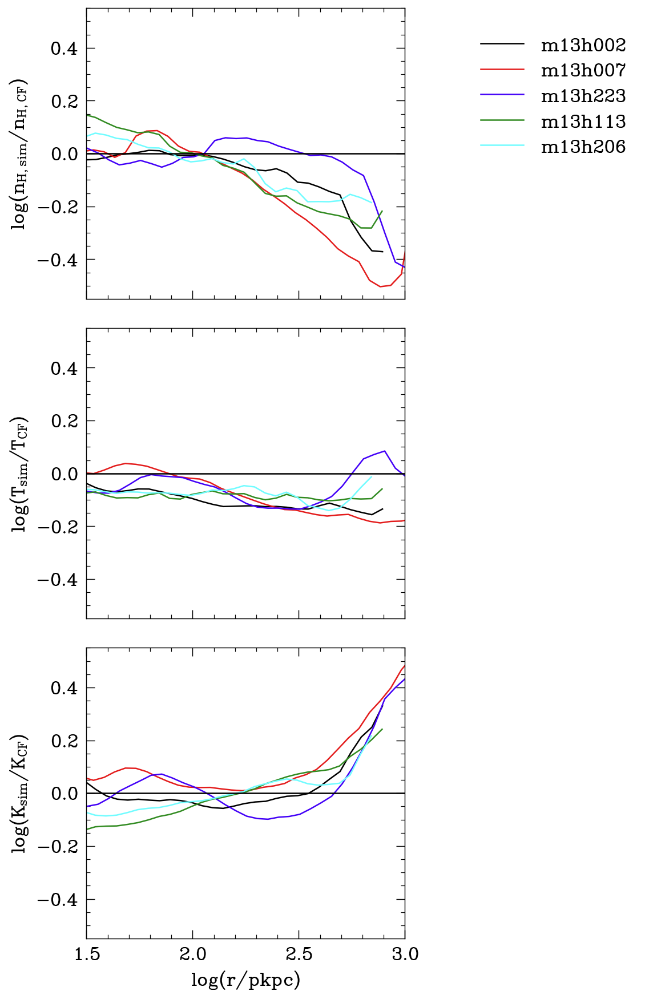

In [52]:
### Paper: Fitting ###
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']], tsstr='transonic_solution_fitting_turb')
plt.savefig('../Paper2Figs/CFratios_turb_fitTnH_m12_log.pdf')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']], tsstr='transonic_solution_fitting_turb')
plt.savefig('../Paper2Figs/CFratios_turb_fitTnH_m13_log.pdf')

## CF fitting with turbulence: AGN sims

In [55]:
PaperSimNames_AGN = PaperSimNames = {'m12f_NoBH': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12f_BH': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
 'm12f_BHCR': 'm12f_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
 'm12q_NoBH': 'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12q_BH': 'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
 'm12q_BHCR': 'm12q_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
 'm13h113_NoBH': 'm13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h113_BH': 'm13h113_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e-4_gacc31_fa0.5',
 'm13h113_BHCR': 'm13h113_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
 'm13h206_NoBH': 'm13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h206_BH': 'm13h206_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp3e-4_gacc31_fa0.5',
 'm13h206_BHCR': 'm13h206_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000'}

# {'m12f_BH': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
#  'm12f_BHCR': 'm12f_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
#  'm12q_BH': 'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
#  'm12q_BHCR': 'm12q_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
#  'm13h113_BH': 'm13h113_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e-4_gacc31_fa0.5',
#  'm13h113_BHCR': 'm13h113_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
#  'm13h206_NoBH': 'm13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
#  'm13h206_BH': 'm13h206_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp3e-4_gacc31_fa0.5',
#  'm13h206_BHCR': 'm13h206_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000'}

In [56]:
# Load snapshots from z=0.5 to 0
res_AGN = {}
for k,v in PaperSimNames_AGN.items():
    snaps = sorted([int(f.split('_')[-1].split('.')[0]) for f in os.listdir(d) if v in f])
    snaps = np.intersect1d(snaps, np.arange(259, 501)) if snaps[-1]>100 else np.intersect1d(snaps, np.arange(50, 61))
    print(k, v)
    print(snaps[-1])
    print()
    res_AGN[k] = Simulation(sim_path_fire3(v), snaps[-1])

m12f_NoBH m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
500

m12f_BH m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
500

Rcool not defined, set to 0.5*Rvir m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
m12f_BHCR m12f_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000
60

m12q_NoBH m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
500

m12q_BH m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
303

Rcool not defined, set to 0.5*Rvir m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
m12q_BHCR m12q_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000
60

m13h113_NoBH m13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
60

m13h113_BH m13h113_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e-4_gacc31_fa0.5
364

m13h113_BHCR m13h113_m3e5_MHDCRspec1_fir

In [46]:
resdict_AGN = {}

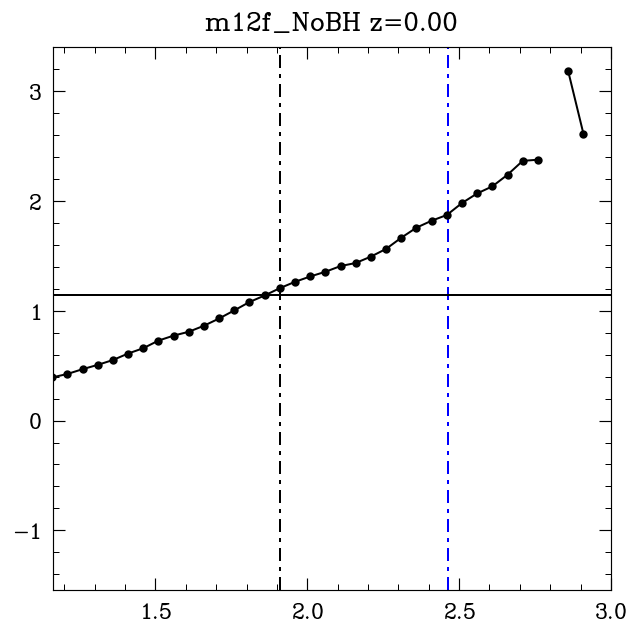

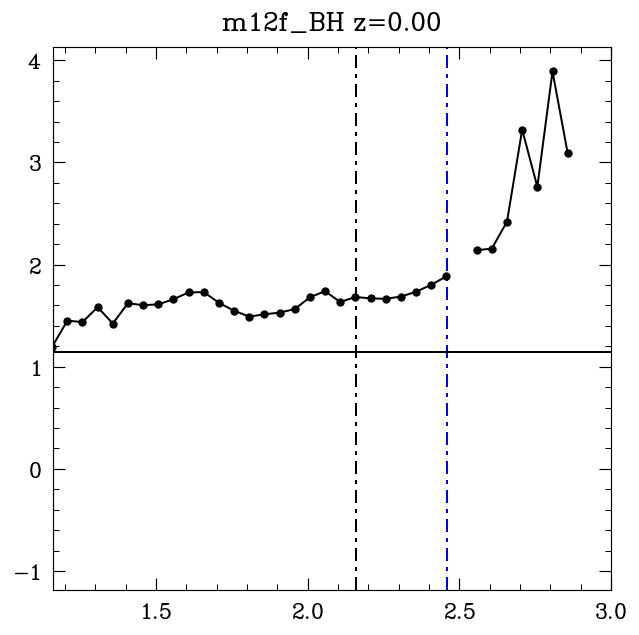

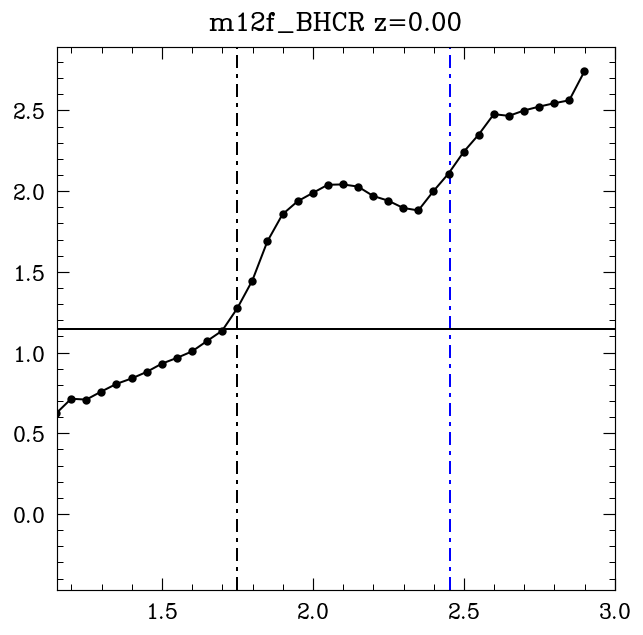

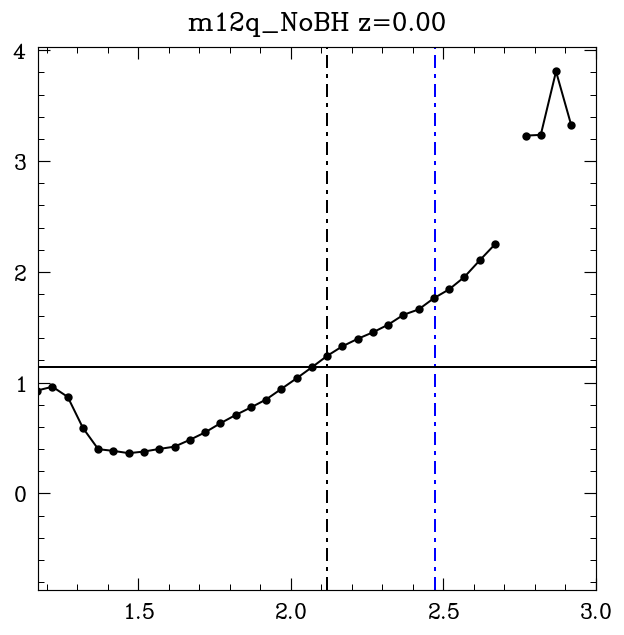

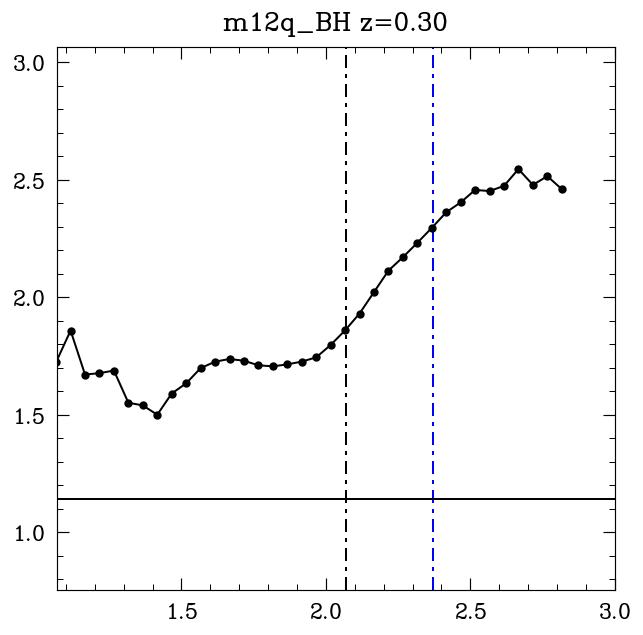

...

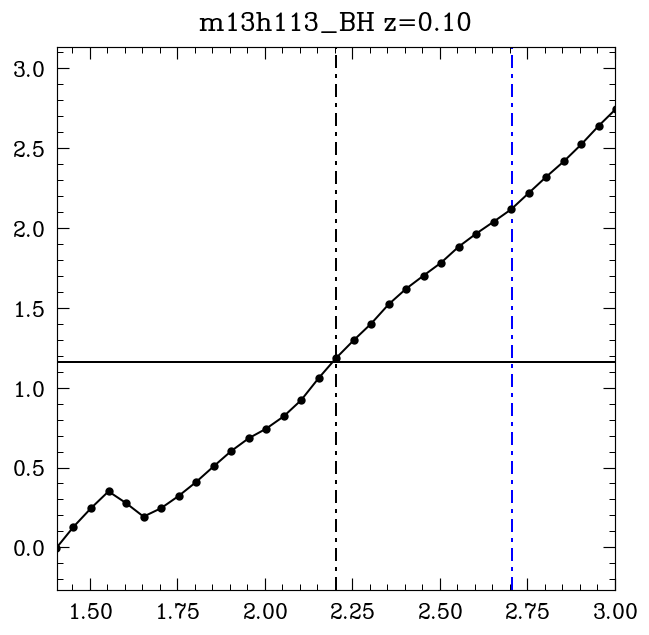

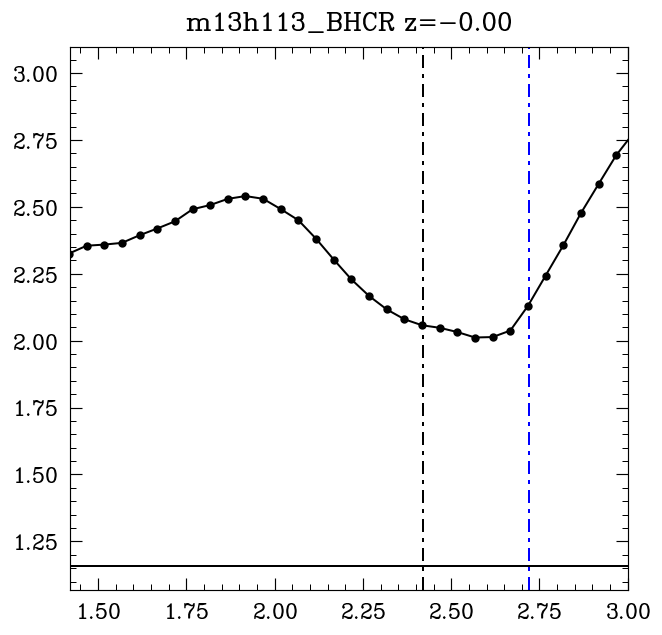

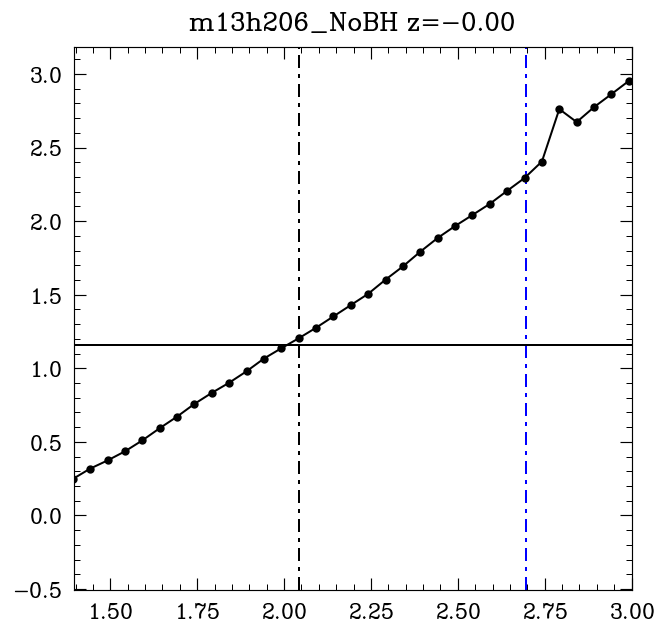

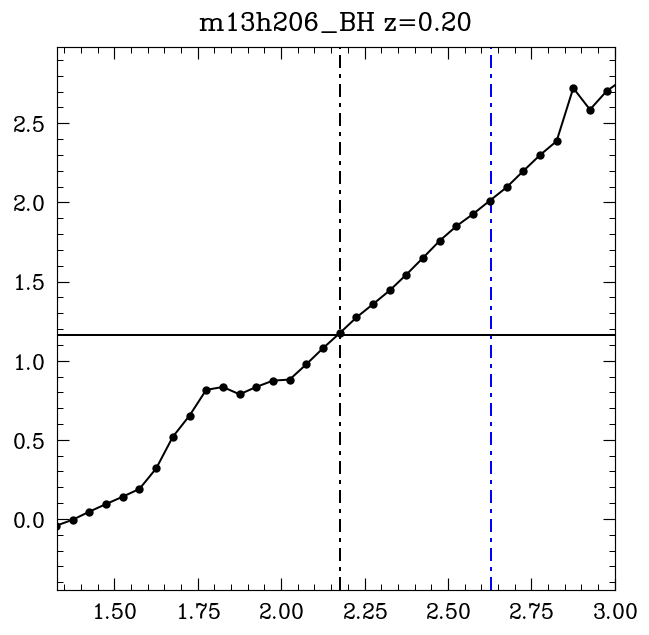

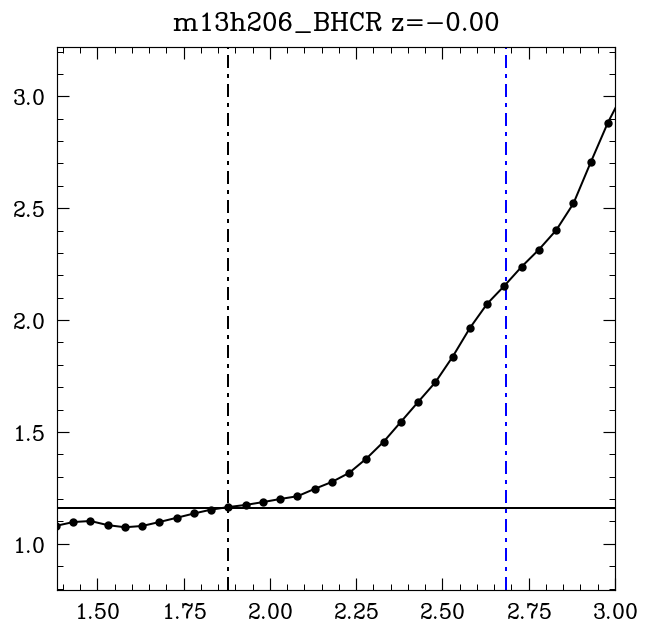

In [7]:
for simname in res_AGN.keys():
    Sim = res_AGN[simname]
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
    plt.figure()
    plt.axvline(np.log10(Sim.Rcool), c='k', ls='-.')
    plt.axvline(np.log10(pro['Rvir']), c='b', ls='-.')
    plt.axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
    plt.xlim(np.log10(0.05*pro['Rvir']), 3)
    plt.plot(np.log10(rmid), pro['tcool'], 'k.-', label='FIRE')
    plt.title(f'{simname} z={Sim.Redshift[()]:.2f}')

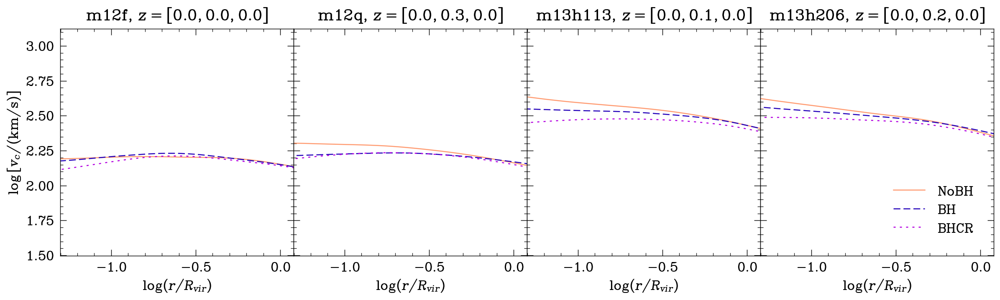

In [21]:
def makevc(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], fname=None):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey=True, gridspec_kw={'wspace': .0, 'hspace':.04}, figsize=[4.8*len(sims),4.8*1], dpi=150, facecolor='w')
    R_min = 10**-1*un.kpc
    R_max = 10**3*un.kpc
    xarr = np.logspace(np.log10(R_min.to(un.kpc).value), np.log10(R_max.to(un.kpc).value), 100) * un.kpc
    for i,sim in enumerate(sims):
            zs = []
            for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
                Sim = res_cf[model]
                zs.append(Sim.Redshift[()])
                axes[i].plot(np.log10(xarr.value/Sim.pro['Rvir']), np.log10(Sim.potential.vc(xarr).value), ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
                # axes[i].axvline(np.log10(Sim.potential.get_Rcirc().value), label='$R_{circ}$', c='k')
            axes[i].set_title(f'{sim}, $z={[abs(round(z,2)) for z in zs]}$')
    axes[-1].legend(loc=4)
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')#ax.set_xlabel(r'$\log (r/\mathrm{pkpc})$')
    axes[0].set_ylabel(r'$\log \left[ v_c/(\mathrm{km/s}) \right]$')
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))
    if fname: plt.savefig(fname)
makevc(res_AGN, fname='../Paper2Figs/vc_mainsims.pdf')

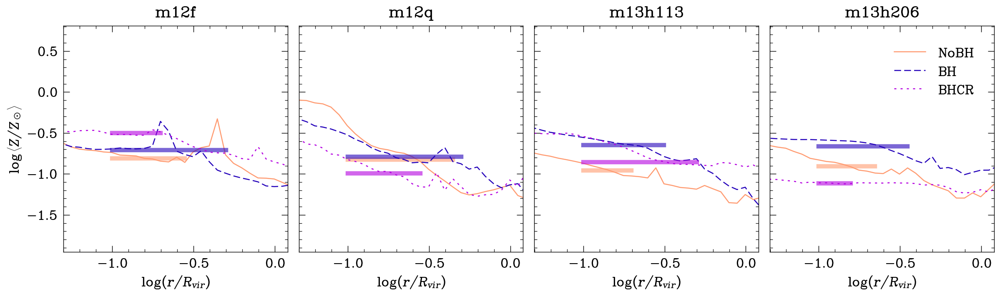

In [22]:
def makeZprofile(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], 
                 fname=None,
                 prolabels = ['Z_Mweighted'],
                 ylabels = [profilelabels['Z lin']]):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
    for i,sim in enumerate(sims):
        axes[i].set_title(sim)
        for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
            Sim = res_cf[model]
            for j, (ylabel, prolabel) in enumerate(zip(ylabels, prolabels)):
                axes[i].plot(np.log10(Sim.pro['rmid']), Sim.pro[prolabel], ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
                axes[0].set_ylabel(ylabel)
#             axes[i].axhline(np.log10(Sim.Z2Zsun), c=COLOR_SCHEME[mi-1], ls=ls, lw=1)
            axes[i].plot((np.log10(0.1), np.log10(Sim.Rcool/Sim.pro['Rvir'])), (np.log10(Sim.Z2Zsun), np.log10(Sim.Z2Zsun)), '-', c=COLOR_SCHEME[mi-1], lw=5, alpha=0.6)
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
    axes[-1].legend()
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))

    if fname: plt.savefig(fname)
makeZprofile(res_AGN, fname='../Paper2Figs/Zprofiles.pdf')

3.728708428482426 -1.0 1.909655400340509
-5.141483848783687 -1.0 2.1599164562500834
0.41796107817005906 -1.0 1.7490941217563587
2.89507912134337 -1.0 2.1193000730145806
1.5917769395013157 -1.0 2.068833446521146
2.472883314614071 -1.0 1.9067936135998436
44.583303519703676 -1.0 2.04261302136542
95.5729843211086 -1.0 2.204046108662794
-5.72533049559321 -1.0 2.419738395282956
17.679063623291842 -1.0 2.0418971938261676
-13.216791009537022 -1.0 2.1754961314365
1.5873039993425977 -1.0 1.8799997363131107


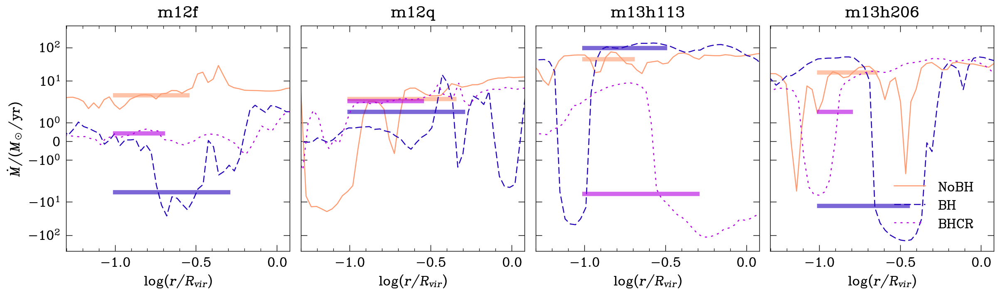

In [23]:
def makeMdotprofile(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], 
                 fname=None):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
    for i,sim in enumerate(sims):
        axes[i].set_title(sim)
        for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
            Sim = res_cf[model]
            axes[i].plot(np.log10(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir']), Sim.Mdot_profile['Mdot'], ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
            axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
            axes[i].plot((np.log10(0.1), np.log10(Sim.Rcool/Sim.pro['Rvir'])), (Sim.Mdot_avg.value, Sim.Mdot_avg.value), '-', c=COLOR_SCHEME[mi-1], lw=5, alpha=0.6)#, ls=ls, lw=2)
            print(Sim.Mdot_avg.value, np.log10(0.1), np.log10(Sim.Rcool))
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
    axes[-1].legend(loc=4)
    axes[0].set_yscale('symlog')
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))

    if fname: plt.savefig(fname)
makeMdotprofile(res_AGN, fname='../Paper2Figs/Mdotprofiles.pdf')

In [ ]:
resdict_AGN = CF_explore(res_AGN, res_AGN.keys(), usealpha=True)

m12f_NoBH 0.41863158049815097
Current Time = 01:38:32
m12f_BH 0.6378873328285481
Current Time = 01:39:54
m12f_BHCR 0.4860889261734229
Current Time = 01:40:12
m12q_NoBH 0.31838378251868
Current Time = 02:19:29
m12q_BH 0.7447350932104958
Current Time = 02:20:32
m12q_BHCR 0.46377412979222665
Current Time = 02:20:51


In [40]:
#log space
bins = np.logspace(-2,1,100)

for simname in res_AGN.keys():
    Sim = res_AGN[simname]
    altalpha = 0.25#res_cf[simname.split('_')[0]+'_NoBH'].alpha_avg
    print(simname, Sim.alpha_avg, altalpha)
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)

    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc)#, alpha=altalpha, tol=1e-3)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict_AGN[simname] = reslist

m12f_NoBH 0.41863158049815097 0.25
m12f_BH 0.6378873328285481 0.25
m12f_BHCR 0.4860889261734229 0.25
m12q_NoBH 0.31838378251868 0.25
m12q_BH 0.7447350932104958 0.25
m12q_BHCR 0.46377412979222665 0.25
m13h113_NoBH 0.06311094873728748 0.25
m13h113_BH 0.21617748956623575 0.25
m13h113_BHCR 0.12019009797064925 0.25
m13h206_NoBH 0.05494232637811671 0.25
m13h206_BH 0.1935716523524314 0.25
m13h206_BHCR 0.11171298583853974 0.25


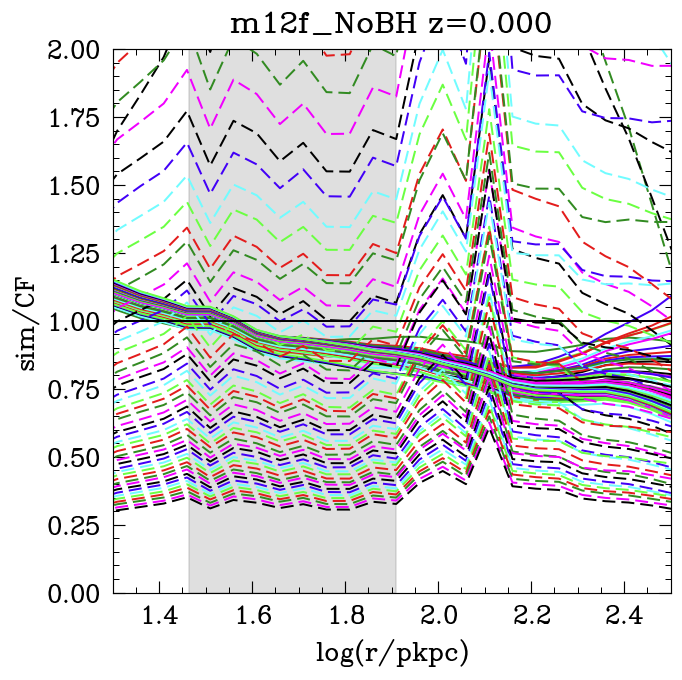

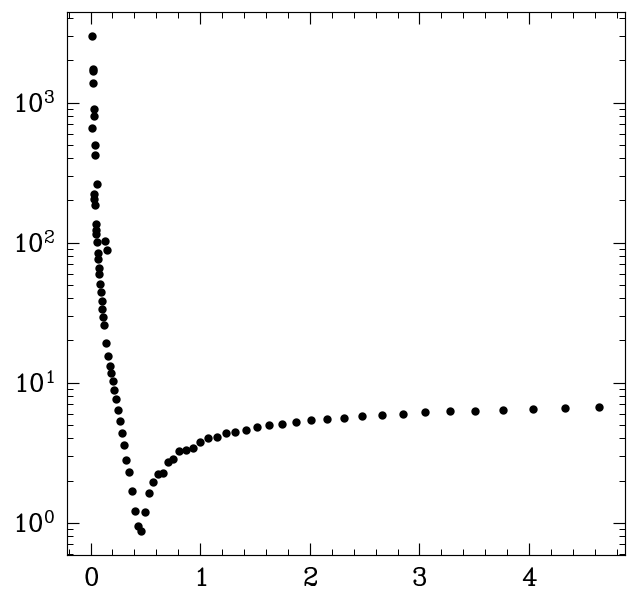

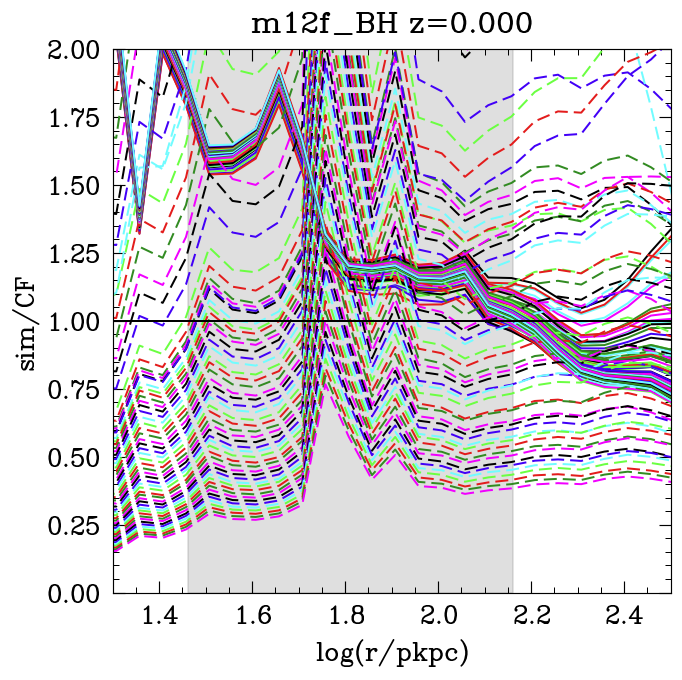

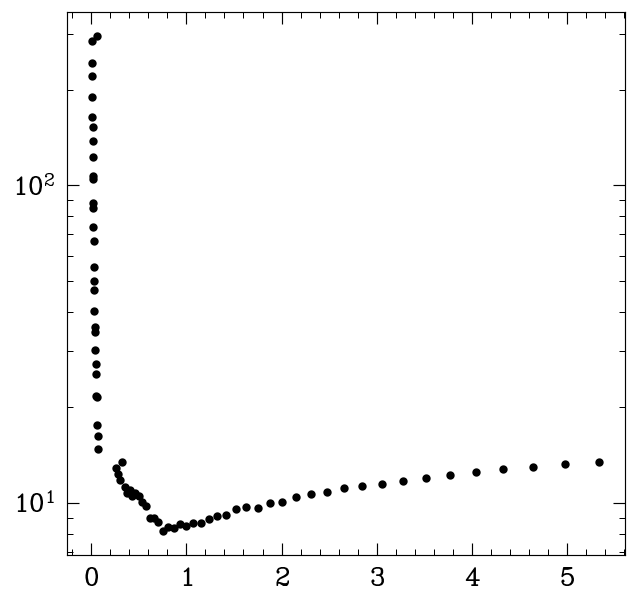

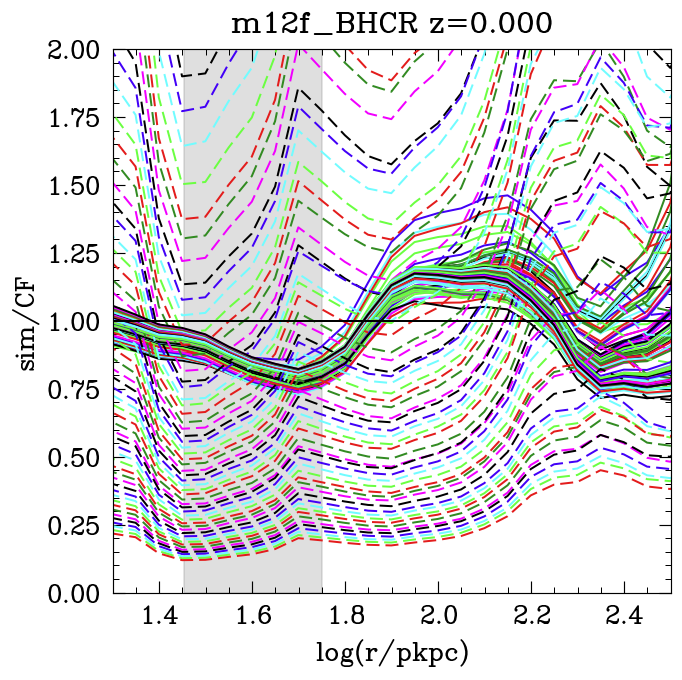

...

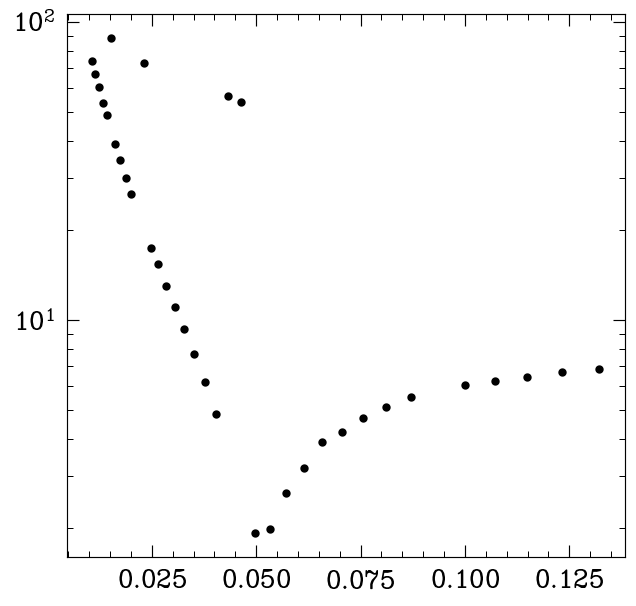

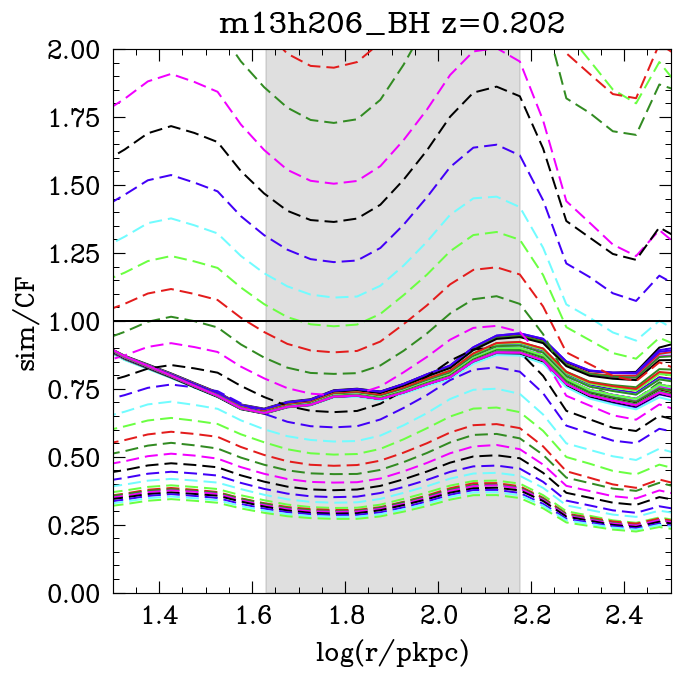

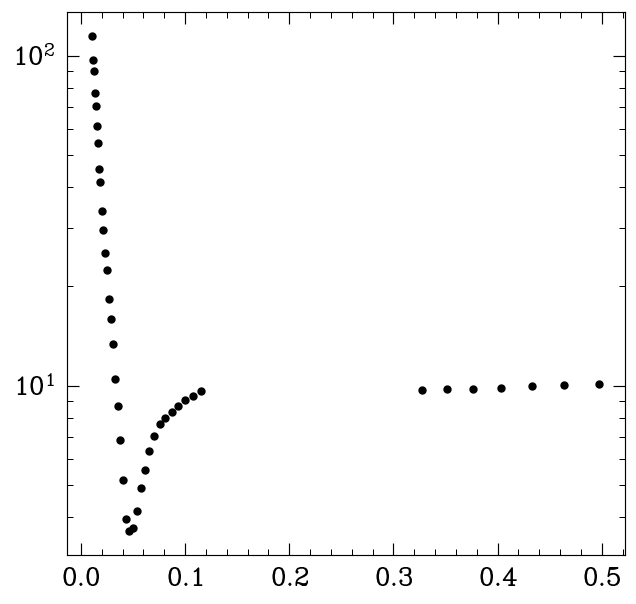

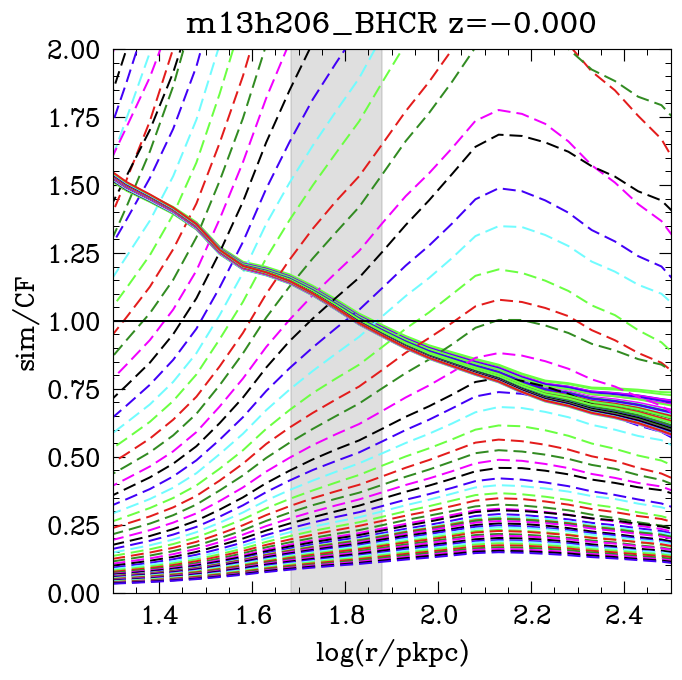

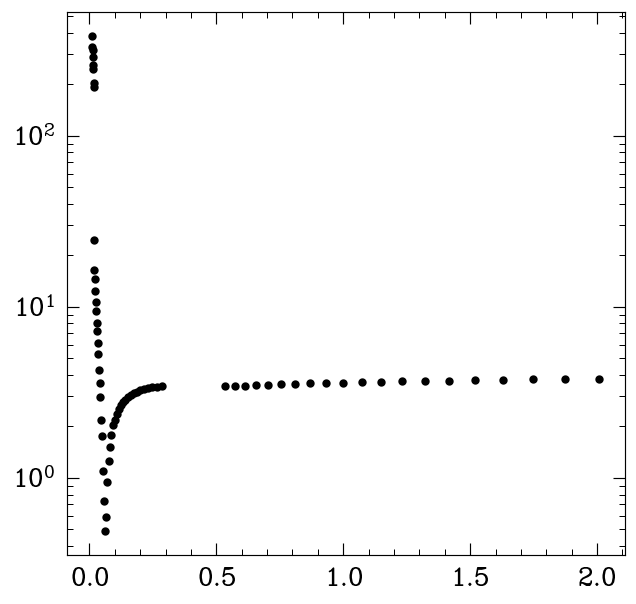

In [48]:
CF_fitting(resdict_AGN, res_AGN)

In [54]:
for k,Sim in res_AGN.items():
    print(k,Sim.transonic_solution_Rsonic)

m12f_NoBH 0.464158883361278
m12f_BH 0.7564633275546291
m12f_BHCR 0.43287612810830595
m12q_NoBH 0.533669923120631
m12q_BH 0.32745491628777285
m12q_BHCR 0.533669923120631
m13h113_NoBH 0.024770763559917114
m13h113_BH 0.11497569953977356
m13h113_BHCR 0.03511191734215131
m13h206_NoBH 0.049770235643321115
m13h206_BH 0.046415888336127795
m13h206_BHCR 0.06135907273413173


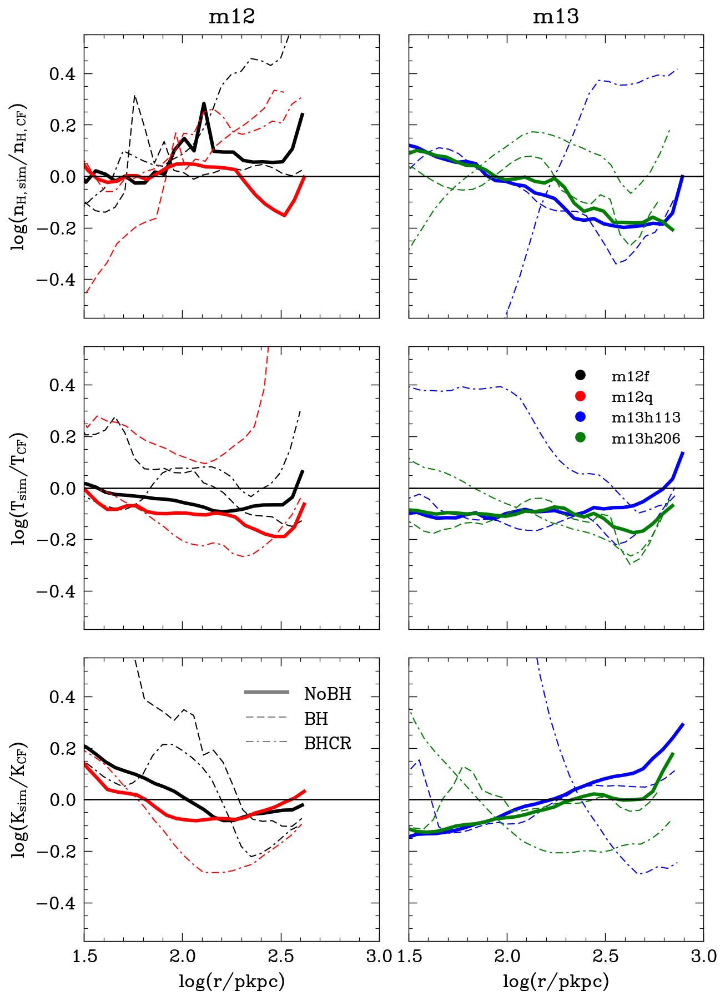

In [99]:
fig, axes = plt.subplots(3, 2, sharex=True, sharey=True, gridspec_kw={'wspace': .1, 'hspace':.1}, figsize=[4.8*2,4.8*3], dpi=150, facecolor='w')

labels = list(PaperSimNames_AGN.keys())
cs = list(np.concatenate([[c]*3 for c in ['k', 'r', 'b', 'g']]))
lws = [3, 1, 1]*4

for c,label in zip(['k', 'r', 'b', 'g'], labels[::3]): 
    axes[1,1].plot([],[],'o', c=c, label=label.split('_')[0])
axes[1,1].legend(prop={'size': 15})

for ls,lw,label in zip(['-', '--', '-.'], [3, 1, 1], labels[:3]): 
    axes[2,0].plot([],[],ls=ls, c='grey', lw=lw, label=label.split('_')[1])
axes[2,0].legend()

makecoolingflowratios([res_AGN[k] for k in labels][:6], labels=labels, lss=['-', '--', '-.']*4, cs=cs, lws=lws, axes=axes[:,0], fig=fig);
makecoolingflowratios([res_AGN[k] for k in labels][6:], labels=labels[6:], lss=(['-', '--', '-.']*4)[6:], cs=cs[6:], lws=lws[6:], axes=axes[:,1], fig=fig);
for ax in axes[:,1]: ax.set_ylabel('')
axes[0,1].get_legend().remove()
axes[0,0].set_title('m12')
axes[0,1].set_title('m13')
plt.savefig('../Paper2Figs/CFratios_fitTnH_AGN_log.pdf')

2.531682787756439
2.531682787756439
2.531682787756439
2.531682787756439
2.531682787756439
2.539382279599925
2.539382279599925
2.539382279599925
2.539382279599925
2.539382279599925
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912


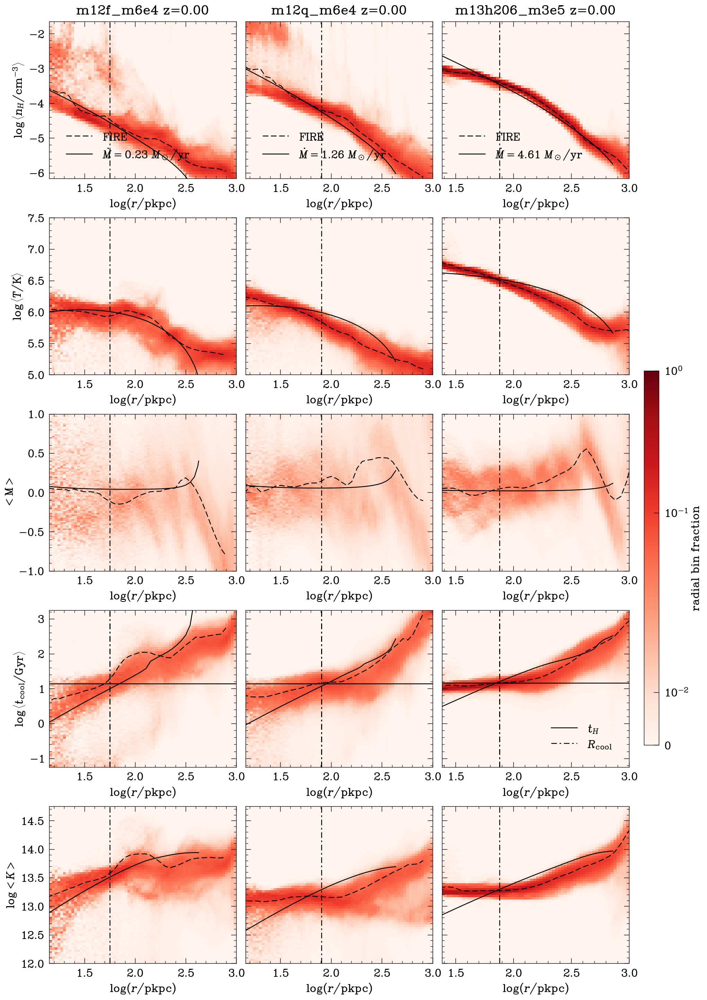

In [222]:
makecoolingflow([res_AGN['m12f_BHCR'], res_AGN['m12q_BHCR'], res_AGN['m13h206_BHCR']]);

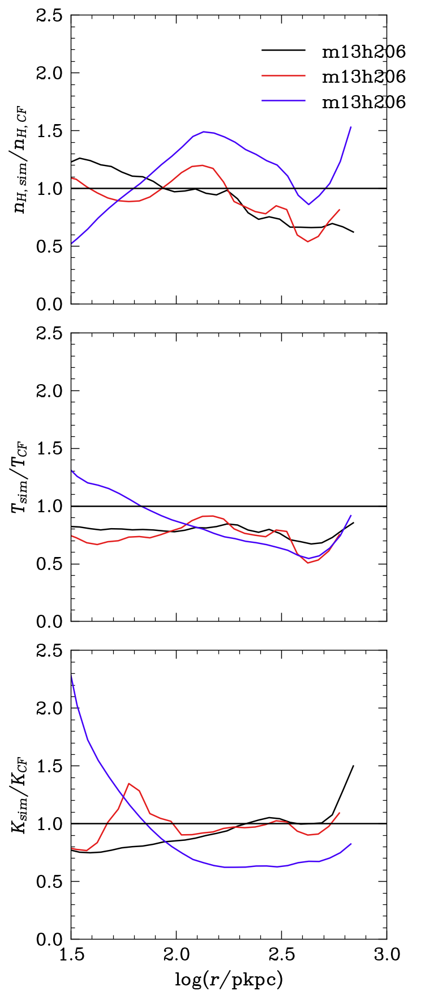

In [228]:
makecoolingflowratios([res_AGN['m13h206_NoBH'], res_AGN['m13h206_BH'], res_AGN['m13h206_BHCR']]);

2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7080847974365816
2.7080847974365816
2.7080847974365816
2.7080847974365816
2.7080847974365816
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912


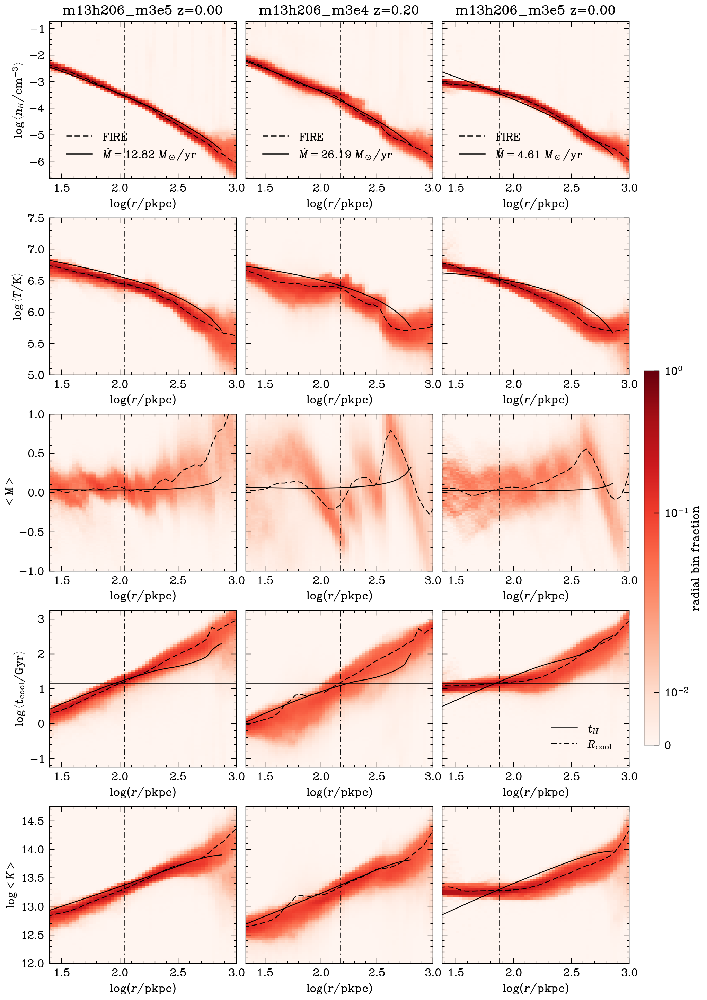

In [230]:
makecoolingflow([res_AGN['m13h206_NoBH'], res_AGN['m13h206_BH'], res_AGN['m13h206_BHCR']])
plt.savefig('../Paper2Figs/CFprofiles_fitTnH_m13h206.pdf')

In [146]:
for k,Sim in res_AGN.items(): 
    print(res_cf[k.split('_')[0]+'_NoBH'].alpha_avg)
    print( k,Sim.alpha_avg );  print(); continue
    
    
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
    plt.figure()
    Pturbratio = 10**pro['P_turb'] / 10**pro['P_th']
    plt.plot(np.log10(rmid), Pturbratio, 'k.-', label='FIRE')
    
    plt.axhline(Sim.alpha_avg)
    plt.axvline(np.log10(0.1 * Sim.pro['Rvir']))
    plt.axvline(np.log10(Sim.Rcool))

    plt.xlabel('$\log (r/\mathrm{pkpc})$')
    plt.ylabel('$P_{\mathrm{turb}} / P_{\mathrm{th}}$')

    plt.title(k + ' ' + f'z={np.abs(Sim.Redshift):.02f} {Sim.alpha_avg:.03f}')
#     plt.ylim((-0.04175976784173662, 2.1))
    plt.legend()
    
    Rmin, Rmax = 0.1 * Sim.pro['Rvir'], Sim.Rcool
    print(Pturbratio[(Rmin < rmid) & (rmid < Rmax)])
    print(Rmin, Rmax)
    print()

0.41863158049815097
m12f_BH nan

0.41863158049815097
m12f_BHCR 0.4860889261734229

0.31838378251868
m12q_BH nan

0.31838378251868
m12q_BHCR 0.46377412979222665

0.06311094873728748
m13h113_BH 0.21617748956623575

0.06311094873728748
m13h113_BHCR nan

0.05494232637811671
m13h206_BH 0.1935716523524314

0.05494232637811671
m13h206_BHCR 0.11171298583853974

